# Import

In [532]:
import os
import re
import collections
import time
import numpy as np
import pandas as pd
import torch
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import cv2
from wordcloud import WordCloud
from num2words import num2words
from yellowbrick.cluster import KElbowVisualizer

from sklearn import cluster, metrics, manifold, decomposition
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn import cluster, metrics

import gensim

from transformers import TFAutoModel, AutoTokenizer, DetrFeatureExtractor

from tensorflow.keras import Input, backend as K
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import Embedding, GlobalAveragePooling1D
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16
from keras.applications.resnet import ResNet50
from tensorflow.keras.applications import EfficientNetB0

In [533]:
tqdm.pandas()

In [485]:
from helpers import CleaningText
from pca import display_circles, display_scree_plot

In [3]:
# https://www.analyticsvidhya.com/blog/2020/08/top-4-sentence-embedding-techniques-using-python/

# Load Data

In [4]:
path = '/Users/maximedupouy/code/OC_code/oc_code/livrable_6/Flipkart/'
text_file_name = 'flipkart_com-ecommerce_sample_1050.csv'
path_img = path+'Images/'

In [5]:
data_text = pd.read_csv(path+text_file_name)
data_text.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [6]:
data_text.drop(columns=['crawl_timestamp', 'product_url', 'pid'], inplace=True)

In [7]:
data_text.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   product_name             1050 non-null   object 
 2   product_category_tree    1050 non-null   object 
 3   retail_price             1049 non-null   float64
 4   discounted_price         1049 non-null   float64
 5   image                    1050 non-null   object 
 6   is_FK_Advantage_product  1050 non-null   bool   
 7   description              1050 non-null   object 
 8   product_rating           1050 non-null   object 
 9   overall_rating           1050 non-null   object 
 10  brand                    712 non-null    object 
 11  product_specifications   1049 non-null   object 
dtypes: bool(1), float64(2), object(9)
memory usage: 91.4+ KB


In [8]:
data_img = pd.DataFrame({'unique_id' : [], 'img' : []})
a = []
b=[]
for file_name in os.listdir(path_img):
    a.append(file_name.split('.')[0])
    b.append(np.array(Image.open(path_img + file_name)))
data_img['unique_id'] = a
data_img['img'] = b

/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/PIL/Image.py:3035: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [9]:
data_img.head(2)

,unique_id,img
0,aa68675f50a0551b8dadb954017a50a1,"[[[193, 197, 200], [193, 197, 200], [192, 196,..."
1,037c2402fee39fbc80433935711d1383,"[[[255, 255, 255], [255, 255, 255], [255, 255,..."


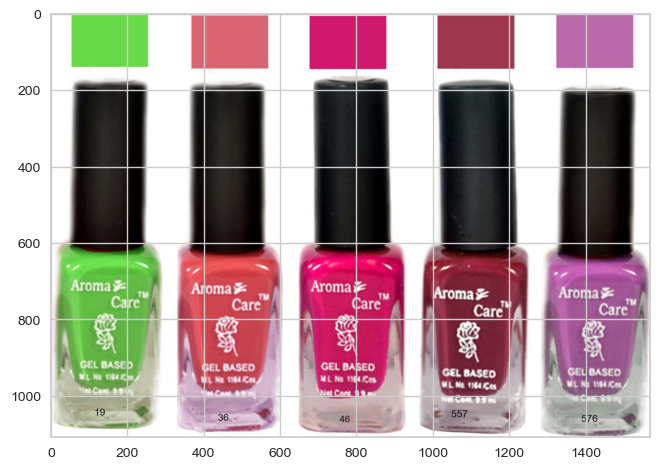

In [10]:
to_show = np.random.choice(list(data_img.unique_id))
plt.imshow(data_img[data_img.unique_id==to_show]['img'].item())

# TEXT 

In [11]:
data_text.isnull().sum()

uniq_id                      0
product_name                 0
product_category_tree        0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [12]:
data_text['uniq_id'].nunique() == len(data_text)

True

In [13]:
for col in data_text.columns:
    print(col, '---->', data_text[col].duplicated().sum())

uniq_id ----> 0
product_name ----> 0
product_category_tree ----> 408
retail_price ----> 695
discounted_price ----> 625
image ----> 0
is_FK_Advantage_product ----> 1048
description ----> 0
product_rating ----> 1023
overall_rating ----> 1023
brand ----> 559
product_specifications ----> 65


## Categories

In [14]:
display(data_text['product_category_tree'][0])

'["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]'

In [15]:
data_text['product_category_tree'] = data_text['product_category_tree'].apply(eval)

In [16]:
# testing if there is one tree for one product
data_text['product_category_tree_len'] = data_text['product_category_tree'].apply(len)
print(data_text['product_category_tree_len'].value_counts())
data_text.drop(columns=['product_category_tree_len'], inplace=True)

1    1050
Name: product_category_tree_len, dtype: int64


In [17]:
data_text['product_category_tree'] = data_text[
    'product_category_tree'].apply(lambda x : [i.split('>>') for i in x][0])

In [18]:
data_text['product_category_len'] = data_text['product_category_tree'].apply(len)
data_text['product_category_len'].value_counts()

3    368
5    278
4    274
6     70
7     57
2      3
Name: product_category_len, dtype: int64

In [19]:
data_text['product_category_tree'] = data_text['product_category_tree'].apply(lambda x : [i.strip() for i in x])
data_text['product_category'] = data_text['product_category_tree'].apply(lambda x : x[0])
data_text['product_category'].value_counts()

Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: product_category, dtype: int64

## Text Preprocessing

In [20]:
# addition description with product name
data_text['description'] = data_text['product_name'] + data_text['description']

In [21]:
data_text['description'].sample().values

array(['Rockmantra Colorful Ceramic MugRockmantra Colorful Ceramic Mug (5.5 l)\r\n                         Price: Rs. 199\r\n\t\t\t\t\r\n\t\t\tGive a thrilling yet fresh start to your day. An exclusive creation by Rockmantra, this mug features porcelain crafting ensuring the design stays permanent for years to come and making it a perfect pick to gift your loved ones too!Dishwasher and microwave safe. Product details and specifications :\rMaterial : Ceramic\rSize : 3.5" X 4"\r\nGive a thrilling yet fresh start to your day. An exclusive creation by Rockmantra, this mug features porcelain crafting ensuring the design stays permanent for years to come and making it a perfect pick to gift your loved ones too!Dishwasher and microwave safe. Product details and specifications :\rMaterial : Ceramic\rSize : 3.5" X 4"'],
      dtype=object)

In [22]:
# num2words


units = {
    'g' : 'gram',
    'cm' : 'centimeter',
    'mm' : 'millimeter',
    'rs' : 'roupies',
    'ml' : 'milliliter',
    'l' : 'liter'
    }

words_to_remove = ["key", "features", "buy",
                   "specifications", "com",
                   'price', 'roupies', 'cash',
                   'best', 'products', 'free',
                  'flipkart', 'guarantee', 'shipping', 'delivery', 'replacement', 'genuine']

def replace_units(row:str) -> str:
    row_cleaned = []
    for word in row.split() :
        if word in units.keys():
            row_cleaned.append(units[word])
        else :
            row_cleaned.append(word)
    return ' '.join(row_cleaned)

def remove_noices(row:str) -> str:
    return ' '.join(word for word in row.split() if word.lower() not in words_to_remove and len(word)>2)

def remove_rare_words(row:str) -> str:
    return ' '.join(word for word in row.split() if word not in rare_words)
        

def preprocess_ml(row) :
    row = CleaningText.remove_upper_case(row)
    row = CleaningText.remove_punctuation(row)
    row = CleaningText.remove_encode_char(row)
    row = CleaningText.remove_number(row)
    row = replace_units(row)
    row = remove_noices(row)
    row = CleaningText.remove_stop_words(row)
    row = CleaningText.lemmatizing(row)
    return ' '.join(row)

def preprocess_w2v(row) :
    row = CleaningText.remove_upper_case(row)
    row = CleaningText.remove_punctuation(row)
    row = CleaningText.remove_encode_char(row)
    row = CleaningText.remove_number(row)
    row = replace_units(row)
    return row

def preprocess_deep(row) :
    row = CleaningText.remove_upper_case(row)
    row = CleaningText.remove_punctuation(row)
    row = CleaningText.remove_encode_char(row)
    row = CleaningText.remove_number(row)
    row = replace_units(row)
    return row

In [23]:
data_text['description_ml'] = data_text['description'].apply(lambda x : preprocess_ml(x))

In [24]:
data_text['description_ml'].head()

0    elegance polyester multicolor abstract eyelet ...
1    sathiyas cotton bath towelspecifications sathi...
2    eurospa cotton terry face towel setkey eurospa...
3    santosh royal fashion cotton printed king size...
4    jaipur print cotton floral king sized double b...
Name: description_ml, dtype: object

In [25]:
data_text['description_deep'] = data_text['description'].apply(lambda x : preprocess_deep(x))

In [26]:
data_text['description_deep'].head()

0    elegance polyester multicolor abstract eyelet ...
1    sathiyas cotton bath towelspecifications of sa...
2    eurospa cotton terry face towel setkey feature...
3    santosh royal fashion cotton printed king size...
4    jaipur print cotton floral king sized double b...
Name: description_deep, dtype: object

In [27]:
encode_fast = {'Home Furnishing':1,
               'Baby Care':2,
               'Watches':3,
               'Home Decor & Festive Needs':4,
               'Kitchen & Dining':5,
               'Beauty and Personal Care':6,
               'Computers':7}
data_text['encode_cat'] = data_text['product_category'].map(encode_fast)

## Text data explo

In [28]:
all_text = ' '.join([i for i in data_text['description_ml']])
count_words = collections.Counter(all_text.split())

In [29]:
most_30_words = sorted(count_words.items(), key=lambda x:x[1], reverse=True)[:30]

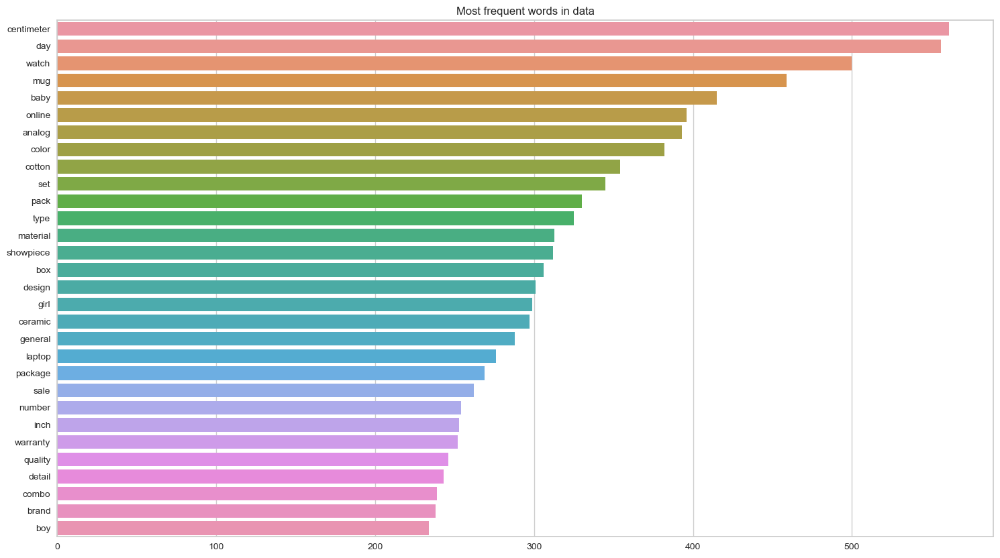

In [30]:
plt.figure(figsize=(18,10))
sns.barplot(y=[i[0] for i in most_30_words], x=[i[1] for i in most_30_words], orient='h')
plt.title('Most frequent words in data');

In [31]:
# mots les plus courants par category
categories = list(data_text['product_category'].unique())
count_word_by_cat = {}
for cat in categories:
    count_word_by_cat[cat] = {}
for ind, row in data_text.iterrows():
    cat = row['product_category']
    description = row['description_ml']
    for word in description.split():
        if word not in count_word_by_cat[cat].keys() :
            count_word_by_cat[cat][word]=1
        else:
            count_word_by_cat[cat][word]+=1

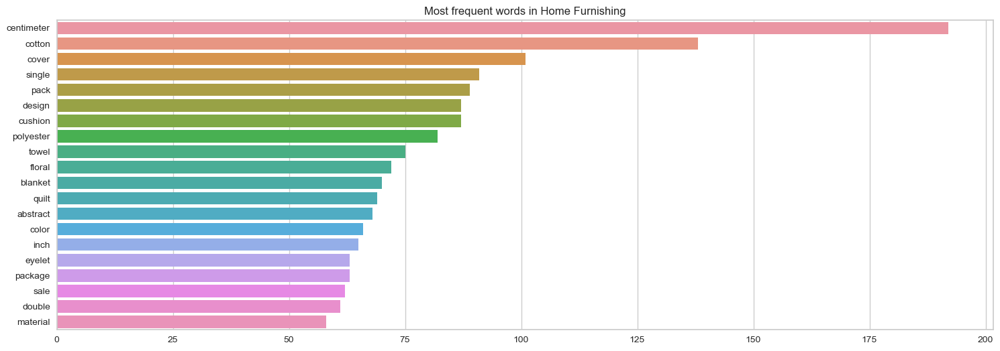

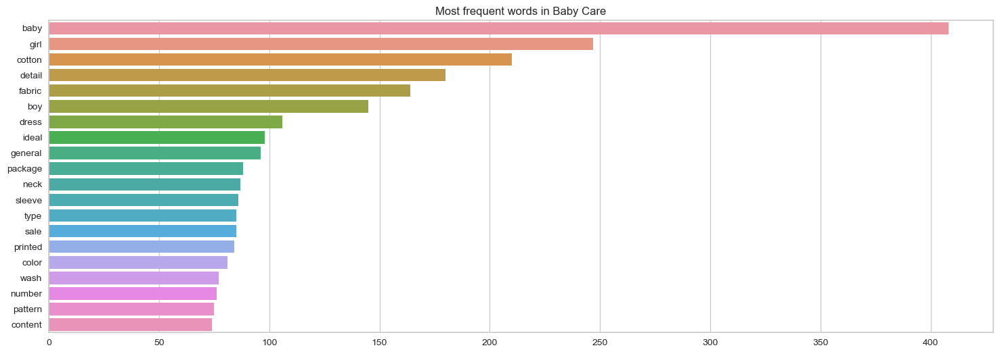

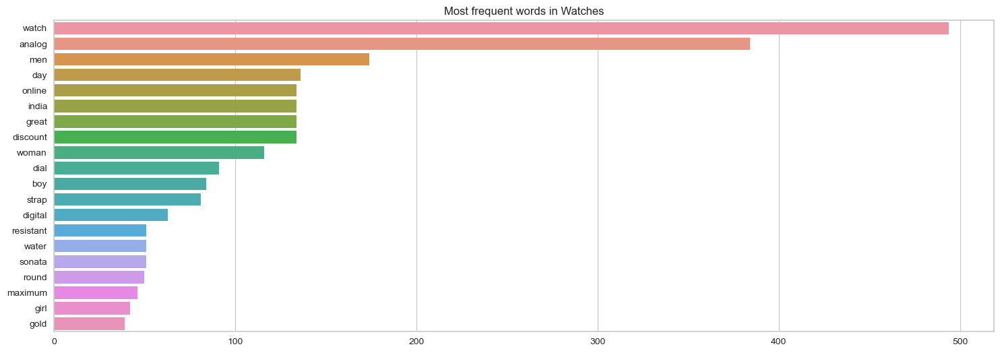

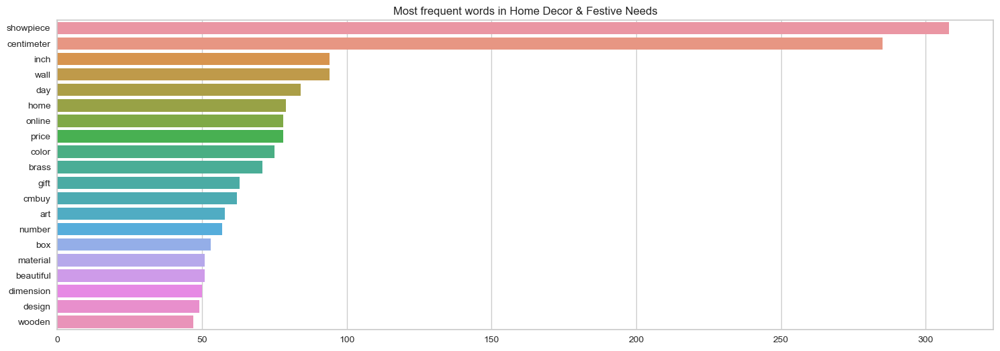

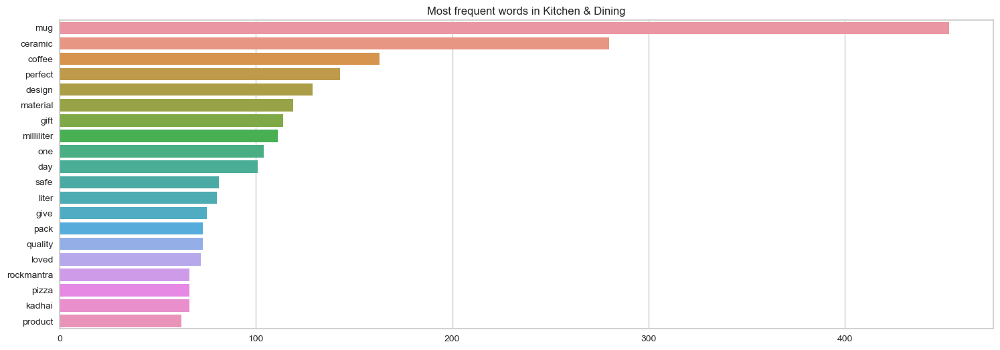

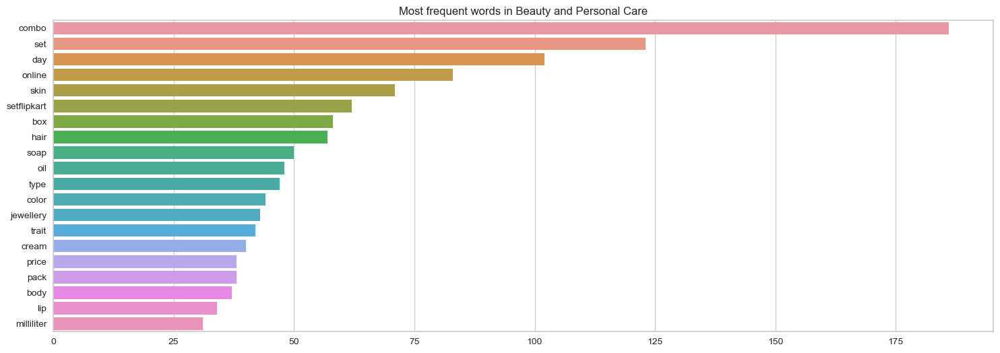

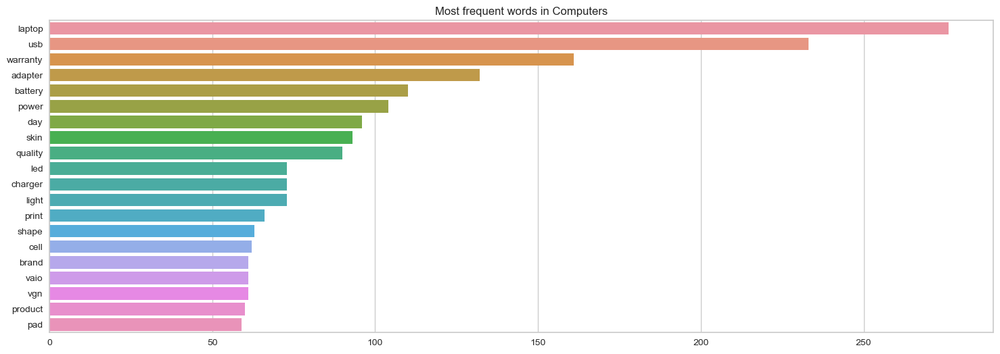

In [32]:
for cat in categories :
    most_20_words = sorted(count_word_by_cat[cat].items(), key=lambda x:x[1], reverse=True)[:20]
    plt.figure(figsize=(18,6))
    sns.barplot(y=[i[0] for i in most_20_words], x=[i[1] for i in most_20_words], orient='h')
    plt.title(f'Most frequent words in {cat}');
    plt.show();

In [33]:
def create_wordcloud(data, data_selection):
    wordcloud = WordCloud(width=600, height=500, background_color='white').generate(' '.join(data))
    WordCloud.generate_from_frequencies


    fig, ax1 = plt.subplots(1,1, figsize=(15,8))

    fig.suptitle(f'Mots les plus fréquents dans {data_selection}', weight='bold', fontsize=20)
    # Display image, `aspect='auto'` makes it fill the whole `axes` (ax3)
    im1 = ax1.imshow(wordcloud, aspect='auto')

    plt.show()

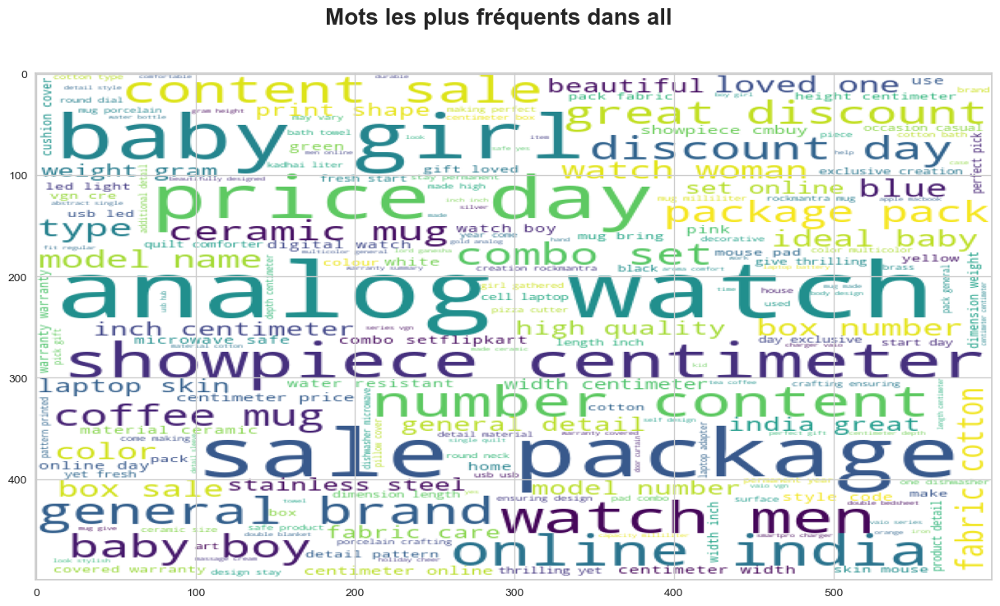

In [34]:
create_wordcloud(data_text['description_ml'], 'all')

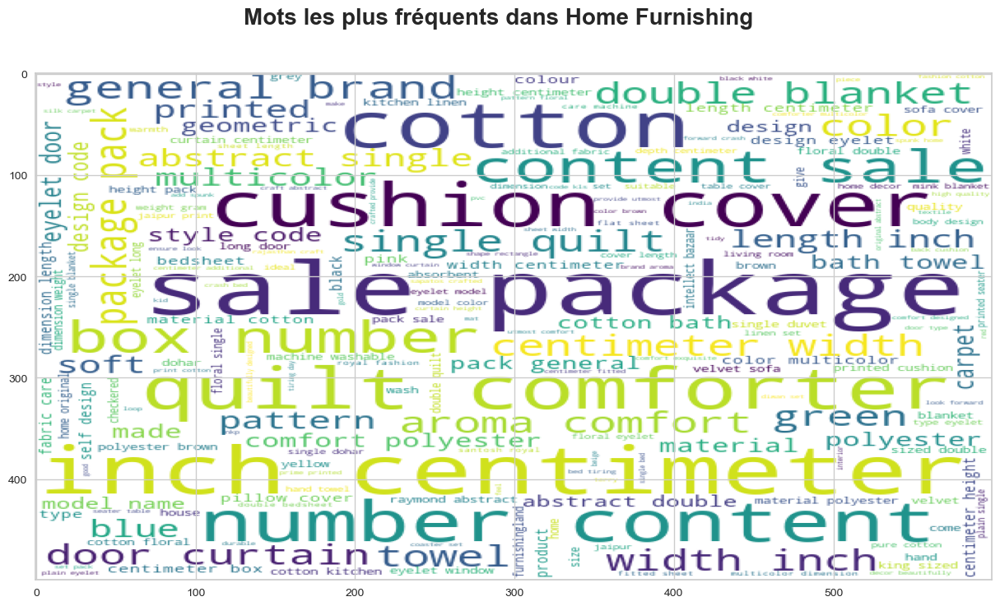

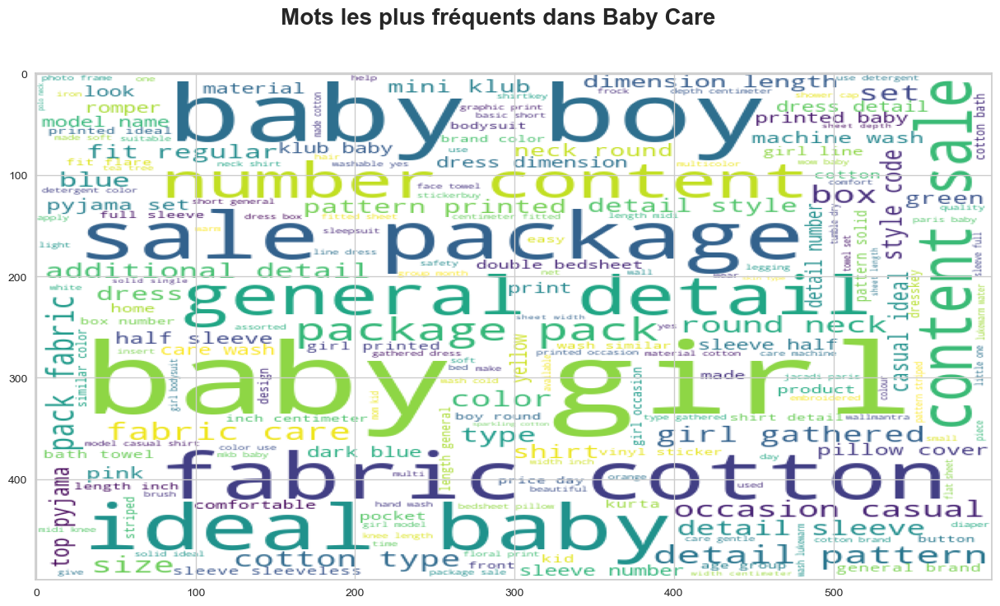

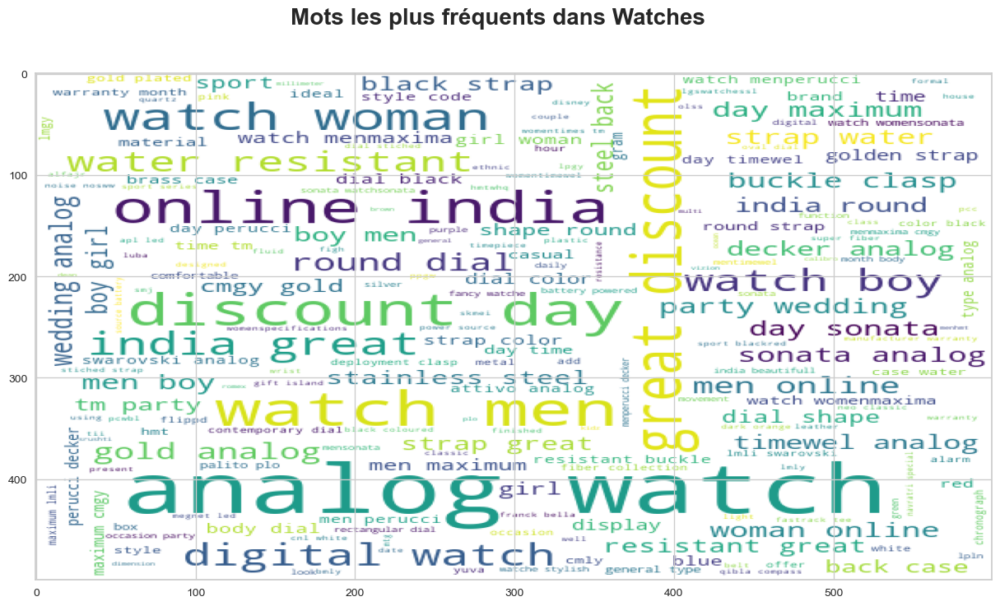

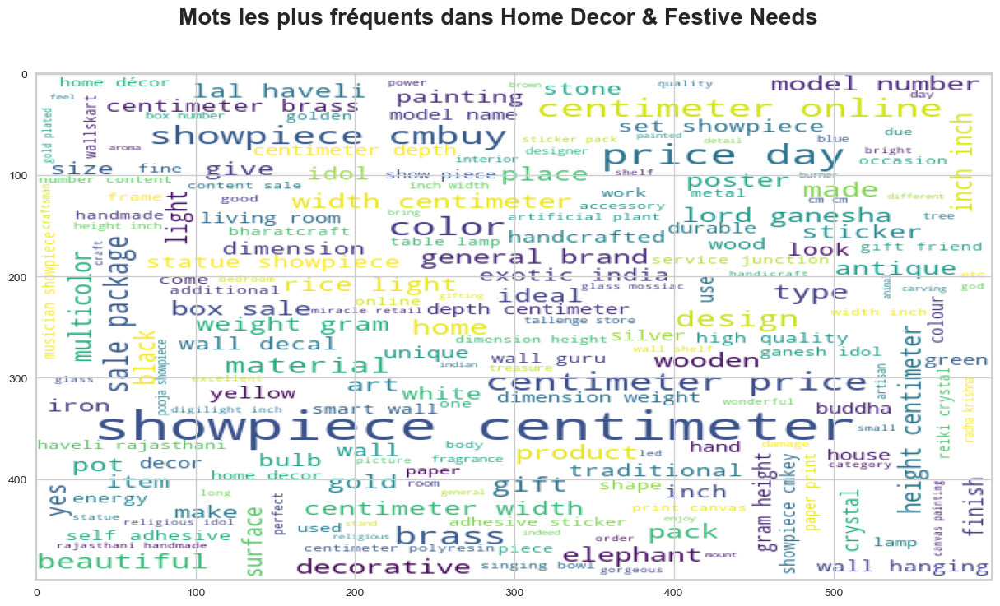

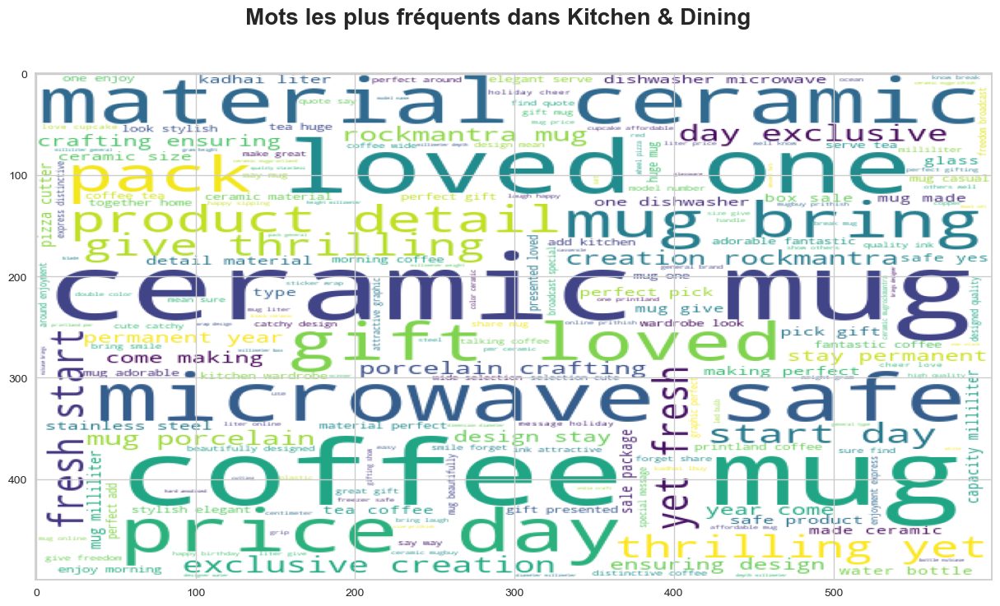

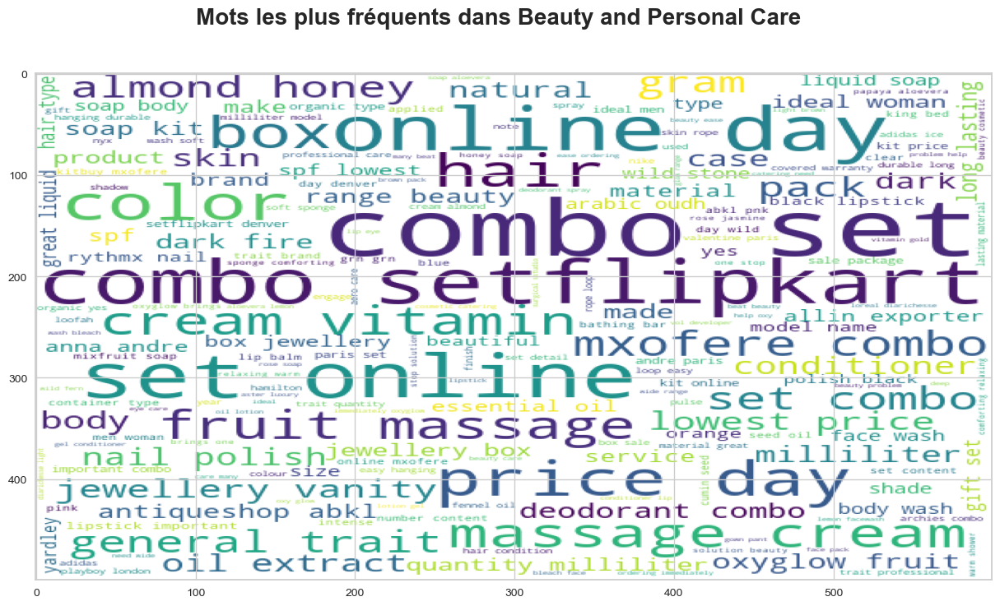

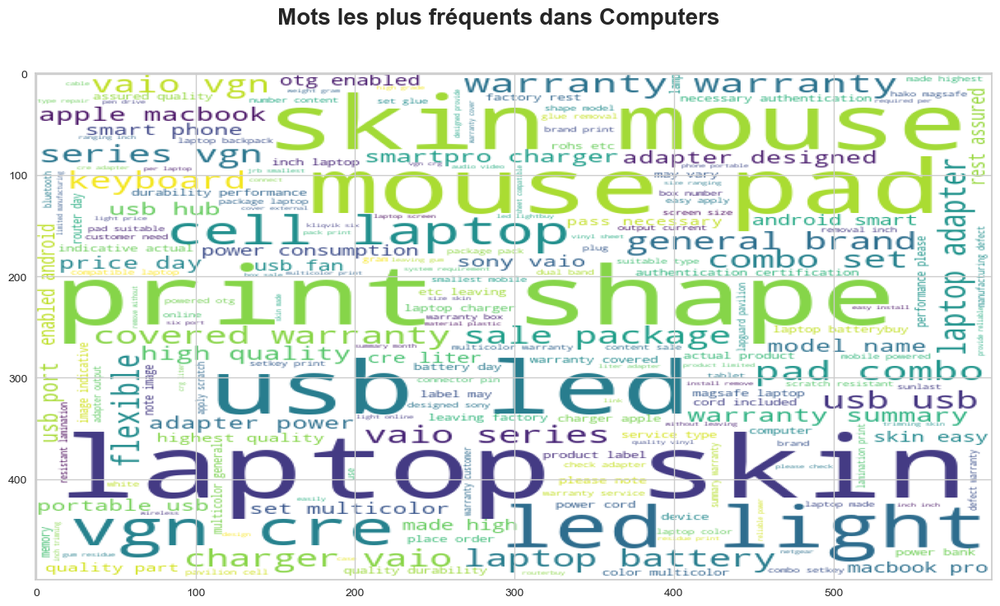

In [35]:
for cat in categories :
    data = data_text[data_text['product_category']==cat]
    create_wordcloud(data['description_ml'], cat)

/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='description_ml'>

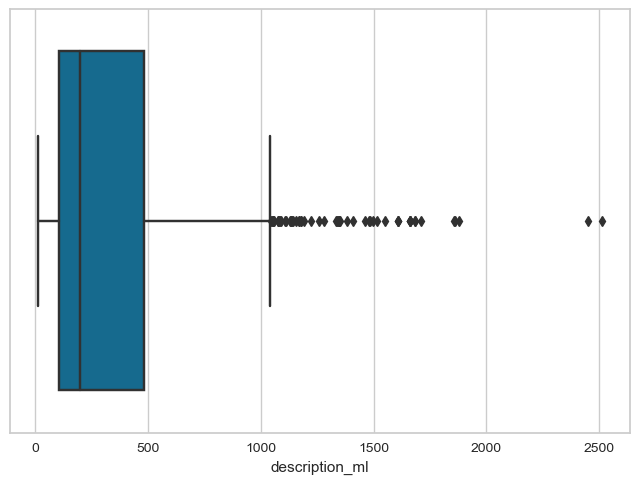

In [36]:
# distribution taille description totale
sns.boxplot(data_text.description_ml.str.len())

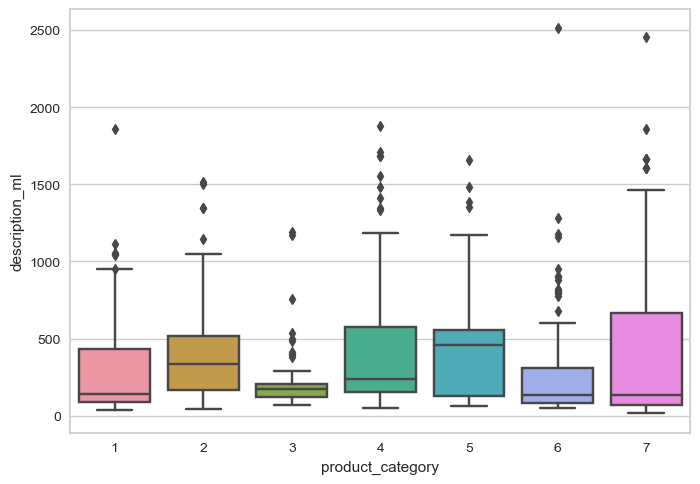

In [37]:
encoding_fast = {
    'Home Furnishing': 1,
    'Baby Care': 2,
    'Watches': 3,
    'Home Decor & Festive Needs': 4,
    'Kitchen & Dining':5,
    'Beauty and Personal Care':6,
    'Computers':7
}

x = data_text.product_category.map(encoding_fast)
sns.boxplot(x=x, y=data_text.description_ml.str.len(),  orient='v')
plt.show()

<AxesSubplot:xlabel='brand', ylabel='index'>

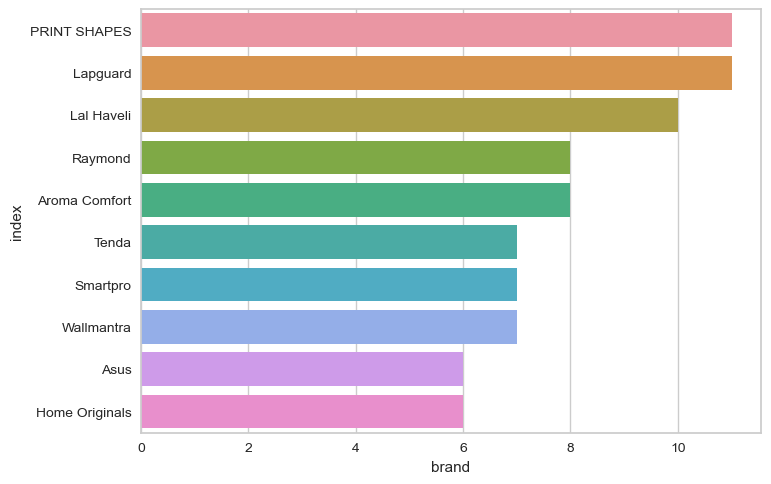

In [38]:
top_10_brands = pd.DataFrame(data_text['brand'].value_counts()[:10]).reset_index()
sns.barplot(y=top_10_brands['index'], x=top_10_brands['brand'], orient='h')

In [39]:
corpus = []
for description in list(data_text['description_ml']):
    for word in description.split():
        corpus.append(word)

In [40]:
print('nombre de mots', len(corpus))
print('nombre de mots uniques', len(set(corpus)))

nombre de mots 52964
nombre de mots uniques 4969


In [41]:
tmp = pd.Series(corpus).value_counts()

In [42]:
tmp.describe()

count    4969.000000
mean       10.658885
std        32.767722
min         1.000000
25%         1.000000
50%         3.000000
75%         6.000000
max       561.000000
dtype: float64

In [43]:
tmp

centimeter    561
day           556
watch         500
mug           459
baby          415
             ... 
isaac           1
carbon          1
resonable       1
brnaded         1
fall            1
Length: 4969, dtype: int64

In [44]:
rare_words = tmp[tmp==1]
rare_words = pd.DataFrame(rare_words)
print(len(rare_words))
display(rare_words.head())

1372


,0
mousepadkey,1
hgfvsimstmrn,1
lilac,1
sunrise,1
vas,1


In [45]:
# remove rare words
data_text['description_ml'] = data_text['description_ml'].apply(lambda x : remove_rare_words(x))

In [46]:
data_text['description_ml']

0       elegance polyester multicolor abstract eyelet ...
1       sathiyas cotton bath towelspecifications sathi...
2       eurospa cotton terry face towel setkey eurospa...
3       santosh royal fashion cotton printed king size...
4       jaipur print cotton floral king sized double b...
                              ...                        
1045    oren empower extra large self adhesive sticker...
1046    wallmantra large vinyl sticker stickerwallmant...
1047    uberlyfe extra large pigmented polyvinyl film ...
1048    wallmantra medium vinyl sticker stickerbuy wal...
1049    uberlyfe large vinyl stickerbuy uberlyfe large...
Name: description_ml, Length: 1050, dtype: object

## Adding some home made ideas

### Price

<AxesSubplot:ylabel='retail_price'>

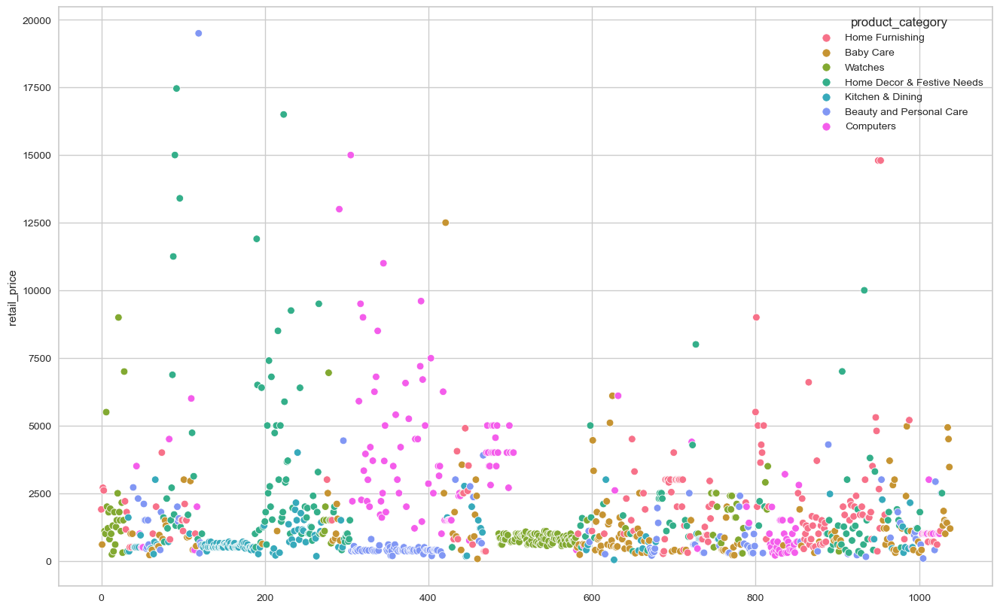

In [47]:
price_data_ = data_text[['retail_price', 'product_category', 'encode_cat']]
price_data_ = price_data_[price_data_.retail_price < 20000]
price_data = price_data_[['retail_price', 'product_category']]
#price_data = price_data.sort_values(by='retail_price')

plt.figure(figsize=(16, 10))
sns.scatterplot(x=[i for i in range(len(price_data))],
                y=price_data['retail_price'],
                hue=price_data['product_category'])

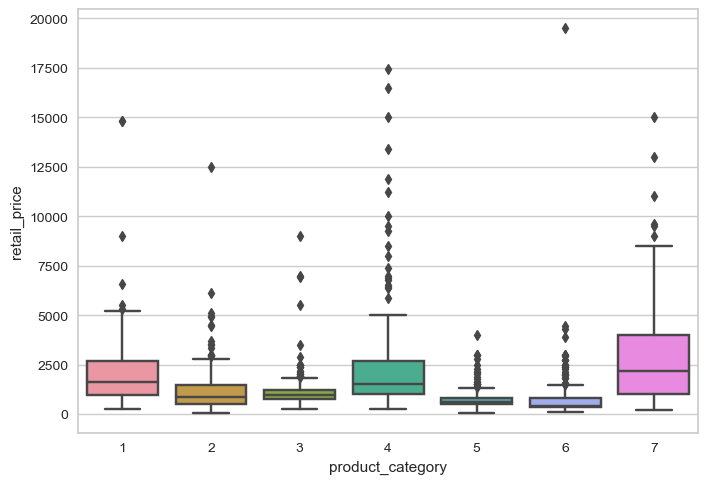

In [48]:
x = data_text.product_category.map(encoding_fast)
sns.boxplot(x=x, y=price_data_.retail_price,  orient='v')
plt.show()

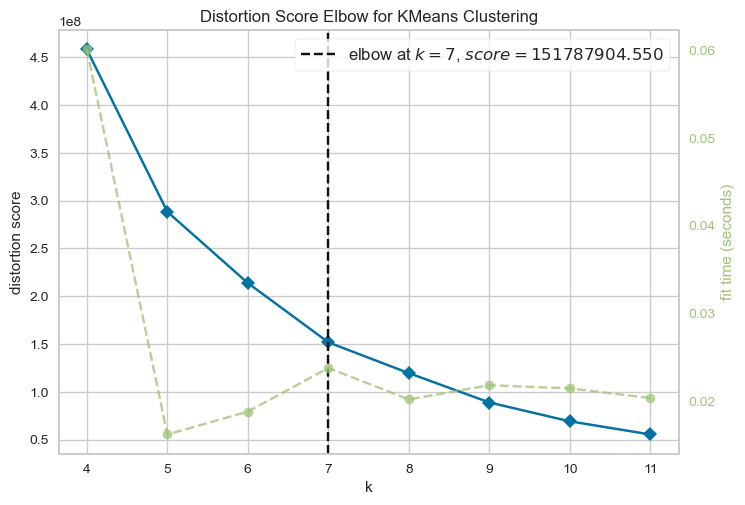

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [49]:

model = KMeans()
visualizer = KElbowVisualizer(model, k=(4, 12))

visualizer.fit(price_data[['retail_price']]) # Fit the data to the visualizer
visualizer.poof()


In [50]:
data_text['retail_price']

0       1899.0
1        600.0
2          NaN
3       2699.0
4       2599.0
         ...  
1045    1399.0
1046    4930.0
1047    4500.0
1048    3465.0
1049    1190.0
Name: retail_price, Length: 1050, dtype: float64

In [51]:
quantile = 7
data_text['retail_price'] = data_text['retail_price'].fillna(data_text['retail_price'].median())
data_text['discounted_price'] = data_text['discounted_price'].fillna(value=data_text['discounted_price'].median())
price_discretization = pd.qcut(data_text['retail_price'], q=quantile, labels=[i for i in range(1, quantile+1)])
price_discretization.value_counts()

2    159
1    155
5    155
4    150
6    147
7    147
3    137
Name: retail_price, dtype: int64

In [52]:
data_text['price_discretized'] = price_discretization
data_text['price_discretized'] = data_text['price_discretized'].astype(int)

In [53]:
data_text['encode_cat'].isnull().sum()

0

In [54]:
metrics.adjusted_rand_score(data_text['encode_cat'], data_text['price_discretized'])

0.08286831275623799

In [55]:
confusion_matrix(data_text['encode_cat'], data_text['price_discretized'])

array([[ 8, 10, 18, 18, 31, 42, 23],
       [27, 24, 20, 28, 23, 17, 11],
       [ 5, 14, 39, 50, 16, 18,  8],
       [10,  8, 11, 20, 42, 24, 35],
       [16, 64, 32, 10, 18,  9,  1],
       [74, 28, 10,  8,  8, 14,  8],
       [15, 11,  7, 16, 17, 23, 61]])

<AxesSubplot:>

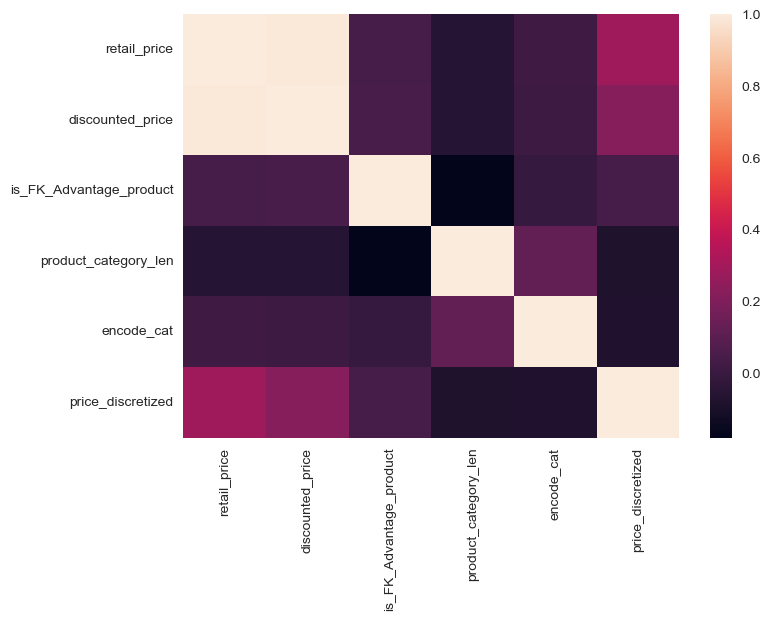

In [56]:
sns.heatmap(data_text.corr())

<AxesSubplot:xlabel='count', ylabel='product_category'>

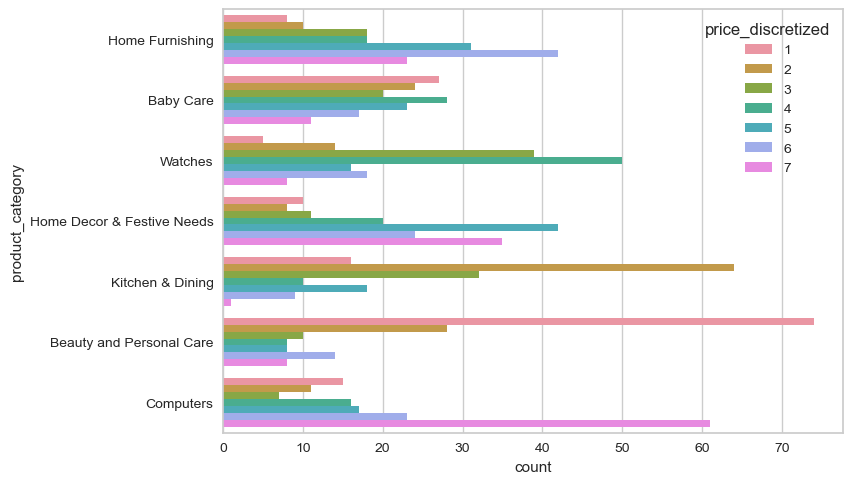

In [57]:
sns.countplot(y="product_category", hue="price_discretized", data=data_text)

### Discount

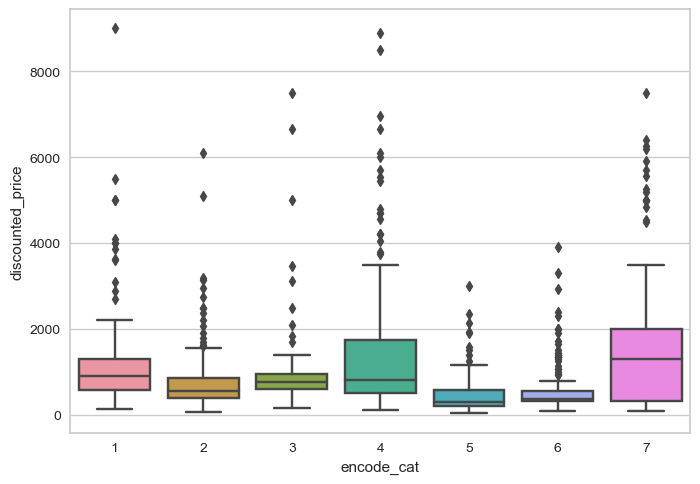

In [58]:
discount = data_text[data_text['retail_price']<10_000]
sns.boxplot(x=discount['encode_cat'], y=discount['discounted_price'],  orient='v')
plt.show()

In [59]:
data_text['discount'] = (data_text['retail_price'] - data_text['discounted_price']) / data_text['retail_price']

In [60]:
quantile = 5
discount_discretization = pd.qcut(data_text['discount'], q=quantile, labels=[i for i in range(1, quantile+1)])
discount_discretization.value_counts()

4    213
1    210
2    210
3    210
5    207
Name: discount, dtype: int64

In [61]:
data_text['discount_discretization'] = discount_discretization
data_text['discount_discretization'] = data_text['discount_discretization'].astype(int)

<AxesSubplot:xlabel='count', ylabel='product_category'>

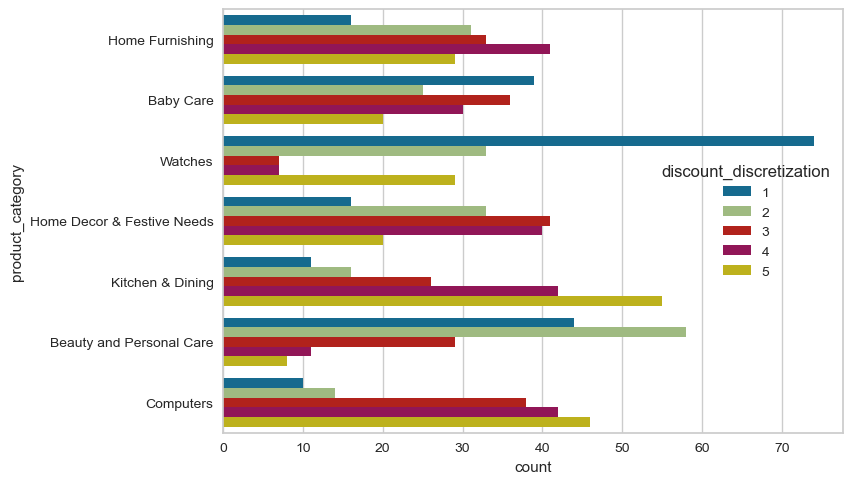

In [62]:
sns.countplot(y="product_category", hue="discount_discretization", data=data_text, )
#ylabels = 

### Add description

In [63]:
def format_json_maker(row):
    if type(row) != float :
        pattern = r'=>'
        row =re.sub(pattern, ':', row)
        try :
            row = eval(row)
        except :
            row = None
        return row

data_text['product_specifications'] = data_text['product_specifications'].apply(lambda x : format_json_maker(x))

In [64]:
data_text['product_specifications']

0       {'product_specification': [{'key': 'Brand', 'v...
1       {'product_specification': [{'key': 'Machine Wa...
2       {'product_specification': [{'key': 'Material',...
3       {'product_specification': [{'key': 'Brand', 'v...
4       {'product_specification': [{'key': 'Machine Wa...
                              ...                        
1045    {'product_specification': [{'key': 'Number of ...
1046    {'product_specification': [{'key': 'Number of ...
1047    {'product_specification': [{'key': 'Number of ...
1048    {'product_specification': [{'key': 'Number of ...
1049    {'product_specification': [{'key': 'Sales Pack...
Name: product_specifications, Length: 1050, dtype: object

In [65]:
o = np.random.choice([i for i in range(len(data_text))])
print(o)
for elem in data_text.loc[o, 'product_specifications']['product_specification']:
    print(elem.get('key'),'--->', elem.get('value'))

849
Brand ---> QP360
Type ---> USB Fan
System Requirements ---> USB Port
Material ---> Plasti
Model Name ---> Kid Fan 01
Model ID ---> MLY2015
Color ---> Yellow
Sales Package ---> Mini Fan, USB Cable


In [66]:
def add_specification_to_description(row):
    text_to_add = []
    if row :
        if type(row['product_specification'])==list:
            for elem in row['product_specification']:
                text_to_add.append(elem.get('key', ''))
                text_to_add.append(elem.get('value', ''))
            return ' '.join(text_to_add)

In [67]:
data_text['specification_str']=data_text['product_specifications'].apply(lambda x : add_specification_to_description(x))

### adding new data text

In [68]:
data_text['price_discretized_word'] = data_text['price_discretized'].apply(lambda x : num2words(x))
data_text['discount_discretization_word'] = data_text['discount_discretization'].apply(lambda x : num2words(x))

In [69]:
data_text['discount_discretization'] = data_text['discount_discretization'].astype('str')
data_text['price_discretized'] = data_text['price_discretized'].astype('str')

In [70]:
data_text['specification_str']=data_text['specification_str'].fillna(value='')

In [71]:
data_text['description_full'] = data_text['description'] + data_text['specification_str'] 

In [72]:
data_text['description_full'] = data_text['description_full'].apply(lambda x : preprocess_ml(x))

In [73]:
data_text['description_full']

0       elegance polyester multicolor abstract eyelet ...
1       sathiyas cotton bath towelspecifications sathi...
2       eurospa cotton terry face towel setkey eurospa...
3       santosh royal fashion cotton printed king size...
4       jaipur print cotton floral king sized double b...
                              ...                        
1045    oren empower extra large self adhesive sticker...
1046    wallmantra large vinyl sticker stickerwallmant...
1047    uberlyfe extra large pigmented polyvinyl film ...
1048    wallmantra medium vinyl sticker stickerbuy wal...
1049    uberlyfe large vinyl stickerbuy uberlyfe large...
Name: description_full, Length: 1050, dtype: object

In [74]:
#data_text['price_discretized'] + data_text['discount_discretization'] + 

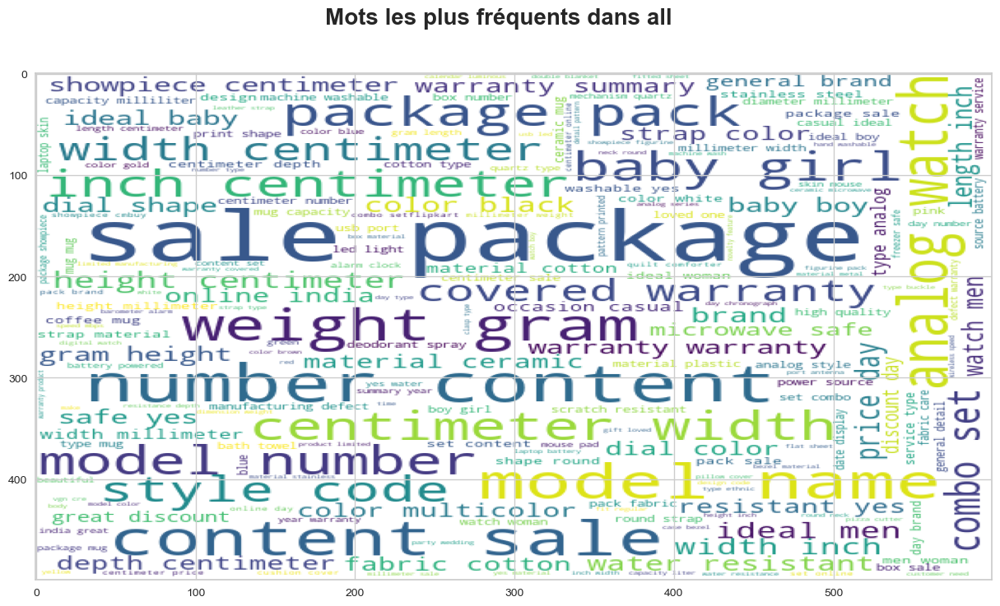

In [75]:
create_wordcloud(data_text['description_full'], 'all')

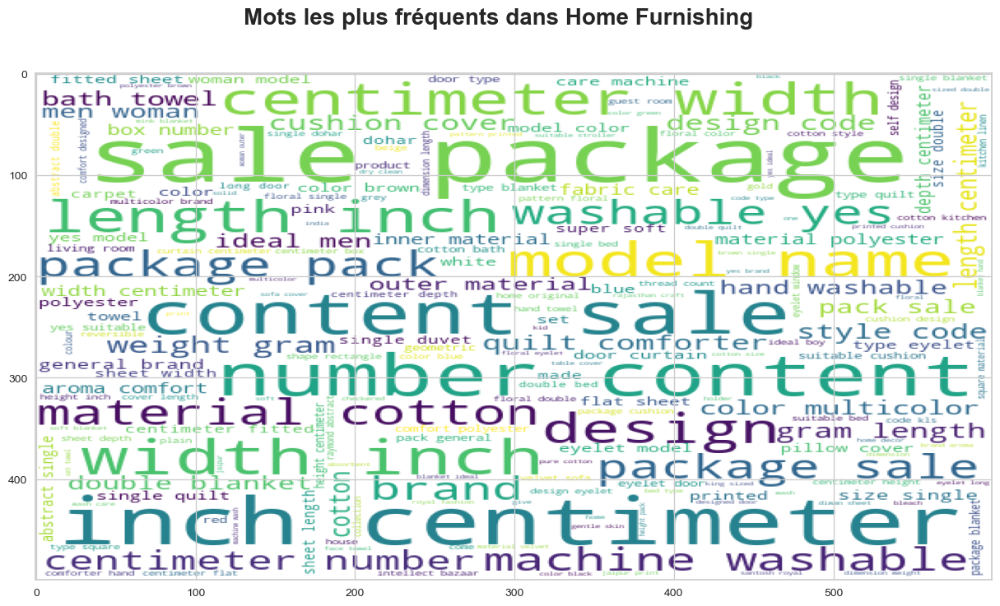

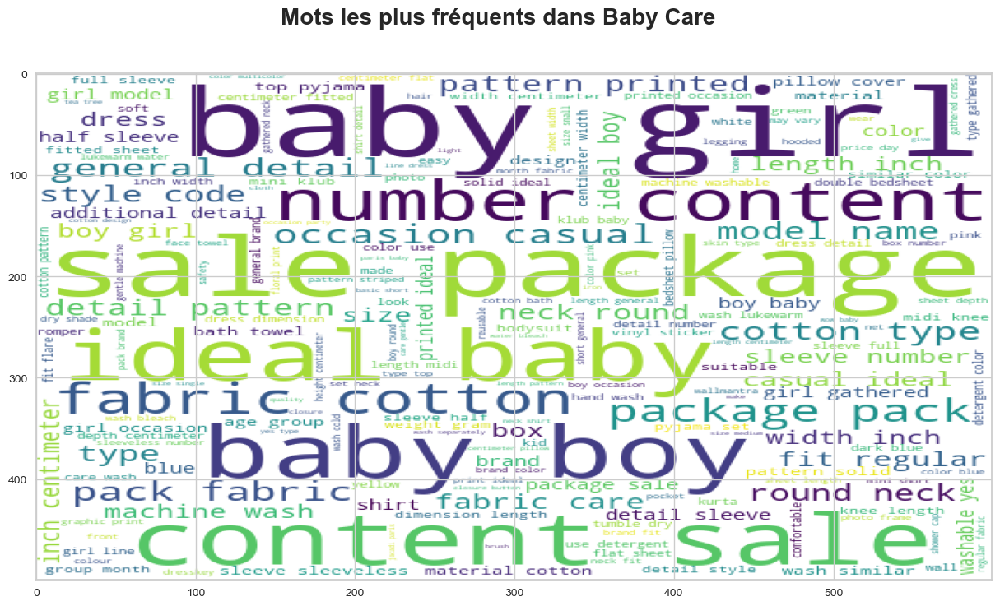

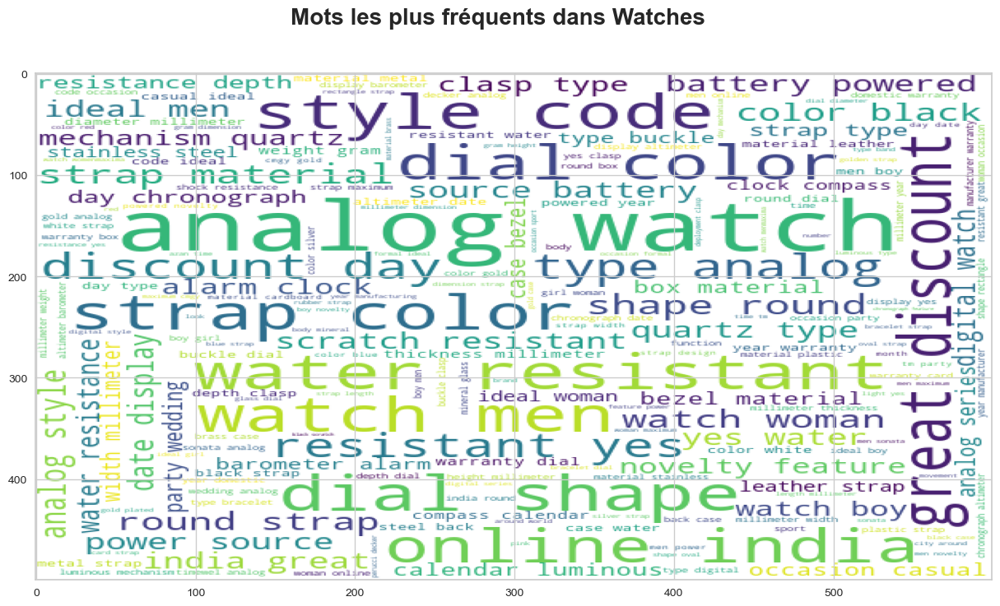

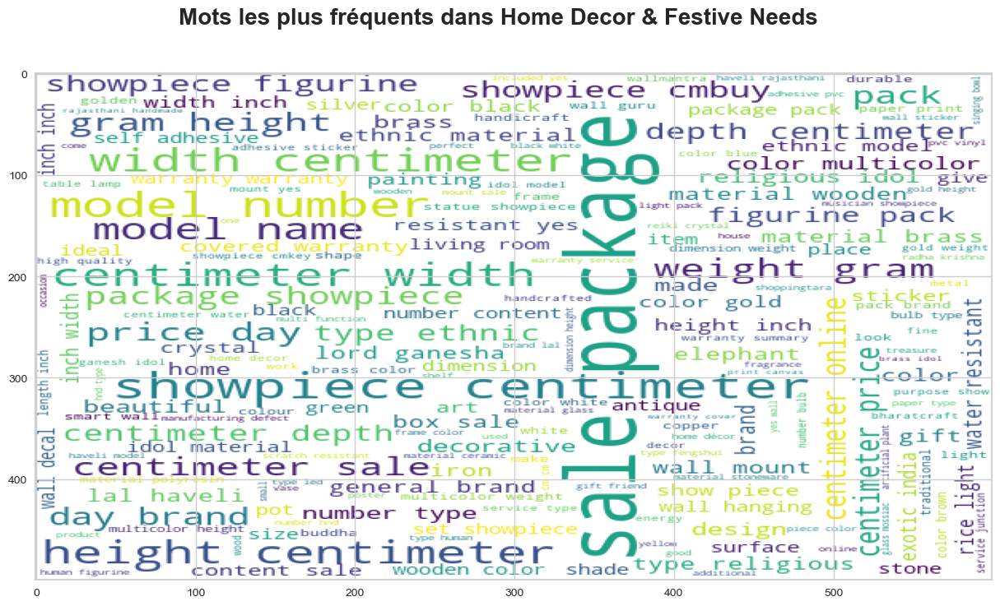

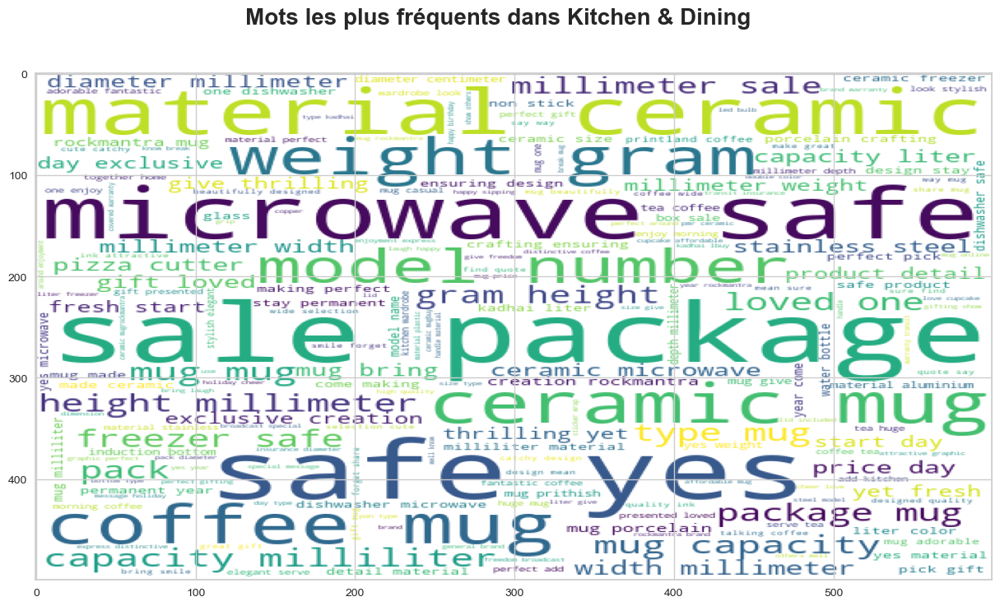

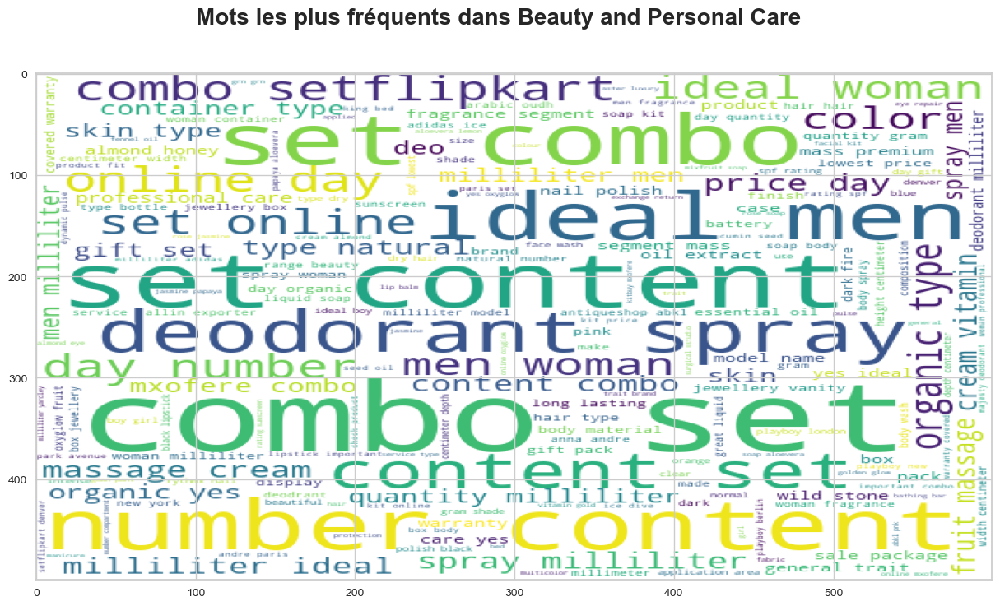

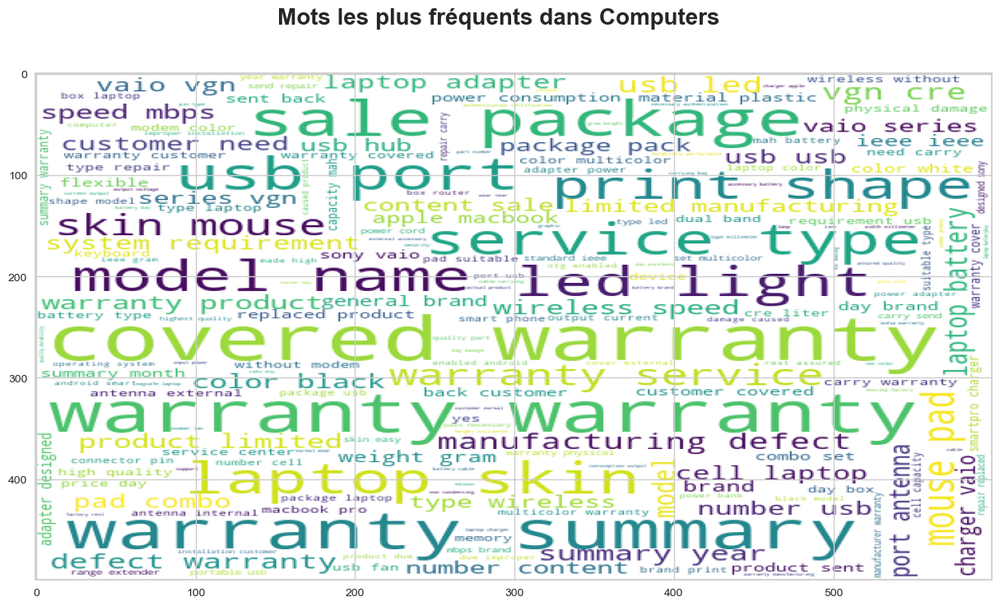

In [76]:
for cat in categories :
    data = data_text[data_text['product_category']==cat]
    create_wordcloud(data['description_full'], cat)

In [77]:
data_text

,uniq_id,product_name,product_category_tree,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,...,description_ml,description_deep,encode_cat,price_discretized,discount,discount_discretization,specification_str,price_discretized_word,discount_discretization_word,description_full
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[Home Furnishing, Curtains & Accessories, Curt...",1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Elegance Polyester Multicolor Abstract Eyelet ...,No rating available,No rating available,...,elegance polyester multicolor abstract eyelet ...,elegance polyester multicolor abstract eyelet ...,1,6,0.526593,4,Brand Elegance Designed For Door Type Eyelet M...,six,four,elegance polyester multicolor abstract eyelet ...
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[Baby Care, Baby Bath & Skin, Baby Bath Towels...",600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Sathiyas Cotton Bath TowelSpecifications of Sa...,No rating available,No rating available,...,sathiyas cotton bath towelspecifications sathi...,sathiyas cotton bath towelspecifications of sa...,2,3,0.251667,3,Machine Washable Yes Material Cotton Design Se...,three,three,sathiyas cotton bath towelspecifications sathi...
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,"[Baby Care, Baby Bath & Skin, Baby Bath Towels...",999.0,600.0,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Eurospa Cotton Terry Face Towel SetKey Feature...,No rating available,No rating available,...,eurospa cotton terry face towel setkey eurospa...,eurospa cotton terry face towel setkey feature...,2,4,0.399399,3,Material Cotton Terry Design SHUVAM Brand Euro...,four,three,eurospa cotton terry face towel setkey eurospa...
3,d4684dcdc759dd9cdf41504698d737d8,SANTOSH ROYAL FASHION Cotton Printed King size...,"[Home Furnishing, Bed Linen, Bedsheets, SANTOS...",2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,SANTOSH ROYAL FASHION Cotton Printed King size...,No rating available,No rating available,...,santosh royal fashion cotton printed king size...,santosh royal fashion cotton printed king size...,1,6,0.518711,4,Brand SANTOSH ROYAL FASHION Machine Washable Y...,six,four,santosh royal fashion cotton printed king size...
4,6325b6870c54cd47be6ebfbffa620ec7,Jaipur Print Cotton Floral King sized Double B...,"[Home Furnishing, Bed Linen, Bedsheets, Jaipur...",2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Jaipur Print Cotton Floral King sized Double B...,No rating available,No rating available,...,jaipur print cotton floral king sized double b...,jaipur print cotton floral king sized double b...,1,6,0.731435,5,Machine Washable Yes Brand Jaipur Print Type F...,six,five,jaipur print cotton floral king sized double b...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,Oren Empower Extra Large Self Adhesive Sticker,"[Baby Care, Baby & Kids Gifts, Stickers, Oren ...",1399.0,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,False,Oren Empower Extra Large Self Adhesive Sticker...,No rating available,No rating available,...,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,2,5,0.285919,3,Number of Contents in Sales Package Pack of 2 ...,five,three,oren empower extra large self adhesive sticker...
1046,fd6cbcc22efb6b761bd564c28928483c,Wallmantra Large Vinyl Sticker Sticker,"[Baby Care, Baby & Kids Gifts, Stickers, Wallm...",4930.0,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,False,Wallmantra Large Vinyl Sticker StickerWallmant...,No rating available,No rating available,...,wallmantra large vinyl sticker stickerwallmant...,wallmantra large vinyl sticker stickerwallmant...,2,7,0.615416,5,Number of Contents in Sales Package Pack of 1 ...,seven,five,wallmantra large vinyl sticker stickerwallmant...
1047,5912e037d12774bb73a2048f35a00009,Ub

In [78]:
data_text['description_full_ml'] = data_text[
    'price_discretized_word'] + ' ' + data_text['discount_discretization_word'] + ' ' + data_text['description_full']

In [79]:
data_text['retail_price'] = data_text['retail_price'].astype(str)

In [80]:
data_text['description_deep_full'] = data_text['description'] + data_text['specification_str']
data_text['description_deep_full'] = data_text['description_deep_full'].apply(lambda x : preprocess_deep(x))


data_text['description_deep_price'] = '[price_dicretized]' + ' ' + data_text[
    'price_discretized'] + ' ' + '[price]' + ' ' + data_text[
    'retail_price'] + ' ' + '[discount]' + ' ' + data_text[
    'discount_discretization'] + ' ' + data_text['description']

data_text['description_deep_full'] = '[price_dicretized]' +' ' + data_text[
    'price_discretized'] + ' ' + '[price]' + ' ' + data_text[
    'retail_price'] + ' ' + '[discount]' + ' ' + data_text[
    'discount_discretization'] + ' ' + data_text['description_deep_full']

In [81]:
df = data_text[['product_category', 'encode_cat', 'description_ml',
       'description_full_ml', 'description_deep', 'description_deep_price',
       'description_deep_full']]

In [82]:
df

,product_category,encode_cat,description_ml,description_full_ml,description_deep,description_deep_price,description_deep_full
0,Home Furnishing,1,elegance polyester multicolor abstract eyelet ...,six four elegance polyester multicolor abstrac...,elegance polyester multicolor abstract eyelet ...,[price_dicretized] 6 [price] 1899.0 [discount]...,[price_dicretized] 6 [price] 1899.0 [discount]...
1,Baby Care,2,sathiyas cotton bath towelspecifications sathi...,three three sathiyas cotton bath towelspecific...,sathiyas cotton bath towelspecifications of sa...,[price_dicretized] 3 [price] 600.0 [discount] ...,[price_dicretized] 3 [price] 600.0 [discount] ...
2,Baby Care,2,eurospa cotton terry face towel setkey eurospa...,four three eurospa cotton terry face towel set...,eurospa cotton terry face towel setkey feature...,[price_dicretized] 4 [price] 999.0 [discount] ...,[price_dicretized] 4 [price] 999.0 [discount] ...
3,Home Furnishing,1,santosh royal fashion cotton printed king size...,six four santosh royal fashion cotton printed ...,santosh royal fashion cotton printed king size...,[price_dicretized] 6 [price] 2699.0 [discount]...,[price_dicretized] 6 [price] 2699.0 [discount]...
4,Home Furnishing,1,jaipur print cotton floral king sized double b...,six five jaipur print cotton floral king sized...,jaipur print cotton floral king sized double b...,[price_dicretized] 6 [price] 2599.0 [discount]...,[price_dicretized] 6 [price] 2599.0 [discount]...
...,...,...,...,...,...,...,...
1045,Baby Care,2,oren empower extra large self adhesive sticker...,five three oren empower extra large self adhes...,oren empower extra large self adhesive sticker...,[price_dicretized] 5 [price] 1399.0 [discount]...,[price_dicretized] 5 [price] 1399.0 [discount]...
1046,Baby Care,2,wallmantra large vinyl sticker stickerwallmant...,seven five wallmantra large vinyl sticker stic...,wallmantra large vinyl sticker stickerwallmant...,[price_dicretized] 7 [price] 4930.0 [discount]...,[price_dicretized] 7 [price] 4930.0 [discount]...
1047,Baby Care,2,uberlyfe extra large pigmented polyvinyl film ...,seven five uberlyfe extra large pigmented poly...,uberlyfe extra large pigmented polyvinyl films...,[price_dicretized] 7 [price] 4500.0 [discount]...,[price_dicretized] 7 [price] 4500.0 [discount]...
1048,Baby Care,2,wallmantra medium vinyl sticker stickerbuy wal...,seven five wallmantra medium vinyl sticker sti...,wallmantra medium vinyl sticker stickerbuy wal...,[price_dicretized] 7 [price] 3465.0 [discount]...,[price_dicretized] 7 [price] 3465.0 [discount]...


## Classification feasibility

### Usefull Functions

In [83]:
def ARI_fct(features, N_CLUSTERS, encode_cat, perplexity=20) :
    time1 = time.time()
    num_labels=len(l_cat)
    tsne = manifold.TSNE(n_components=2, perplexity=perplexity, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features)
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters=N_CLUSTERS, n_init=200, random_state=42)
    cls.fit(X_tsne)
    ARI = np.round(metrics.adjusted_rand_score(encode_cat, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print("ARI : ", ARI, "time : ", time2)
    
    return ARI, X_tsne, cls.labels_


def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=y_cat_num, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=l_cat, loc="best", title="Categorie")
    plt.title('Représentation des catégories de produits réelles')
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=labels, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=set(labels), loc="best", title="Clusters")
    plt.title('Représentation des catégories de produits par clusters')
    
    plt.show()
    print("ARI : ", ARI)

# match kmeans clusters with true clusters
def clusters_matching(cat_true, cat_kmeans):
    conf_mat = confusion_matrix(cat_true, cat_kmeans)
    print(conf_mat)
    print()
    corresp = np.argmax(conf_mat, axis=0)
    print(corresp)
    labels = pd.Series(cat_true, name="cat_true").to_frame()
    labels['cat_kmeans'] = cat_kmeans
    labels['y_kmeans_transform'] = labels['cat_kmeans'].apply(lambda x : corresp[x]) 
    
    return labels['y_kmeans_transform']

def confusion_matrix_plot(y_true, y_pred, categories):
    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(cm, display_labels=categories)
    fig, ax = plt.subplots(figsize=(10,10))
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
                 rotation_mode="anchor")
    disp.plot(xticks_rotation=55, ax=ax, cmap=plt.cm.Blues)

def pca_(X):
    N_COMP = 70
    pca = PCA(n_components=N_COMP)
    X_pca = pca.fit_transform(X)
    return X_pca

def create_bag_words(model, X, stop_words='english', max_df=1, min_df=1) -> np.array:
    if model == 'tf_idf':
        model = TfidfVectorizer(stop_words=stop_words, max_df=max_df, min_df=min_df)
        ctf = model.fit_transform(X)
        return ctf.toarray()
    else :
        model = CountVectorizer(stop_words=stop_words, max_df=max_df, min_df=min_df)
        cv = model.fit_transform(X)
        return cv.to_array()

### TF-IDF

In [84]:
# best_score : TfidfVectorizer(stop_words='english', max_df=0.90, min_df=4) , perplexity = 30
# max_df= 0.7 |  min_df= 1 |  perplexity= 10 ARI :  0.6481 time :  5.0

In [85]:
l_cat =  list(data_text['product_category'].unique())
y_cat_num = data_text['encode_cat']
N_CLUSTERS = len(l_cat) # nombre de catégories de produits

In [86]:
a= create_bag_words('tf_idf', data_text['description_ml'], stop_words='english', max_df=0.90, min_df=4)

In [87]:
a.shape

(1050, 1111)

In [88]:
data_text['description_ml'][0]

'elegance polyester multicolor abstract eyelet door curtainkey elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain centimeter height pack curtain enhances look interior curtain made high quality polyester fabric eyelet style stitch metal ring make room environment romantic loving curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal design surreal attention sure steal heart contemporary eyelet valance curtain slide smoothly draw apart first thing morning welcome bright sun ray want wish good morning whole world draw close evening create special moment joyous beauty given soothing print bring home elegant curtain softly filter light room get right amount sunlight elegance polyester multicolor abstract eyelet door curtain centimeter height pack general brand elegance designed door type eyelet model name abstract polyester door curtain set model duster color multicolor dimen

In [89]:
# description_ml simple
X = data_text['description_ml']

max_dfs = [0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3]
min_dfs = [1, 2, 3, 4, 5, 6, 7, 8]
perplexities = [10, 40]

scores = {
    'ARI' : [],
    'params' : []
}
scores_pca = {
    'ARI' : [],
    'params' : []
}

def random_choice(choices):
    return np.random.choice(choices)

for i in range(10):
    max_df=random_choice(max_dfs)
    min_df=random_choice(min_dfs)
    bag_words = create_bag_words('tf_idf',
                                 X,
                                 stop_words='english',
                                 max_df=max_df,
                                 min_df=min_df)
    X_pca = pca_(bag_words)
    for perplexity in perplexities: 
        print(i)
        print('max_df=',max_df, '|  min_df=',min_df, '|  perplexity=',perplexity)
        ARI, X_tsne, labels = ARI_fct(bag_words, N_CLUSTERS, y_cat_num, perplexity)
        scores['ARI'].append(ARI)
        scores['params'].append([max_df, min_df, perplexity])
        print('PCA', '|  max_df=',max_df, '|  min_df=',min_df, '|  perplexity=',perplexity)
        ARI_pca, X_tsne_pca, labels_pca = ARI_fct(X_pca, N_CLUSTERS, y_cat_num, perplexity)
        scores_pca['ARI'].append(ARI_pca)
        scores_pca['params'].append([max_df, min_df, perplexity])
        print('')
    print('-----------------------')

0
max_df= 0.9 |  min_df= 5 |  perplexity= 10
ARI :  0.5139 time :  4.0
PCA |  max_df= 0.9 |  min_df= 5 |  perplexity= 10
ARI :  0.3734 time :  4.0

0
max_df= 0.9 |  min_df= 5 |  perplexity= 40
ARI :  0.5239 time :  5.0
PCA |  max_df= 0.9 |  min_df= 5 |  perplexity= 40
ARI :  0.473 time :  5.0

-----------------------
1
max_df= 0.5 |  min_df= 1 |  perplexity= 10
ARI :  0.6481 time :  5.0
PCA |  max_df= 0.5 |  min_df= 1 |  perplexity= 10
ARI :  0.3602 time :  4.0

1
max_df= 0.5 |  min_df= 1 |  perplexity= 40
ARI :  0.5252 time :  6.0
PCA |  max_df= 0.5 |  min_df= 1 |  perplexity= 40
ARI :  0.4406 time :  5.0

-----------------------
2
max_df= 0.5 |  min_df= 3 |  perplexity= 10
ARI :  0.5288 time :  4.0
PCA |  max_df= 0.5 |  min_df= 3 |  perplexity= 10
ARI :  0.3593 time :  4.0

2
max_df= 0.5 |  min_df= 3 |  perplexity= 40
ARI :  0.5427 time :  5.0
PCA |  max_df= 0.5 |  min_df= 3 |  perplexity= 40
ARI :  0.3957 time :  5.0

-----------------------
3
max_df= 0.8 |  min_df= 5 |  perplexity=

best ari : 0.6481 || paramètres : max_df : 0.5, min_df : 1, perplexity : 10


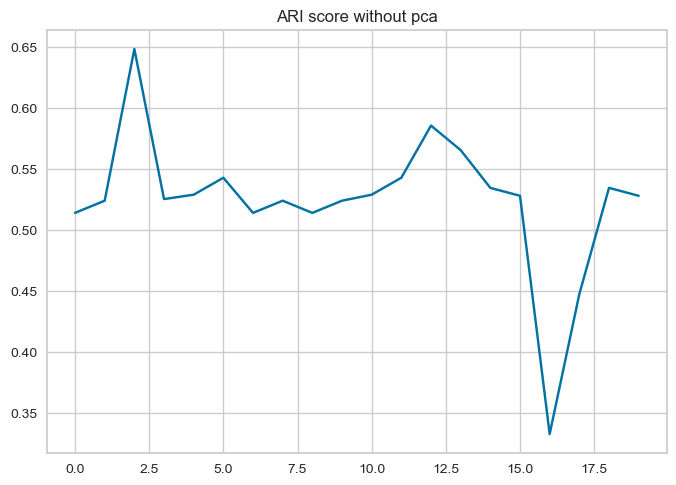

In [90]:
sns.lineplot(y=scores['ARI'], x=[i for i in range(len(scores['ARI']))])
plt.title('ARI score without pca');
print(f"best ari : {max(scores['ARI'])} || paramètres : max_df : {scores['params'][scores['ARI'].index(max(scores['ARI']))][0]}, min_df : {scores['params'][scores['ARI'].index(max(scores['ARI']))][1]}, perplexity : {scores['params'][scores['ARI'].index(max(scores['ARI']))][2]}")

best ari : 0.5251 || paramètres : max_df : 0.7, min_df : 7, perplexity : 40


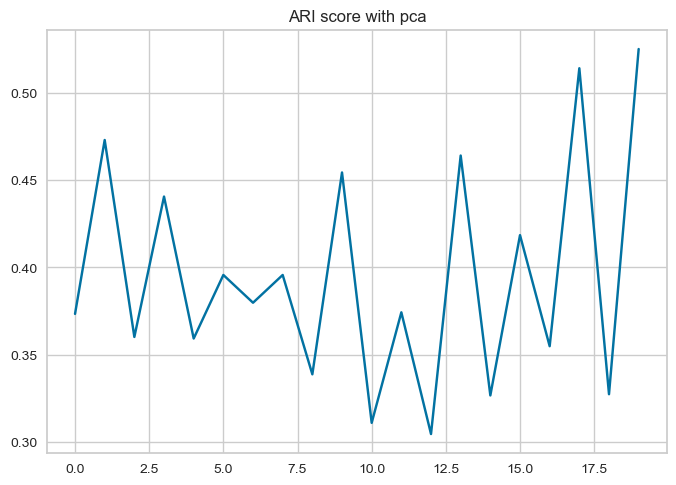

In [91]:
sns.lineplot(y=scores_pca['ARI'], x=[i for i in range(len(scores_pca['ARI']))])
plt.title('ARI score with pca');
print(f"best ari : {max(scores_pca['ARI'])} || paramètres : max_df : {scores_pca['params'][scores_pca['ARI'].index(max(scores_pca['ARI']))][0]}, min_df : {scores_pca['params'][scores_pca['ARI'].index(max(scores_pca['ARI']))][1]}, perplexity : {scores_pca['params'][scores_pca['ARI'].index(max(scores_pca['ARI']))][2]}")

In [92]:
# description_ml simple
X = data_text['description_ml']

max_dfs = [0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3]
min_dfs = [1, 2, 3, 4, 5, 6, 7, 8]
perplexities = [10, 40]

scores = {
    'ARI' : [],
    'params' : []
}
scores_pca = {
    'ARI' : [],
    'params' : []
}

def random_choice(choices):
    return np.random.choice(choices)

for i in range(10):
    max_df=random_choice(max_dfs)
    min_df=random_choice(min_dfs)
    bag_words = create_bag_words('tf_idf',
                                 X,
                                 stop_words='english',
                                 max_df=max_df,
                                 min_df=min_df)
    X_pca = pca_(bag_words)
    for perplexity in perplexities: 
        print(i)
        print('max_df=',max_df, '|  min_df=',min_df, '|  perplexity=',perplexity)
        ARI, X_tsne, labels = ARI_fct(bag_words, N_CLUSTERS, y_cat_num, perplexity)
        scores['ARI'].append(ARI)
        scores['params'].append([max_df, min_df, perplexity])
        print('PCA', '|  max_df=',max_df, '|  min_df=',min_df, '|  perplexity=',perplexity)
        ARI_pca, X_tsne_pca, labels_pca = ARI_fct(X_pca, N_CLUSTERS, y_cat_num, perplexity)
        scores_pca['ARI'].append(ARI_pca)
        scores_pca['params'].append([max_df, min_df, perplexity])
        print('')
    print('-----------------------')

0
max_df= 0.7 |  min_df= 7 |  perplexity= 10
ARI :  0.5344 time :  5.0
PCA |  max_df= 0.7 |  min_df= 7 |  perplexity= 10
ARI :  0.3558 time :  4.0

0
max_df= 0.7 |  min_df= 7 |  perplexity= 40
ARI :  0.5279 time :  5.0
PCA |  max_df= 0.7 |  min_df= 7 |  perplexity= 40
ARI :  0.5472 time :  5.0

-----------------------
1
max_df= 0.4 |  min_df= 2 |  perplexity= 10
ARI :  0.3622 time :  5.0
PCA |  max_df= 0.4 |  min_df= 2 |  perplexity= 10
ARI :  0.3684 time :  4.0

1
max_df= 0.4 |  min_df= 2 |  perplexity= 40
ARI :  0.4881 time :  5.0
PCA |  max_df= 0.4 |  min_df= 2 |  perplexity= 40
ARI :  0.4716 time :  5.0

-----------------------
2
max_df= 0.7 |  min_df= 4 |  perplexity= 10
ARI :  0.4855 time :  4.0
PCA |  max_df= 0.7 |  min_df= 4 |  perplexity= 10
ARI :  0.3005 time :  4.0

2
max_df= 0.7 |  min_df= 4 |  perplexity= 40
ARI :  0.5024 time :  5.0
PCA |  max_df= 0.7 |  min_df= 4 |  perplexity= 40
ARI :  0.461 time :  5.0

-----------------------
3
max_df= 0.8 |  min_df= 1 |  perplexity=

In [93]:
# description_ml full
X = data_text['description_full_ml']

max_dfs = [0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3]
min_dfs = [1, 2, 3, 4, 5, 6, 7, 8]
perplexities = [10, 40]

scores = {
    'ARI' : [],
    'params' : []
}
scores_pca = {
    'ARI' : [],
    'params' : []
}

def random_choice(choices):
    return np.random.choice(choices)

for i in range(20):
    max_df=random_choice(max_dfs)
    min_df=random_choice(min_dfs)
    bag_words = create_bag_words('tf_idf',
                                 X,
                                 stop_words='english',
                                 max_df=max_df,
                                 min_df=min_df)
    X_pca = pca_(bag_words)
    for perplexity in perplexities: 
        print('max_df=',max_df, '|  min_df=',min_df, '|  perplexity=', perplexity)
        ARI, X_tsne, labels = ARI_fct(bag_words, N_CLUSTERS, y_cat_num, perplexity)
        scores['ARI'].append(ARI)
        scores['params'].append([max_df, min_df, perplexity])
        print('PCA', '|  max_df=',max_df, '|  min_df=',min_df, '|  perplexity=',perplexity)
        ARI_pca, X_tsne_pca, labels_pca = ARI_fct(X_pca, N_CLUSTERS, y_cat_num, perplexity)
        scores_pca['ARI'].append(ARI_pca)
        scores_pca['params'].append([max_df, min_df, perplexity])
        print('')
    print('-----------------------')

max_df= 0.7 |  min_df= 2 |  perplexity= 10
ARI :  0.6167 time :  4.0
PCA |  max_df= 0.7 |  min_df= 2 |  perplexity= 10
ARI :  0.3532 time :  4.0

max_df= 0.7 |  min_df= 2 |  perplexity= 40
ARI :  0.6338 time :  5.0
PCA |  max_df= 0.7 |  min_df= 2 |  perplexity= 40
ARI :  0.4757 time :  5.0

-----------------------
max_df= 0.7 |  min_df= 7 |  perplexity= 10
ARI :  0.5148 time :  4.0
PCA |  max_df= 0.7 |  min_df= 7 |  perplexity= 10
ARI :  0.3836 time :  4.0

max_df= 0.7 |  min_df= 7 |  perplexity= 40
ARI :  0.649 time :  5.0
PCA |  max_df= 0.7 |  min_df= 7 |  perplexity= 40
ARI :  0.5231 time :  5.0

-----------------------
max_df= 0.6 |  min_df= 7 |  perplexity= 10
ARI :  0.4805 time :  4.0
PCA |  max_df= 0.6 |  min_df= 7 |  perplexity= 10
ARI :  0.3855 time :  4.0

max_df= 0.6 |  min_df= 7 |  perplexity= 40
ARI :  0.6445 time :  5.0
PCA |  max_df= 0.6 |  min_df= 7 |  perplexity= 40
ARI :  0.5602 time :  5.0

-----------------------
max_df= 0.9 |  min_df= 1 |  perplexity= 10
ARI :  0.6

In [94]:
scores['params'][scores['ARI'].index(max(scores['ARI']))][0]

0.9

best ari : 0.6901 || paramètres : max_df : 0.9, min_df : 1, perplexity : 40


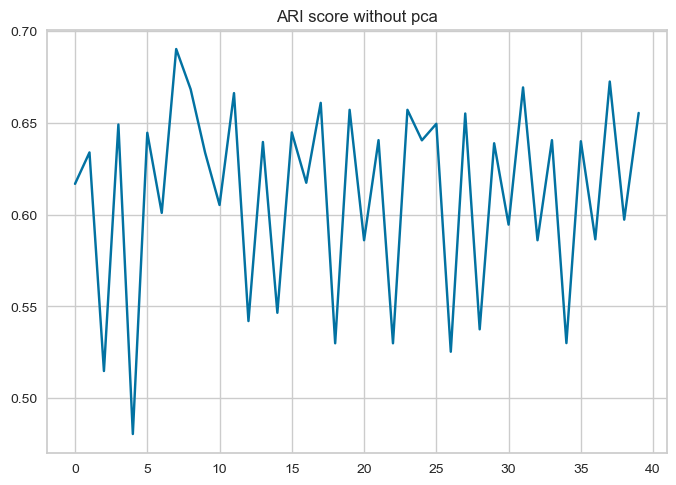

In [95]:
sns.lineplot(y=scores['ARI'], x=[i for i in range(len(scores['ARI']))])
plt.title('ARI score without pca');
print(f"best ari : {max(scores['ARI'])} || paramètres : max_df : {scores['params'][scores['ARI'].index(max(scores['ARI']))][0]}, min_df : {scores['params'][scores['ARI'].index(max(scores['ARI']))][1]}, perplexity : {scores['params'][scores['ARI'].index(max(scores['ARI']))][2]}")

best ari : 0.5602 || paramètres : max_df : 0.6, min_df : 7, perplexity : 40


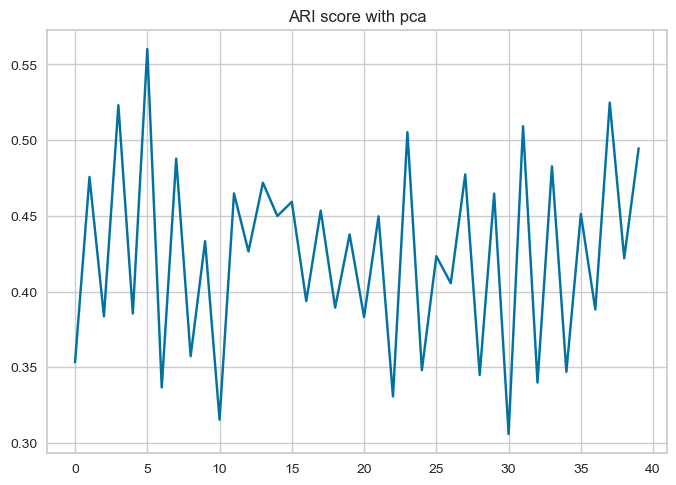

In [96]:
sns.lineplot(y=scores_pca['ARI'], x=[i for i in range(len(scores_pca['ARI']))])
plt.title('ARI score with pca');
print(f"best ari : {max(scores_pca['ARI'])} || paramètres : max_df : {scores_pca['params'][scores_pca['ARI'].index(max(scores_pca['ARI']))][0]}, min_df : {scores_pca['params'][scores_pca['ARI'].index(max(scores_pca['ARI']))][1]}, perplexity : {scores_pca['params'][scores_pca['ARI'].index(max(scores_pca['ARI']))][2]}")

In [97]:
# best ari : 0.6841 || paramètres : max_df : 0.6, min_df : 3, perplexity : 40

In [98]:
# création du bag of words (CountVectorizer et Tf-idf)

cvect = CountVectorizer(stop_words='english', max_df=0.95, min_df=2)
ctf = TfidfVectorizer(stop_words='english', max_df=0.60, min_df=2)


cv_fit = cvect.fit(data_text['description_full_ml'])
ctf_fit = ctf.fit(data_text['description_full_ml'])

cv_transform = cv_fit.transform(data_text['description_full_ml'])  
ctf_transform = ctf_fit.transform(data_text['description_full_ml'])  

In [99]:
ctf_transform.toarray().shape

(1050, 2598)

In [100]:
pd.DataFrame(ctf_transform.toarray(),columns = ctf.get_feature_names_out()).head()

,aaa,aapno,ability,abkl,able,abode,absorbency,absorbent,abstract,abuy,...,young,youth,youthful,yr,yuva,zao,zero,zipper,zone,zyxel
0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.213541,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.058052,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### PCA

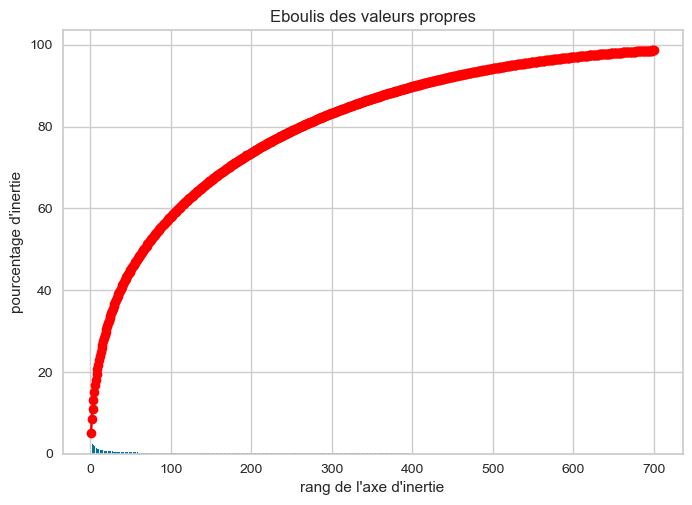

In [331]:
N_COMP = 700

X=ctf_transform#.toarray()
# std_scale = StandardScaler().fit(X)
# X_scaled = std_scale.transform(X)
pca = PCA(n_components=N_COMP)
pca.fit(X)

X_pca = pca.transform(X)
display_scree_plot(pca)


/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


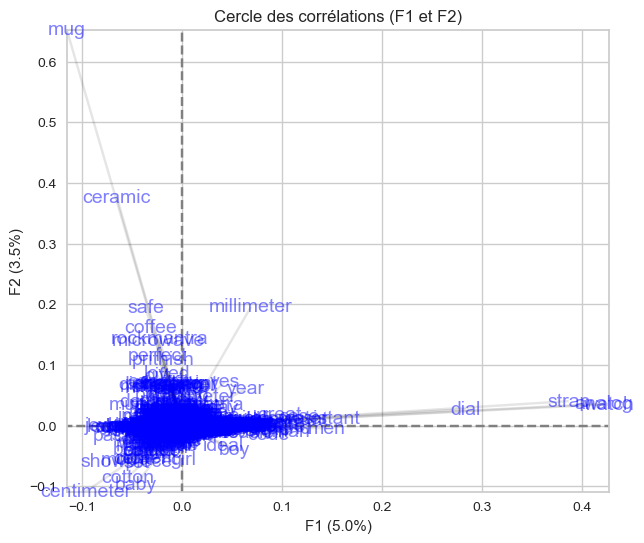

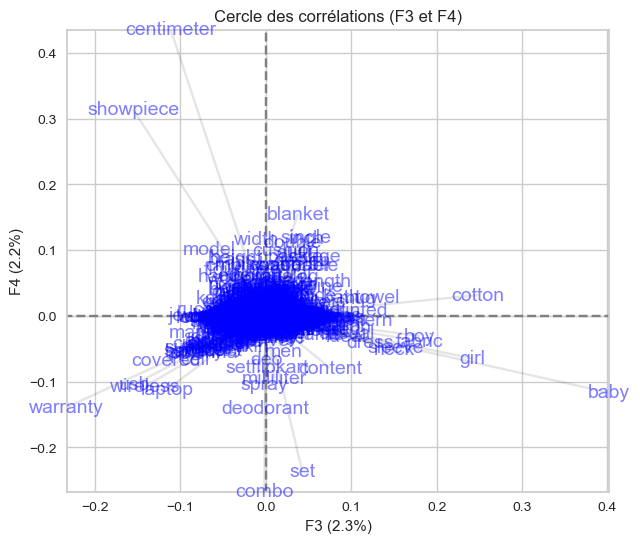

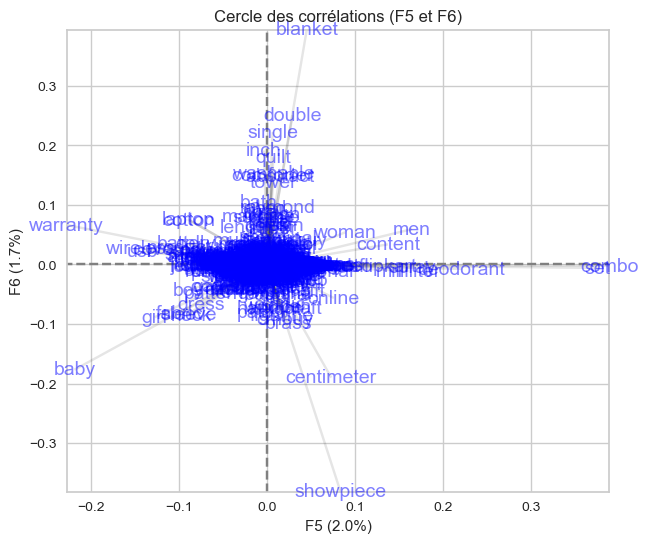

In [102]:
pcs = pca.components_
display_circles(pcs, N_COMP, pca, [(0, 1), (2, 3), (4, 5)], labels=list(ctf.get_feature_names()))

#### ARI

In [103]:
l_cat =  list(data_text['product_category'].unique())
y_cat_num = data_text['encode_cat']
N_CLUSTERS = len(l_cat) # nombre de catégories de produits

In [104]:
ctf_transform = create_bag_words('tf_idf', data_text['description_full_ml'], stop_words='english', max_df=0.6, min_df=2)

In [105]:
print("CountVectorizer : ")
print("-----------------")
ARI, X_tsne, labels = ARI_fct(cv_transform, N_CLUSTERS, y_cat_num, 30)
print()
print("Tf-idf : ")
print("--------")
ARI, X_tsne, labels = ARI_fct(ctf_transform, N_CLUSTERS, y_cat_num, 40)


CountVectorizer : 
-----------------
ARI :  0.5439 time :  5.0

Tf-idf : 
--------
ARI :  0.7125 time :  6.0


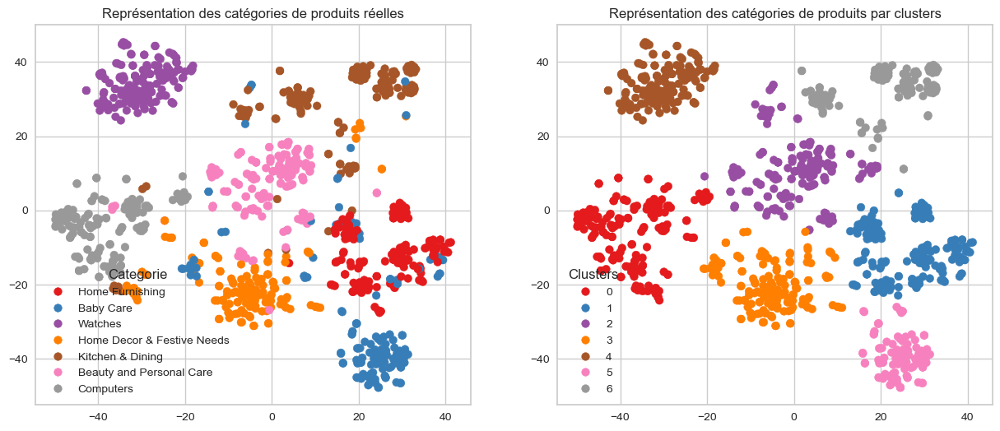

ARI :  0.7125


In [106]:
 TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [107]:
data_text['y_kmeans_transform'] = clusters_matching(y_cat_num, labels)

[[  0   0   0   0   0   0   0   0]
 [  0 144   0   1   0   5   0   0]
 [  0  25  10  17   0  95   3   0]
 [  0   0   0   0 150   0   0   0]
 [ 18   0   0 123   0   0   9   0]
 [  9   2  30   2   0   0 107   0]
 [  4   2 132  12   0   0   0   0]
 [149   0   1   0   0   0   0   0]]

[7 1 6 4 3 2 5 0]


In [108]:
print(classification_report(data_text['encode_cat'], data_text['y_kmeans_transform']))

              precision    recall  f1-score   support

           1       0.83      0.96      0.89       150
           2       0.95      0.63      0.76       150
           3       1.00      1.00      1.00       150
           4       0.79      0.82      0.81       150
           5       0.90      0.71      0.80       150
           6       0.76      0.88      0.82       150
           7       0.83      0.99      0.90       150

    accuracy                           0.86      1050
   macro avg       0.87      0.86      0.85      1050
weighted avg       0.87      0.86      0.85      1050



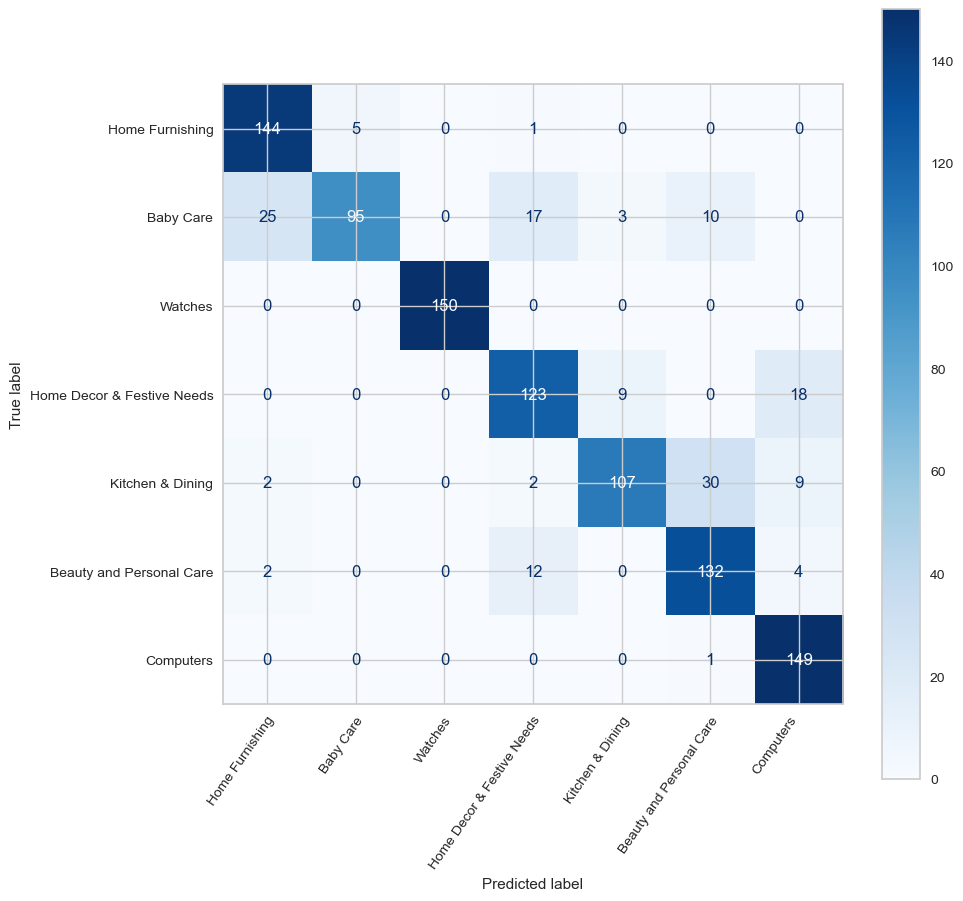

In [109]:
confusion_matrix_plot(data_text['encode_cat'],
                      data_text['y_kmeans_transform'],
                      list(data_text['product_category'].unique()))

### Embedding

#### With description only

In [110]:
col_to_test = 'description_ml'
w2v_size=200
w2v_window=5
w2v_min_count=1
w2v_epochs=100
maxlen = max(data_text[col_to_test].apply(lambda x : len([i for i in x.split()])))
sentences = data_text[col_to_test].to_list()
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [111]:
# Création et entraînement du modèle Word2Vec

print("Build & train Word2Vec model ...")
w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count, window=w2v_window,
                                                vector_size=w2v_size,
                                                seed=42,
                                                workers=1)
#                                                workers=multiprocessing.cpu_count())
w2v_model.build_vocab(sentences)
w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
model_vectors = w2v_model.wv
w2v_words = model_vectors.index_to_key
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 4892
Word2Vec trained


In [112]:
# Préparation des sentences (tokenization)

print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                     maxlen=maxlen,
                                                     padding='post') 
                                                   
num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 4893


In [113]:
# Création de la matrice d'embedding

print("Create Embedding matrix ...")
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i=0
j=0
    
for word, idx in word_index.items():
    i +=1
    if word in w2v_words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i,4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (4893, 200)


In [114]:
# Création du modèle

input = Input(shape=(len(x_sentences),maxlen),dtype='float64')
word_input = Input(shape=(maxlen,), dtype='float64')  
word_embedding = Embedding(input_dim=vocab_size,
                         output_dim=w2v_size,
                         weights = [embedding_matrix],
                         input_length=maxlen)(word_input)
word_vec = GlobalAveragePooling1D()(word_embedding)
embed_model = Model([word_input],word_vec)

embed_model.summary()

Metal device set to: Apple M1
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 354)]             0         
                                                                 
 embedding (Embedding)       (None, 354, 200)          978600    
                                                                 
 global_average_pooling1d (G  (None, 200)              0         
 lobalAveragePooling1D)                                          
                                                                 
Total params: 978,600
Trainable params: 978,600
Non-trainable params: 0
_________________________________________________________________


2022-09-16 16:54:51.405223: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-09-16 16:54:51.407487: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [115]:
embeddings = embed_model.predict(x_sentences)
embeddings.shape

 1/33 [..............................] - ETA: 5s

2022-09-16 16:54:51.675337: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-09-16 16:54:51.803179: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


33/33 [==============================] - 0s 3ms/step


(1050, 200)

In [116]:
ARI, X_tsne, labels = ARI_fct(embeddings, N_CLUSTERS, y_cat_num, 20)

ARI :  0.5317 time :  4.0


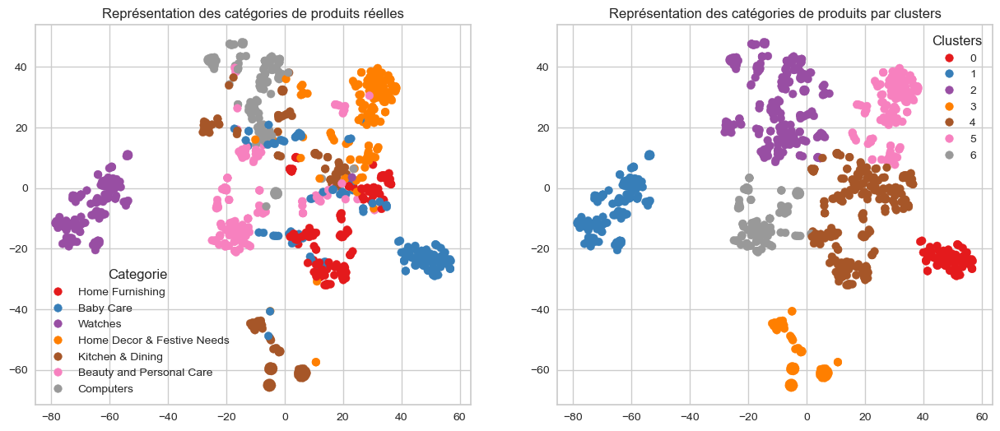

ARI :  0.5317


In [117]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [118]:
data_text['y_kmeans_transform'] = clusters_matching(y_cat_num, labels)

[[  0   0   0   0   0   0   0   0]
 [  0   0   4   0 145   1   0   0]
 [ 82   0  20   2  36   3   7   0]
 [  0 149   0   0   1   0   0   0]
 [  0   0  13   3  13 121   0   0]
 [  0   0  48  74  28   0   0   0]
 [  0   0  25   0  20   9  96   0]
 [  0   0 137   0   2   0  11   0]]

[2 3 7 5 1 4 6 0]


In [119]:
print(classification_report(data_text['encode_cat'], data_text['y_kmeans_transform']))

              precision    recall  f1-score   support

           1       0.59      0.97      0.73       150
           2       1.00      0.55      0.71       150
           3       1.00      0.99      1.00       150
           4       0.90      0.81      0.85       150
           5       0.94      0.49      0.65       150
           6       0.84      0.64      0.73       150
           7       0.55      0.91      0.69       150

    accuracy                           0.77      1050
   macro avg       0.83      0.77      0.76      1050
weighted avg       0.83      0.77      0.76      1050



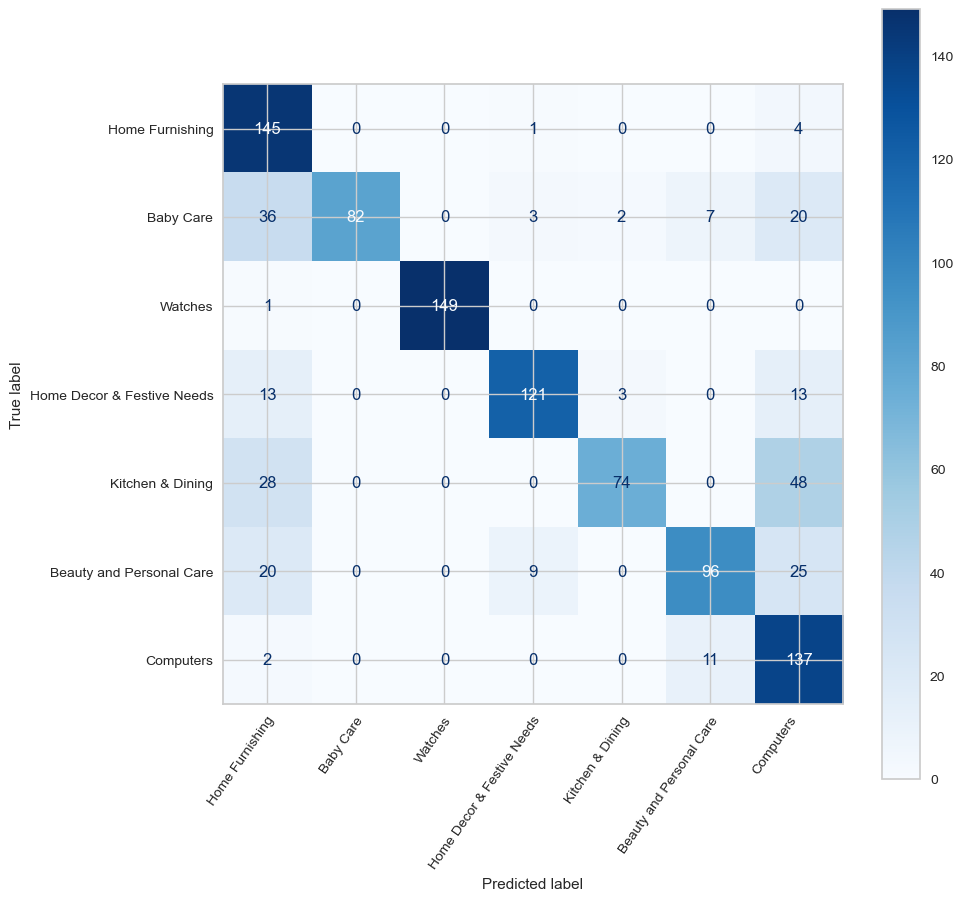

In [120]:
confusion_matrix_plot(data_text['encode_cat'],
                      data_text['y_kmeans_transform'],
                     list(data_text['product_category'].unique()))

#### With full text

In [121]:
col_to_test = 'description_full_ml'
w2v_size=200
w2v_window=5
w2v_min_count=1
w2v_epochs=100
maxlen = max(data_text[col_to_test].apply(lambda x : len([i for i in x.split()])))
sentences = data_text[col_to_test].to_list()
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [122]:
# Création et entraînement du modèle Word2Vec

print("Build & train Word2Vec model ...")
w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count, window=w2v_window,
                                                vector_size=w2v_size,
                                                seed=42,
                                                workers=1)
#                                                workers=multiprocessing.cpu_count())
w2v_model.build_vocab(sentences)
w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
model_vectors = w2v_model.wv
w2v_words = model_vectors.index_to_key
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 5783
Word2Vec trained


In [123]:
# Préparation des sentences (tokenization)

print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                     maxlen=maxlen,
                                                     padding='post') 
                                                   
num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 5784


In [124]:
# Création de la matrice d'embedding

print("Create Embedding matrix ...")
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i=0
j=0
    
for word, idx in word_index.items():
    i +=1
    if word in w2v_words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i,4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (5784, 200)


In [125]:
# Création du modèle

input = Input(shape=(len(x_sentences),maxlen),dtype='float64')
word_input = Input(shape=(maxlen,), dtype='float64')  
word_embedding = Embedding(input_dim=vocab_size,
                         output_dim=w2v_size,
                         weights = [embedding_matrix],
                         input_length=maxlen)(word_input)
word_vec = GlobalAveragePooling1D()(word_embedding)
embed_model = Model([word_input],word_vec)

embed_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 595)]             0         
                                                                 
 embedding_1 (Embedding)     (None, 595, 200)          1156800   
                                                                 
 global_average_pooling1d_1   (None, 200)              0         
 (GlobalAveragePooling1D)                                        
                                                                 
Total params: 1,156,800
Trainable params: 1,156,800
Non-trainable params: 0
_________________________________________________________________


In [126]:
embeddings = embed_model.predict(x_sentences)
embeddings.shape

33/33 [==============================] - 0s 4ms/step


2022-09-16 16:55:07.337229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


(1050, 200)

In [127]:
ARI, X_tsne, labels = ARI_fct(embeddings, N_CLUSTERS, y_cat_num, 20)

ARI :  0.6515 time :  4.0


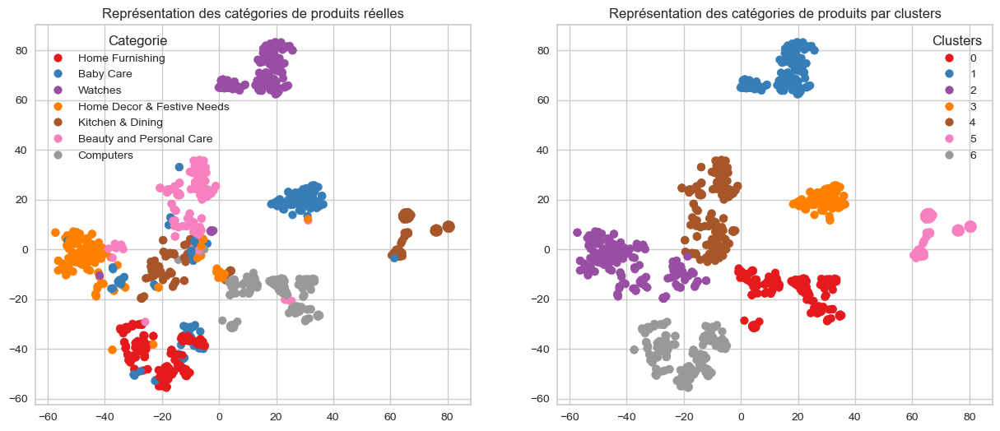

ARI :  0.6515


In [126]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [127]:
data_text['y_kmeans_transform'] = clusters_matching(y_cat_num, labels)

[[  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0 150   0]
 [  0   0  16  85  14   1  34   0]
 [  0 143   1   0   6   0   0   0]
 [ 10   0 128   1   7   0   4   0]
 [  7   0  47   0  22  74   0   0]
 [  3   0  10   1 135   0   1   0]
 [147   0   0   0   3   0   0   0]]

[7 3 4 2 6 5 1 0]


In [128]:
print(classification_report(data_text['encode_cat'], data_text['y_kmeans_transform']))

              precision    recall  f1-score   support

           1       0.79      1.00      0.88       150
           2       0.98      0.57      0.72       150
           3       1.00      0.95      0.98       150
           4       0.63      0.85      0.73       150
           5       0.99      0.49      0.66       150
           6       0.72      0.90      0.80       150
           7       0.88      0.98      0.93       150

    accuracy                           0.82      1050
   macro avg       0.86      0.82      0.81      1050
weighted avg       0.86      0.82      0.81      1050



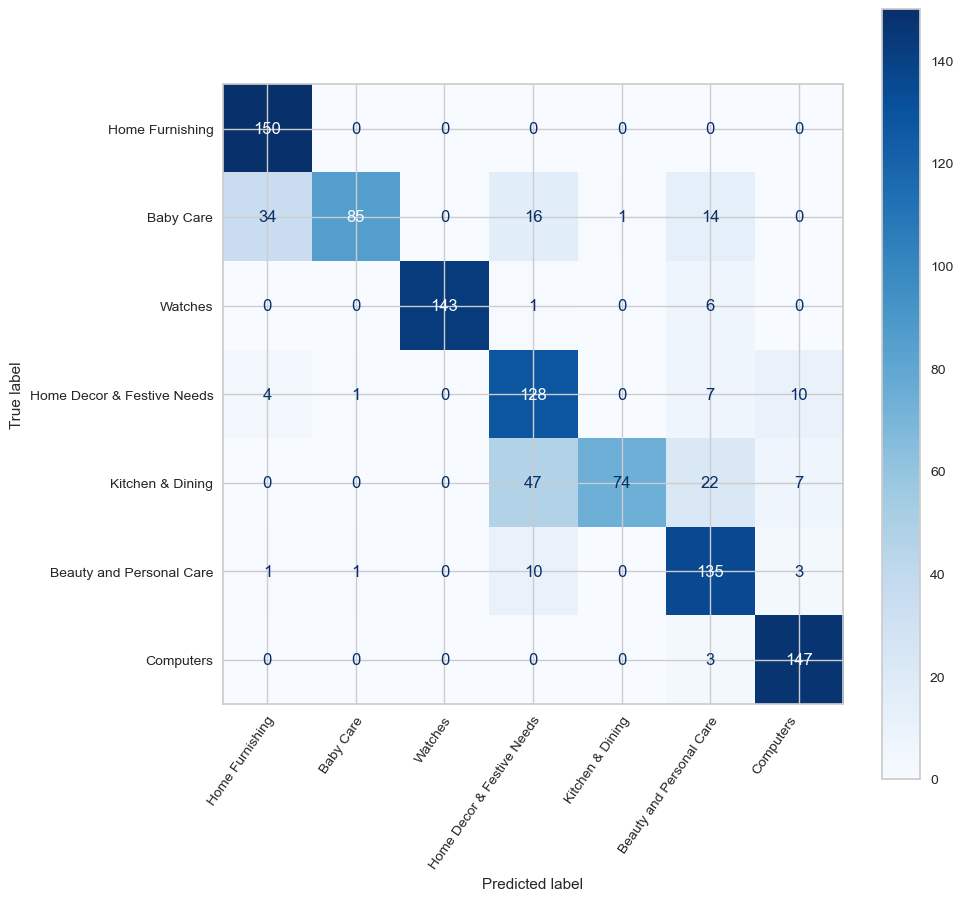

In [129]:
confusion_matrix_plot(data_text['encode_cat'],
                      data_text['y_kmeans_transform'],
                     list(data_text['product_category'].unique()))

### bigBERTa !

#### Functions

In [130]:
# Fonction de préparation des sentences
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot
    

# Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)
        
        if mode=='HF' :    # Bert HuggingFace
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TFhub' : # Bert Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']
             
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    features_bert = np.array(last_hidden_states_tot).mean(axis=1)
    
    time2 = np.round(time.time() - time1,0)
    print("temps traitement : ", time2)
     
    return features_bert, last_hidden_states_tot

#### With simple description

In [131]:
col_to_test = 'description_deep'
max_length = max(data_text[col_to_test].apply(lambda x : len([i for i in x.split()])))
batch_size = 10
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type)
sentences = data_text[col_to_test].to_list()

Some layers from the model checkpoint at bert-base-uncased were not used when initializing TFBertModel: ['nsp___cls', 'mlm___cls']
- This IS expected if you are initializing TFBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertModel were initialized from the model checkpoint at bert-base-uncased.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [132]:
# Création des features

features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='HF')

2022-09-16 08:31:43.995682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 930ms/step
temps traitement :  255.0


In [133]:
ARI, X_tsne, labels = ARI_fct(features_bert, N_CLUSTERS, y_cat_num, 30)

ARI :  0.3055 time :  4.0


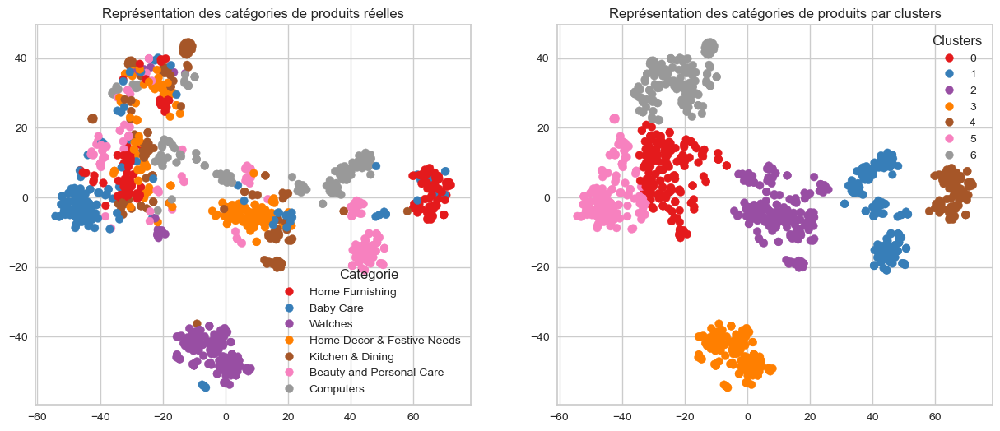

ARI :  0.3055


In [134]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

#### With description

In [131]:
col_to_test = 'description_deep_full'
max_length = max(data_text[col_to_test].apply(lambda x : len([i for i in x.split()])))
batch_size = 5
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type)
sentences = data_text[col_to_test].to_list()

Some layers from the model checkpoint at bert-base-uncased were not used when initializing TFBertModel: ['nsp___cls', 'mlm___cls']
- This IS expected if you are initializing TFBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertModel were initialized from the model checkpoint at bert-base-uncased.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [132]:
# Création des features

features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='HF')

2022-09-16 17:02:20.322642: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 2s 2s/step
temps traitement :  1281.0


ARI :  0.4665 time :  4.0


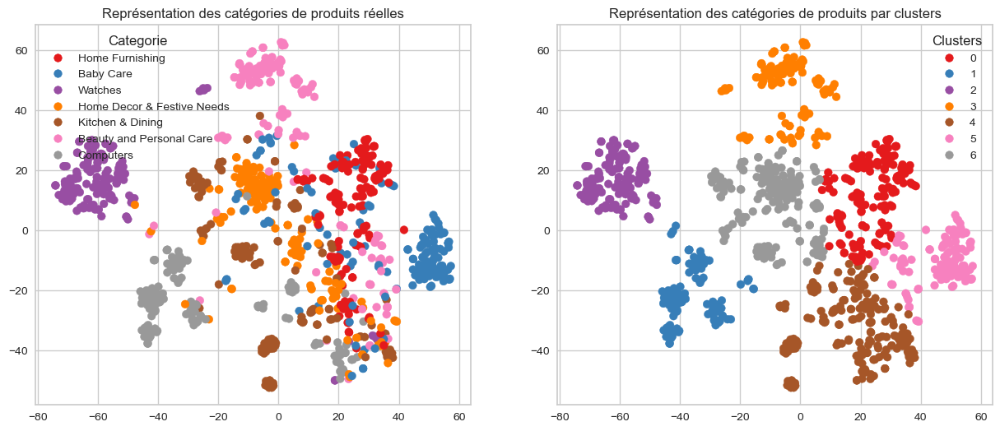

ARI :  0.4665


In [139]:
ARI, X_tsne, labels = ARI_fct(features_bert, N_CLUSTERS, y_cat_num, 20)
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [140]:
data_text['y_kmeans_transform'] = clusters_matching(y_cat_num, labels)
print(classification_report(data_text['encode_cat'], data_text['y_kmeans_transform']))

[[  0   0   0   0   0   0   0   0]
 [120   0   0   0  27   1   2   0]
 [ 29   3   0   5  12  88  13   0]
 [  0   0 137   6   7   0   0   0]
 [  3   5   1   1  37   3 100   0]
 [  6   2   0   3  68   1  70   0]
 [  4   3   0 107  10  23   3   0]
 [  0 101   0   0  48   0   1   0]]

[1 7 3 6 5 2 4 0]
              precision    recall  f1-score   support

           1       0.74      0.80      0.77       150
           2       0.76      0.59      0.66       150
           3       0.99      0.91      0.95       150
           4       0.53      0.67      0.59       150
           5       0.33      0.45      0.38       150
           6       0.88      0.71      0.79       150
           7       0.89      0.67      0.77       150

    accuracy                           0.69      1050
   macro avg       0.73      0.69      0.70      1050
weighted avg       0.73      0.69      0.70      1050



### USE

In [487]:
import tensorflow as tf
os.environ["TF_KERAS"]='1'

In [136]:
print(tf.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.9.1
Num GPUs Available:  1
False


In [137]:
#!pip install --upgrade tensorflow_hub
#!pip freeze | grep tensorflow-hub

In [141]:
import tensorflow_hub as hub

#embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")
embed = hub.load("/Users/maximedupouy/Downloads/universal-sentence-encoder_4")

2022-09-16 17:26:47.005470: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


In [142]:
def feature_USE_fct(sentences, b_size) :
    batch_size = b_size
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [143]:
batch_size = 10
sentences = data_text['description_deep_full'].to_list()

In [144]:
features_USE = feature_USE_fct(sentences, batch_size)

2022-09-16 17:26:48.145811: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


ARI :  0.6835 time :  5.0


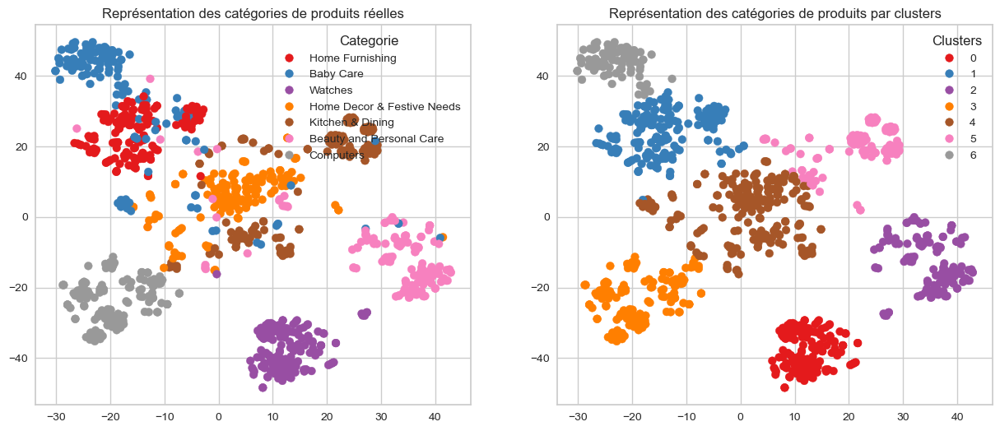

ARI :  0.6835


In [152]:
ARI, X_tsne, labels = ARI_fct(features_USE, N_CLUSTERS, y_cat_num, 40)
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [153]:
data_text['y_kmeans_transform'] = clusters_matching(y_cat_num, labels)

[[  0   0   0   0   0   0   0   0]
 [  0 149   0   0   1   0   0   0]
 [  0  32   4   0  20   2  92   0]
 [143   0   6   0   1   0   0   0]
 [  0   0   1   2 126  21   0   0]
 [  0   6   0   7  49  88   0   0]
 [  0   4 131   0  14   0   1   0]
 [  0   0   0 150   0   0   0   0]]

[3 1 6 7 4 5 2 0]


In [154]:
print(classification_report(data_text['encode_cat'], data_text['y_kmeans_transform']))

              precision    recall  f1-score   support

           1       0.78      0.99      0.87       150
           2       0.99      0.61      0.76       150
           3       1.00      0.95      0.98       150
           4       0.60      0.84      0.70       150
           5       0.79      0.59      0.67       150
           6       0.92      0.87      0.90       150
           7       0.94      1.00      0.97       150

    accuracy                           0.84      1050
   macro avg       0.86      0.84      0.84      1050
weighted avg       0.86      0.84      0.84      1050



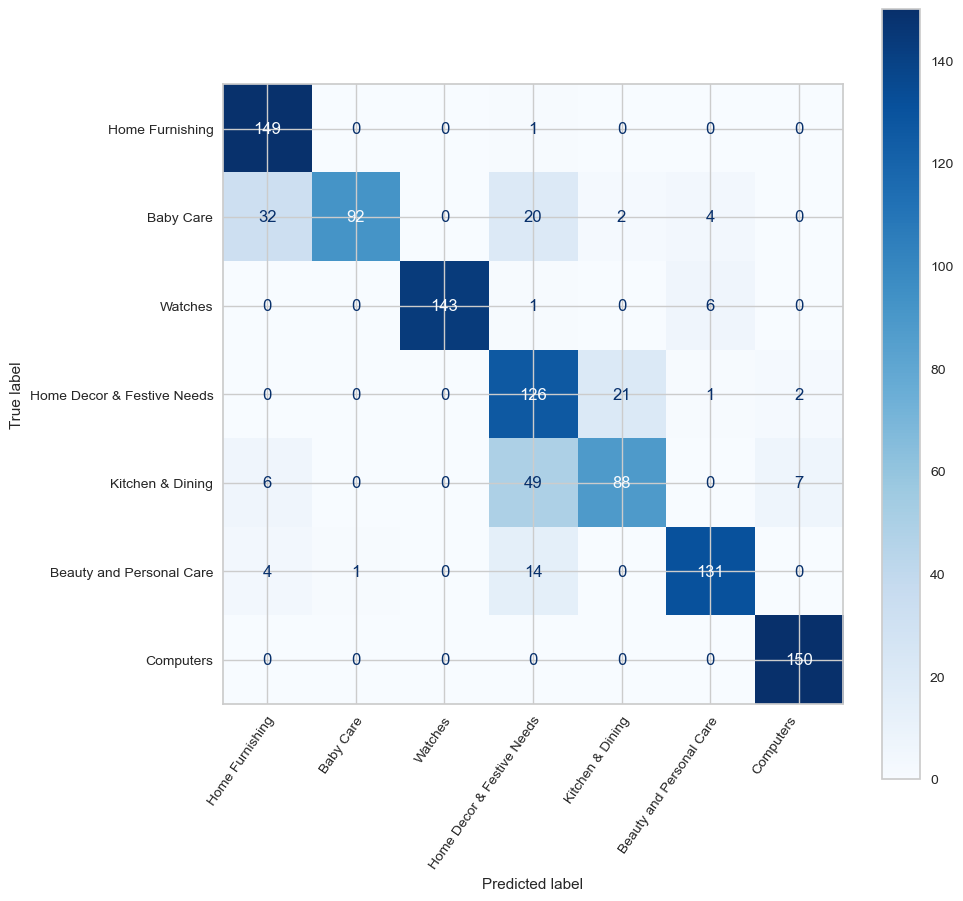

In [155]:
confusion_matrix_plot(data_text['encode_cat'],
                      data_text['y_kmeans_transform'],
                     list(data_text['product_category'].unique()))

# Image

## Preprocess

In [156]:
def get_cat(unique_id):
    return data_text[data_text['uniq_id']==unique_id]['product_category'].item()

In [157]:
data_img['product_category'] = data_img.unique_id.apply(lambda x : get_cat(x))

In [158]:
data_img.isnull().sum()

unique_id           0
img                 0
product_category    0
dtype: int64

In [159]:
data_img.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   unique_id         1050 non-null   object
 1   img               1050 non-null   object
 2   product_category  1050 non-null   object
dtypes: object(3)
memory usage: 24.7+ KB


In [160]:
data_img['product_category_encode'] = data_img['product_category'].map(encode_fast)

In [161]:
#plt.imshow(np.real(data_img[data_img.unique_id=='aa68675f50a0551b8dadb954017a50a1']['img'][0]))

In [162]:
data_img.head()

,unique_id,img,product_category,product_category_encode
0,aa68675f50a0551b8dadb954017a50a1,"[[[193, 197, 200], [193, 197, 200], [192, 196,...",Kitchen & Dining,5
1,037c2402fee39fbc80433935711d1383,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",Home Furnishing,1
2,42643c1c9403f67921a18654bcf45ead,"[[[253, 255, 254], [255, 255, 253], [255, 255,...",Baby Care,2
3,53f4bc7d7321f5c41de6b86e41f13e80,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",Home Decor & Festive Needs,4
4,b144a363c107c7bdd91f32d6e28ba6f2,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",Watches,3


## Data Explo

Beauty and Personal Care


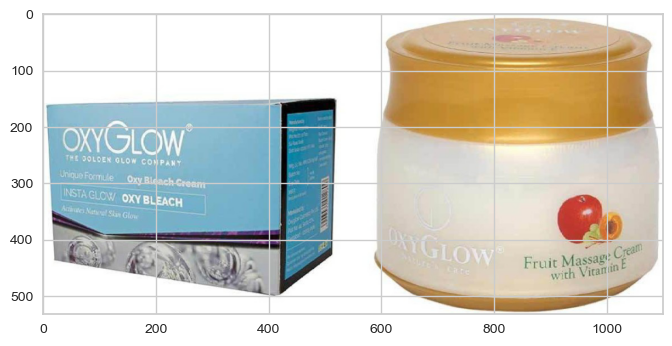

Watches


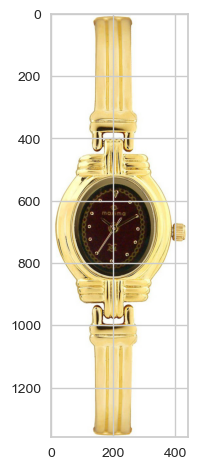

Kitchen & Dining


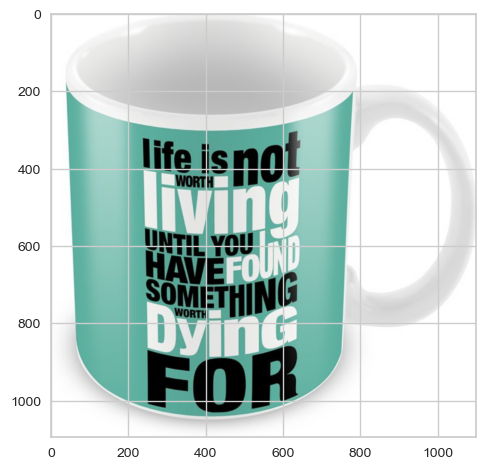

Home Decor & Festive Needs


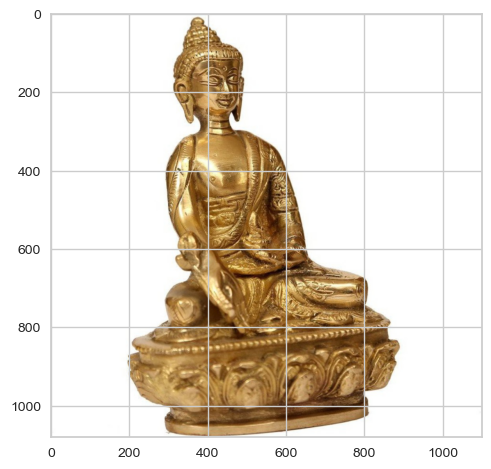

Baby Care


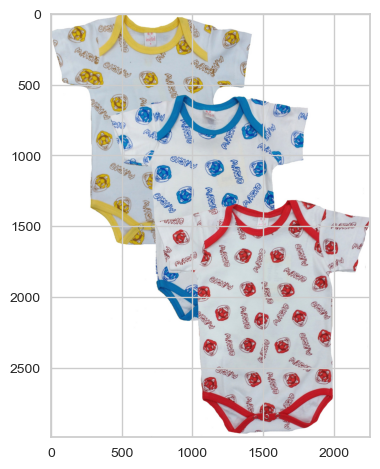

Computers


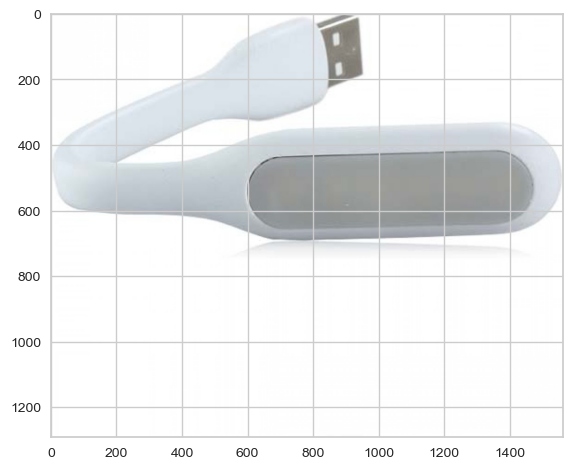

Home Furnishing


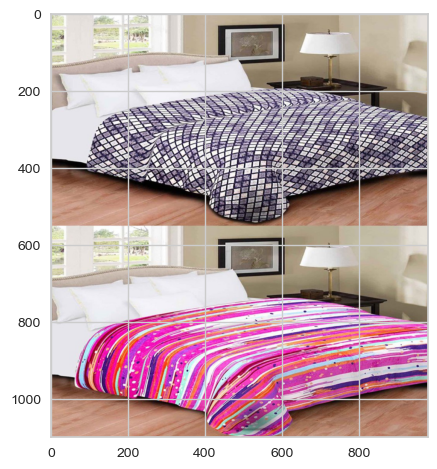

In [163]:
cat = list(data_img['product_category'].unique())
showed = []

while len(cat)>0:
    unique_id = np.random.choice(list(data_img['unique_id']))
    row = data_img[data_img.unique_id==unique_id]
    if row['product_category'].item() not in showed :
        showed.append(row['product_category'].item())
        cat.remove(row['product_category'].item())
        print(row['product_category'].item())
        plt.imshow(row['img'].item())
        plt.show()
    
#plt.imshow(data_img['img'][to_show])

In [164]:
data_img[data_img.unique_id==unique_id]['product_category'].item()

'Home Furnishing'

In [165]:
data_img['shape'] = data_img['img'].apply(lambda x : x.shape)

In [166]:
data_img['shape']

0       (1188, 3600, 3)
1        (657, 1136, 3)
2        (1184, 948, 3)
3       (1900, 2000, 3)
4         (930, 409, 3)
             ...       
1045    (1409, 1294, 3)
1046    (1100, 1000, 3)
1047    (3736, 3824, 3)
1048     (1100, 815, 3)
1049     (682, 1024, 3)
Name: shape, Length: 1050, dtype: object

In [167]:
data_img['img_horizon'] = data_img['img'].apply(lambda x : x.shape[0])
data_img['img_vert'] = data_img['img'].apply(lambda x : x.shape[1])
print('minimim img.shape[0]:', min(data_img['img_horizon']))
print('minimim img.shape[1]:', min(data_img['img_vert']))

minimim img.shape[0]: 160
minimim img.shape[1]: 145


In [168]:
data_img_ = pd.DataFrame({'unique_id' : [], 'img' : []})
a = []
b = []


In [169]:
width = 160
height = 145
dim = (width, height)


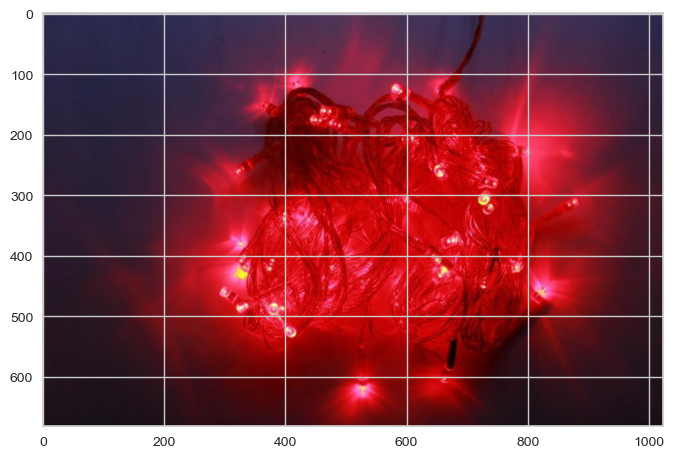

In [175]:
plt.imshow(data_img[data_img['unique_id']=='1738ddb8f47f11ff0cb96fe6cad302c2']['img'].item())


systemMemory: 8.00 GB
maxCacheSize: 2.67 GB



[ WARN:0@2890.292] global /Users/runner/miniforge3/conda-bld/libopencv_1658893788237/work/opencv_contrib/modules/xfeatures2d/misc/python/shadow_sift.hpp (15) SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


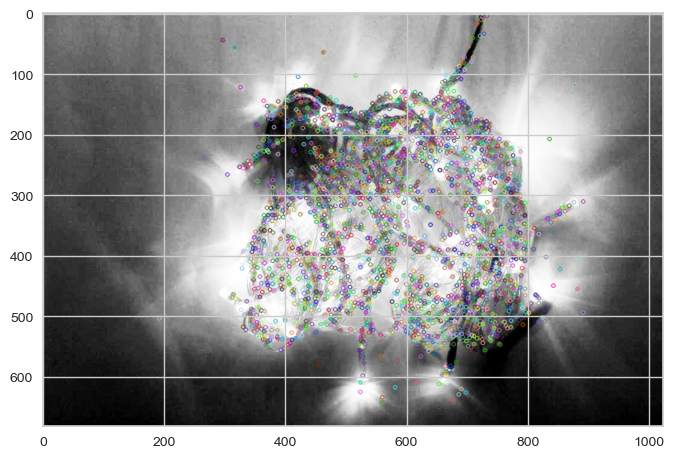

Descripteurs :  (3025, 128)

[[ 34.  12.   0. ...   0.   0.   0.]
 [ 25.  19.   0. ...   0.   0.   0.]
 [  0.   3.   9. ...   1.   2.  61.]
 ...
 [ 73.   0.   0. ...   3.  25.   6.]
 [108.  43.   0. ...   0.   1.  82.]
 [ 53.   0.   0. ...  52.   1.   1.]]


In [170]:
sift = cv2.xfeatures2d.SIFT_create()
image = cv2.imread(path_img+ '1738ddb8f47f11ff0cb96fe6cad302c2.jpg',0) # convert in gray
image = cv2.equalizeHist(image)   # equalize image histogram
kp, des = sift.detectAndCompute(image, None)
img=cv2.drawKeypoints(image,kp,image)
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)

## Sift

In [176]:
%%time

sift_keypoints = {}
temps1=time.time()
sift = cv2.xfeatures2d.SIFT_create(500)



#for image_num in range(len(list_photos)) :
for file_name in os.listdir(path_img):
    name = file_name.split('.')[0]
    image = cv2.imread(path_img + file_name,0) # convert in gray
    resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA) # resized
    # image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    res = cv2.equalizeHist(image)   # equalize image histogram
    kp, des = sift.detectAndCompute(res, None)
    sift_keypoints[name] = des


sift_keypoints_by_img = [i for i in sift_keypoints.values()]
sift_keypoints_all    = np.concatenate(sift_keypoints_by_img, axis=0)
print("Nombre de descripteurs : ", sift_keypoints_all.shape)

k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(sift_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")
y = pd.DataFrame.from_dict(sift_keypoints, orient='index')
y.reset_index(inplace=True)
y=y.rename(columns={'index':'unique_id', 0:'sift'})
y = y.merge(data_img[['unique_id', 'product_category', 'product_category_encode']])

Nombre de descripteurs :  (517351, 128)
Nombre de clusters estimés :  719
Création de 719 clusters de descripteurs ...
temps de traitement kmeans :           374.34 secondes
CPU times: user 12min 3s, sys: 3min 18s, total: 15min 21s
Wall time: 6min 14s


/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/pandas/core/internals/construction.py:576: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  values = np.array([convert(v) for v in values])


In [177]:
%%time

# Creation of histograms (features)
def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors=[]

for ind, row in y.iterrows() :
    hist = build_histogram(kmeans, row['sift'], row['unique_id']) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)




CPU times: user 18.4 s, sys: 8.71 s, total: 27.1 s
Wall time: 4.27 s


In [178]:
y['hist'] = hist_vectors
y.head()

,unique_id,sift,product_category,product_category_encode,hist
0,aa68675f50a0551b8dadb954017a50a1,"[[51.0, 9.0, 7.0, 0.0, 0.0, 0.0, 1.0, 14.0, 14...",Kitchen & Dining,5,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.01, 0.0, 0.0, 0.0,..."
1,037c2402fee39fbc80433935711d1383,"[[29.0, 27.0, 11.0, 3.0, 41.0, 49.0, 14.0, 13....",Home Furnishing,1,"[0.0, 0.0, 0.003992015968063872, 0.00199600798..."
2,42643c1c9403f67921a18654bcf45ead,"[[0.0, 16.0, 123.0, 8.0, 0.0, 0.0, 0.0, 0.0, 0...",Baby Care,2,"[0.0, 0.0, 0.002, 0.0, 0.0, 0.016, 0.0, 0.0, 0..."
3,53f4bc7d7321f5c41de6b86e41f13e80,"[[2.0, 1.0, 7.0, 4.0, 0.0, 0.0, 2.0, 3.0, 12.0...",Home Decor & Festive Needs,4,"[0.0, 0.002, 0.0, 0.002, 0.002, 0.012, 0.006, ..."
4,b144a363c107c7bdd91f32d6e28ba6f2,"[[1.0, 0.0, 24.0, 120.0, 1.0, 0.0, 0.0, 1.0, 1...",Watches,3,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.01, 0.0, 0.002, 0...."


In [179]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 719)
Dimensions dataset après réduction PCA :  (1050, 499)


In [180]:
tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
df_tsne['class'] = y.product_category

print(df_tsne.shape)


/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


(1050, 3)


In [186]:
ARI, X_tsne, labels = ARI_fct(feat_pca, 7, y['product_category_encode'], 20)

ARI :  0.0684 time :  6.0


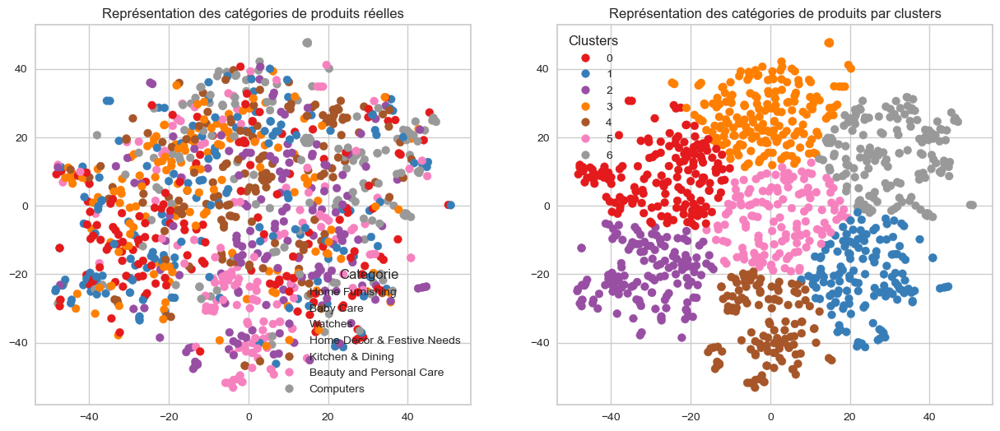

ARI :  0.0684


In [187]:
df_tsne['labels_predicted'] = labels
df_tsne['cluster'] = y['product_category_encode']
TSNE_visu_fct(X_tsne, y['product_category_encode'], labels, ARI)

In [188]:
df_tsne.groupby("labels_predicted").count()['cluster']

labels_predicted
0    160
1    141
2    137
3    190
4    123
5    139
6    160
Name: cluster, dtype: int64

In [189]:
df_tsne['cluster'].unique()

array([5, 1, 2, 4, 3, 7, 6])

In [190]:
conf_mat = metrics.confusion_matrix(labels, y['product_category_encode'])
print(conf_mat)

[[ 0 24 24 11 52 22 14 13]
 [ 0 30 18 35 14 11 17 16]
 [ 0 45 41  7 24  9  4  7]
 [ 0 16 32 19 33 32 19 39]
 [ 0  5  4 28  6  3 69  8]
 [ 0 13 13 32 14 38 19 10]
 [ 0 17 18 18  7 35  8 57]
 [ 0  0  0  0  0  0  0  0]]


In [191]:
# fait à la main
mapping = {0:4,
           1:3,
           2:1,
           3:2,
           4:6,
           5:5,
           6:7}


In [192]:
df_tsne[df_tsne['labels_predicted']==0]['cluster'].value_counts()

4    52
1    24
2    24
5    22
6    14
7    13
3    11
Name: cluster, dtype: int64

In [193]:
df_tsne['predicted_mapped']=df_tsne['labels_predicted'].map(mapping)

In [194]:
print(metrics.classification_report(df_tsne.cluster, df_tsne.predicted_mapped))

              precision    recall  f1-score   support

           1       0.33      0.30      0.31       150
           2       0.17      0.21      0.19       150
           3       0.25      0.23      0.24       150
           4       0.33      0.35      0.34       150
           5       0.27      0.25      0.26       150
           6       0.56      0.46      0.51       150
           7       0.36      0.38      0.37       150

    accuracy                           0.31      1050
   macro avg       0.32      0.31      0.32      1050
weighted avg       0.32      0.31      0.32      1050



## VGG16

In [195]:
data_img.head()

,unique_id,img,product_category,product_category_encode,shape,img_horizon,img_vert
0,aa68675f50a0551b8dadb954017a50a1,"[[[193, 197, 200], [193, 197, 200], [192, 196,...",Kitchen & Dining,5,"(1188, 3600, 3)",1188,3600
1,037c2402fee39fbc80433935711d1383,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",Home Furnishing,1,"(657, 1136, 3)",657,1136
2,42643c1c9403f67921a18654bcf45ead,"[[[253, 255, 254], [255, 255, 253], [255, 255,...",Baby Care,2,"(1184, 948, 3)",1184,948
3,53f4bc7d7321f5c41de6b86e41f13e80,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",Home Decor & Festive Needs,4,"(1900, 2000, 3)",1900,2000
4,b144a363c107c7bdd91f32d6e28ba6f2,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",Watches,3,"(930, 409, 3)",930,409


In [197]:
from tensorflow.keras.applications.vgg16 import preprocess_input 

In [235]:
data_vgg = pd.DataFrame({'unique_id' : [], 'img' : []})
a = []
b = []
for file_name in os.listdir(path_img):
    a.append(file_name.split('.')[0])
    image = cv2.imread(path_img + file_name, )
    resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA) # resized
    b.append(resized)
data_vgg['unique_id'] = a
data_vgg['img'] = b
data_vgg = data_vgg.merge(data_img[['product_category','product_category_encode', 'unique_id']], on ='unique_id')

In [236]:
print(data_vgg['img'][0].shape)
print(type(b))

(145, 160, 3)
<class 'list'>


In [237]:
'''# autre méthode mais pas de meilleurs res
from tensorflow.keras.preprocessing import image
def getFeatureVector(model, img_path):
    img = image.load_img(img_path,color_mode='rgb', target_size=(224, 224))
    img = image.img_to_array(img)
    # Adding the fouth dimension, for number of images
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    feature_vector = model.predict(img)#.reshape(1, 224, 224, 3))
    return feature_vector

feature_vector = []

for file_name in os.listdir(path_img):
    path = path_img + file_name
    feature_vector.append(getFeatureVector(model, path))'''
    

"# autre méthode mais pas de meilleurs res\nfrom tensorflow.keras.preprocessing import image\ndef getFeatureVector(model, img_path):\n    img = image.load_img(img_path,color_mode='rgb', target_size=(224, 224))\n    img = image.img_to_array(img)\n    # Adding the fouth dimension, for number of images\n    img = np.expand_dims(img, axis=0)\n    img = preprocess_input(img)\n    \n    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)\n    feature_vector = model.predict(img)#.reshape(1, 224, 224, 3))\n    return feature_vector\n\nfeature_vector = []\n\nfor file_name in os.listdir(path_img):\n    path = path_img + file_name\n    feature_vector.append(getFeatureVector(model, path))"

In [240]:
from keras.applications.inception_v3 import InceptionV3

def load_model(pretrained_model):
    if pretrained_model == 'vgg16' : 
        return VGG16(weights="imagenet", include_top=False, input_shape=data_vgg['img'][0].shape)
    elif pretrained_model == 'resnet':
        return ResNet50(weights="imagenet", include_top=False, input_shape=data_vgg['img'][0].shape)
    elif pretrained_model=='inception':
        return InceptionV3(weights="imagenet", include_top=False, input_shape=data_vgg['img'][0].shape)
    elif pretrained_model == 'efficientnet':
        return EfficientNetB0(weights="imagenet", include_top=False, input_shape=data_vgg['img'][0].shape)

model = load_model('vgg16')
model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 145, 160, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 145, 160, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 145, 160, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 72, 80, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 72, 80, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 72, 80, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 36, 40, 128)       0     

In [242]:
X = np.asarray([i for i in data_vgg['img']])

In [492]:
X.shape

(1050, 2598)

In [244]:
features_vgg = model.predict(X)

2022-09-16 18:02:27.088891: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


33/33 [==============================] - 12s 297ms/step


In [245]:
features_vgg = [feature_vgg.flatten() for feature_vgg in features_vgg]
features_vgg = np.array(features_vgg)

In [246]:
print("Nombre de descripteurs : ", features_vgg.shape)

Nombre de descripteurs :  (1050, 10240)


In [247]:
print("Dimensions dataset avant réduction PCA : ", features_vgg.shape)
pca = decomposition.PCA(n_components=0.99)
features_vgg_pca = pca.fit_transform(features_vgg)
print("Dimensions dataset après réduction PCA : ", features_vgg_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 10240)
Dimensions dataset après réduction PCA :  (1050, 904)


In [248]:
data_vgg.tail(2)

,unique_id,img,product_category,product_category_encode
1048,f54d0c5cbd8e2270742293edf9075cb1,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",Home Furnishing,1
1049,1738ddb8f47f11ff0cb96fe6cad302c2,"[[[72, 38, 38], [72, 38, 38], [73, 40, 37], [7...",Home Decor & Festive Needs,4


In [249]:
features_vgg_pca.shape

(1050, 904)

In [256]:
ARI, X_tsne, labels = ARI_fct(features_vgg, 7, data_vgg['product_category_encode'], perplexity=31)

ARI :  0.3527 time :  6.0


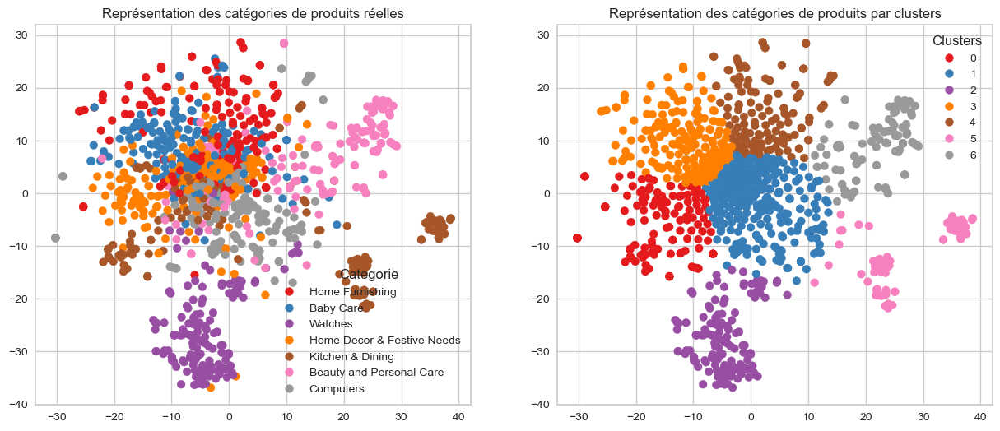

ARI :  0.3527


In [257]:
TSNE_visu_fct(X_tsne, data_vgg['product_category_encode'], labels, ARI)

[[ 0  0  0  0  0  0  0  0]
 [21 42 15 26 20 11 15  0]
 [18 40 20 31 16  6 19  0]
 [15 38 17 28 18 18 16  0]
 [18 49 19 28 15  6 15  0]
 [23 25 27 22 22 13 18  0]
 [16 38 17 22 25 17 15  0]
 [17 41 25 24 19 10 14  0]]

[5 4 5 2 6 3 2 0]
              precision    recall  f1-score   support

           1       0.00      0.00      0.00       150
           2       0.33      0.64      0.43       150
           3       0.00      0.00      0.00       150
           4       0.21      0.38      0.27       150
           5       0.15      0.26      0.19       150
           6       0.07      0.07      0.07       150
           7       0.00      0.00      0.00       150

    accuracy                           0.19      1050
   macro avg       0.11      0.19      0.14      1050
weighted avg       0.11      0.19      0.14      1050



/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/maximedupouy/miniforge3/envs/mlp/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

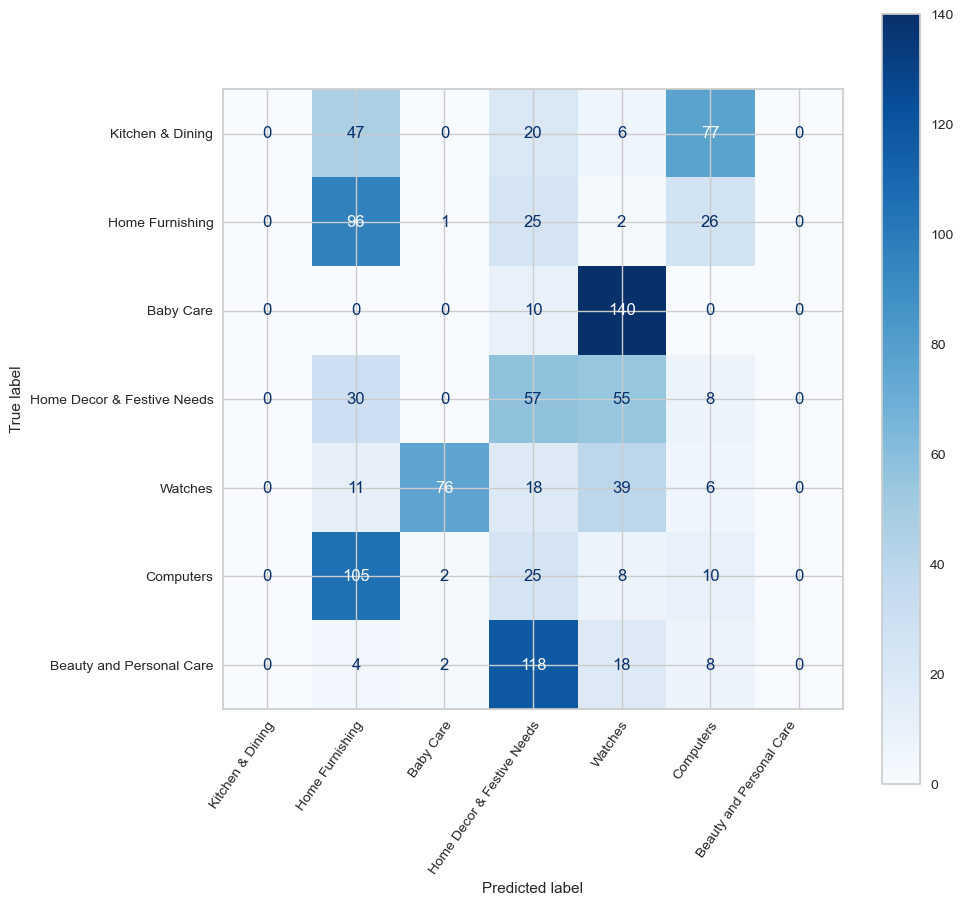

In [262]:
data_vgg['y_kmeans_transform'] = clusters_matching(y_cat_num, labels)
print(classification_report(data_vgg['product_category_encode'], data_vgg['y_kmeans_transform']))
confusion_matrix_plot(data_vgg['product_category_encode'],
                      data_vgg['y_kmeans_transform'],
                     list(data_vgg['product_category'].unique()))

## ResNet

In [263]:
# load model
model = load_model('resnet')
# summarize the model
model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 145, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 151, 166, 3)  0           ['input_9[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 73, 80, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 73, 80, 64)   256         ['conv1_conv[0][0]']      

 conv2_block3_2_conv (Conv2D)   (None, 37, 40, 64)   36928       ['conv2_block3_1_relu[0][0]']    
                                                                                                  
 conv2_block3_2_bn (BatchNormal  (None, 37, 40, 64)  256         ['conv2_block3_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_block3_2_relu (Activatio  (None, 37, 40, 64)  0           ['conv2_block3_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv2_block3_3_conv (Conv2D)   (None, 37, 40, 256)  16640       ['conv2_block3_2_relu[0][0]']    
                                                                                                  
 conv2_blo

 conv3_block3_2_conv (Conv2D)   (None, 19, 20, 128)  147584      ['conv3_block3_1_relu[0][0]']    
                                                                                                  
 conv3_block3_2_bn (BatchNormal  (None, 19, 20, 128)  512        ['conv3_block3_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block3_2_relu (Activatio  (None, 19, 20, 128)  0          ['conv3_block3_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block3_3_conv (Conv2D)   (None, 19, 20, 512)  66048       ['conv3_block3_2_relu[0][0]']    
                                                                                                  
 conv3_blo

 conv4_block2_1_relu (Activatio  (None, 10, 10, 256)  0          ['conv4_block2_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block2_2_conv (Conv2D)   (None, 10, 10, 256)  590080      ['conv4_block2_1_relu[0][0]']    
                                                                                                  
 conv4_block2_2_bn (BatchNormal  (None, 10, 10, 256)  1024       ['conv4_block2_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block2_2_relu (Activatio  (None, 10, 10, 256)  0          ['conv4_block2_2_bn[0][0]']      
 n)                                                                                               
          

                                                                                                  
 conv4_block5_1_relu (Activatio  (None, 10, 10, 256)  0          ['conv4_block5_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block5_2_conv (Conv2D)   (None, 10, 10, 256)  590080      ['conv4_block5_1_relu[0][0]']    
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, 10, 10, 256)  1024       ['conv4_block5_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, 10, 10, 256)  0          ['conv4_block5_2_bn[0][0]']      
 n)       

 conv5_block2_1_conv (Conv2D)   (None, 5, 5, 512)    1049088     ['conv5_block1_out[0][0]']       
                                                                                                  
 conv5_block2_1_bn (BatchNormal  (None, 5, 5, 512)   2048        ['conv5_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block2_1_relu (Activatio  (None, 5, 5, 512)   0           ['conv5_block2_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv5_block2_2_conv (Conv2D)   (None, 5, 5, 512)    2359808     ['conv5_block2_1_relu[0][0]']    
                                                                                                  
 conv5_blo

In [264]:
features_resnet = model.predict(X)
features_resnet = [feature_resnet.flatten() for feature_resnet in features_resnet]
features_resnet = np.array(features_resnet)
print("Nombre de descripteurs : ", features_resnet.shape)

2022-09-16 18:08:17.150650: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


33/33 [==============================] - 11s 217ms/step
Nombre de descripteurs :  (1050, 51200)


In [265]:
print("Dimensions dataset avant réduction PCA : ", features_resnet.shape)
pca = decomposition.PCA(n_components=0.99)
features_resnet_pca = pca.fit_transform(features_resnet)
print("Dimensions dataset après réduction PCA : ", features_resnet_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 51200)
Dimensions dataset après réduction PCA :  (1050, 953)


In [274]:
ARI, X_tsne, labels = ARI_fct(features_resnet, 7, data_vgg['product_category_encode'], perplexity=20)

ARI :  0.3549 time :  7.0


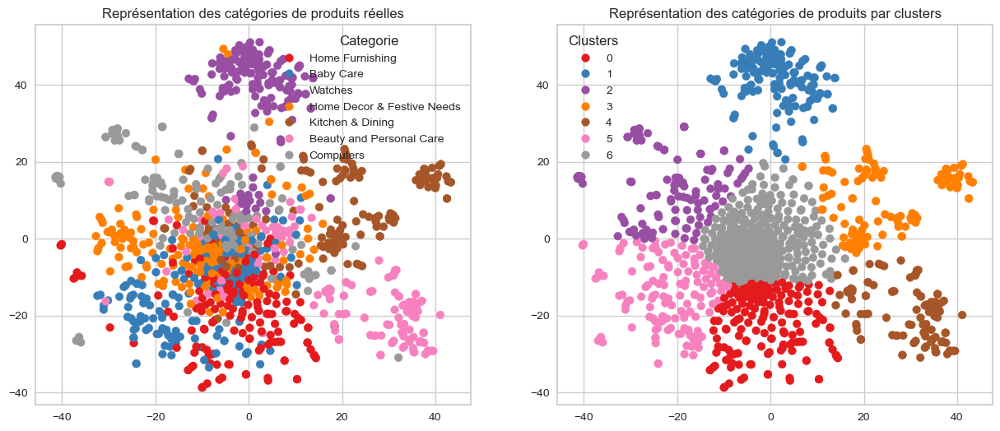

ARI :  0.3549


In [267]:
TSNE_visu_fct(X_tsne, data_vgg['product_category_encode'], labels, ARI)

In [268]:
data_vgg['y_resnet_transform'] = clusters_matching(data_vgg['product_category_encode'], labels)

[[  0   0   0   0   0   0   0   0]
 [108   0   3   0   0  18  21   0]
 [ 26   0   2   1   0  72  49   0]
 [  0 131   0   1   0   0  18   0]
 [ 13   6  30   4   0  38  59   0]
 [  2   3   8 104   6   0  27   0]
 [  4   0   6   3  98   3  36   0]
 [  2   1  73   4   4   7  59   0]]

[1 3 7 5 6 2 4 0]


In [269]:
print(classification_report(data_vgg['product_category_encode'], data_vgg['y_resnet_transform']))

              precision    recall  f1-score   support

           1       0.70      0.72      0.71       150
           2       0.52      0.48      0.50       150
           3       0.93      0.87      0.90       150
           4       0.22      0.39      0.28       150
           5       0.89      0.69      0.78       150
           6       0.91      0.65      0.76       150
           7       0.60      0.49      0.54       150

    accuracy                           0.61      1050
   macro avg       0.68      0.61      0.64      1050
weighted avg       0.68      0.61      0.64      1050



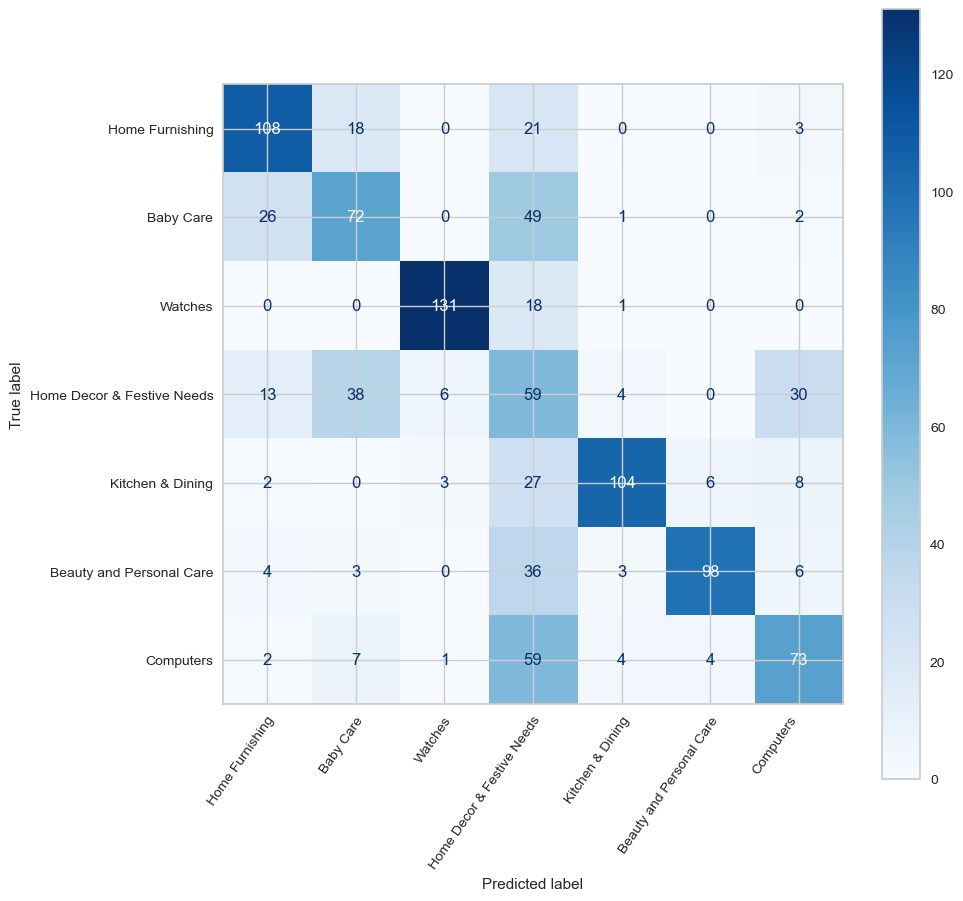

In [270]:
confusion_matrix_plot(data_vgg['product_category_encode'],
                      data_vgg['y_resnet_transform'],
                      list(data_text['product_category'].unique()))

## Inception

In [275]:
# load model
model = load_model('inception')
# summarize the model
model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 145, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 72, 79, 32)   864         ['input_10[0][0]']               
                                                                                                  
 batch_normalization (BatchNorm  (None, 72, 79, 32)  96          ['conv2d[0][0]']                 
 alization)                                                                                       
                                                                                       

 batch_normalization_10 (BatchN  (None, 15, 17, 96)  288         ['conv2d_10[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_11 (BatchN  (None, 15, 17, 32)  96          ['conv2d_11[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_5 (Activation)      (None, 15, 17, 64)   0           ['batch_normalization_5[0][0]']  
                                                                                                  
 activation_7 (Activation)      (None, 15, 17, 64)   0           ['batch_normalization_7[0][0]']  
                                                                                                  
 activatio

 conv2d_20 (Conv2D)             (None, 15, 17, 48)   13824       ['mixed1[0][0]']                 
                                                                                                  
 conv2d_23 (Conv2D)             (None, 15, 17, 96)   55296       ['activation_22[0][0]']          
                                                                                                  
 batch_normalization_20 (BatchN  (None, 15, 17, 48)  144         ['conv2d_20[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_23 (BatchN  (None, 15, 17, 96)  288         ['conv2d_23[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activatio

                                                                                                  
 conv2d_34 (Conv2D)             (None, 7, 8, 128)    98304       ['mixed3[0][0]']                 
                                                                                                  
 batch_normalization_34 (BatchN  (None, 7, 8, 128)   384         ['conv2d_34[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_34 (Activation)     (None, 7, 8, 128)    0           ['batch_normalization_34[0][0]'] 
                                                                                                  
 conv2d_35 (Conv2D)             (None, 7, 8, 128)    114688      ['activation_34[0][0]']          
                                                                                                  
 batch_nor

                                                                                                  
 activation_44 (Activation)     (None, 7, 8, 160)    0           ['batch_normalization_44[0][0]'] 
                                                                                                  
 conv2d_45 (Conv2D)             (None, 7, 8, 160)    179200      ['activation_44[0][0]']          
                                                                                                  
 batch_normalization_45 (BatchN  (None, 7, 8, 160)   480         ['conv2d_45[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_45 (Activation)     (None, 7, 8, 160)    0           ['batch_normalization_45[0][0]'] 
                                                                                                  
 conv2d_41

 batch_normalization_55 (BatchN  (None, 7, 8, 160)   480         ['conv2d_55[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_55 (Activation)     (None, 7, 8, 160)    0           ['batch_normalization_55[0][0]'] 
                                                                                                  
 conv2d_51 (Conv2D)             (None, 7, 8, 160)    122880      ['mixed5[0][0]']                 
                                                                                                  
 conv2d_56 (Conv2D)             (None, 7, 8, 160)    179200      ['activation_55[0][0]']          
                                                                                                  
 batch_normalization_51 (BatchN  (None, 7, 8, 160)   480         ['conv2d_51[0][0]']              
 ormalizat

 conv2d_61 (Conv2D)             (None, 7, 8, 192)    147456      ['mixed6[0][0]']                 
                                                                                                  
 conv2d_66 (Conv2D)             (None, 7, 8, 192)    258048      ['activation_65[0][0]']          
                                                                                                  
 batch_normalization_61 (BatchN  (None, 7, 8, 192)   576         ['conv2d_61[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_66 (BatchN  (None, 7, 8, 192)   576         ['conv2d_66[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activatio

 ormalization)                                                                                    
                                                                                                  
 batch_normalization_74 (BatchN  (None, 7, 8, 192)   576         ['conv2d_74[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_70 (Activation)     (None, 7, 8, 192)    0           ['batch_normalization_70[0][0]'] 
                                                                                                  
 activation_74 (Activation)     (None, 7, 8, 192)    0           ['batch_normalization_74[0][0]'] 
                                                                                                  
 conv2d_71 (Conv2D)             (None, 3, 3, 320)    552960      ['activation_70[0][0]']          
          

                                                                                                  
 activation_82 (Activation)     (None, 3, 3, 384)    0           ['batch_normalization_82[0][0]'] 
                                                                                                  
 activation_83 (Activation)     (None, 3, 3, 384)    0           ['batch_normalization_83[0][0]'] 
                                                                                                  
 batch_normalization_84 (BatchN  (None, 3, 3, 192)   576         ['conv2d_84[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_76 (Activation)     (None, 3, 3, 320)    0           ['batch_normalization_76[0][0]'] 
                                                                                                  
 mixed9_0 

 ormalization)                                                                                    
                                                                                                  
 activation_85 (Activation)     (None, 3, 3, 320)    0           ['batch_normalization_85[0][0]'] 
                                                                                                  
 mixed9_1 (Concatenate)         (None, 3, 3, 768)    0           ['activation_87[0][0]',          
                                                                  'activation_88[0][0]']          
                                                                                                  
 concatenate_1 (Concatenate)    (None, 3, 3, 768)    0           ['activation_91[0][0]',          
                                                                  'activation_92[0][0]']          
                                                                                                  
 activatio

In [276]:
features_inception = model.predict(X)
features_inception = [feature_inception.flatten() for feature_inception in features_inception]
features_inception = np.array(features_inception)
print("Nombre de descripteurs : ", features_inception.shape)

2022-09-16 18:09:59.452792: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


33/33 [==============================] - 5s 114ms/step
Nombre de descripteurs :  (1050, 18432)


In [277]:
print("Dimensions dataset avant réduction PCA : ", features_inception.shape)
pca = decomposition.PCA(n_components=0.99)
features_inception_pca = pca.fit_transform(features_inception)
print("Dimensions dataset après réduction PCA : ", features_inception_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 18432)
Dimensions dataset après réduction PCA :  (1050, 652)


In [278]:
ARI, X_tsne, labels = ARI_fct(features_inception_pca, 7, data_vgg['product_category_encode'], perplexity=20)

ARI :  0.0407 time :  5.0


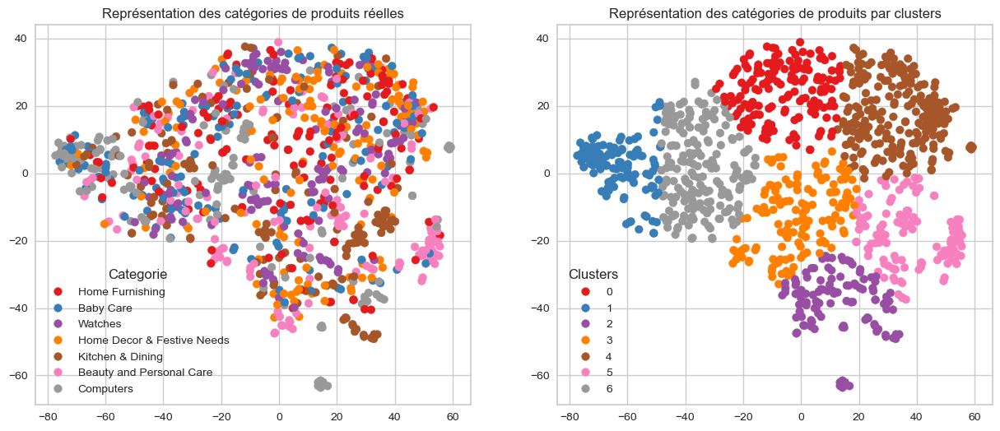

ARI :  0.0407


In [279]:
TSNE_visu_fct(X_tsne, data_vgg['product_category_encode'], labels, ARI)

## EfficientNet

In [292]:
# load model
model = load_model('efficientnet')
# summarize the model
model.summary()

Model: "efficientnetb0"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 145, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_1 (Rescaling)        (None, 145, 160, 3)  0           ['input_12[0][0]']               
                                                                                                  
 normalization_1 (Normalization  (None, 145, 160, 3)  7          ['rescaling_1[0][0]']            
 )                                                                                                
                                                                                     

                                                                                                  
 block2b_expand_conv (Conv2D)   (None, 37, 40, 144)  3456        ['block2a_project_bn[0][0]']     
                                                                                                  
 block2b_expand_bn (BatchNormal  (None, 37, 40, 144)  576        ['block2b_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block2b_expand_activation (Act  (None, 37, 40, 144)  0          ['block2b_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block2b_dwconv (DepthwiseConv2  (None, 37, 40, 144)  1296       ['block2b_expand_activation[0][0]
 D)       

 ivation)                                                                                         
                                                                                                  
 block3b_dwconv (DepthwiseConv2  (None, 19, 20, 240)  6000       ['block3b_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block3b_bn (BatchNormalization  (None, 19, 20, 240)  960        ['block3b_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block3b_activation (Activation  (None, 19, 20, 240)  0          ['block3b_bn[0][0]']             
 )                                                                                                
          

                                                                                                  
 block4b_activation (Activation  (None, 10, 10, 480)  0          ['block4b_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block4b_se_squeeze (GlobalAver  (None, 480)         0           ['block4b_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block4b_se_reshape (Reshape)   (None, 1, 1, 480)    0           ['block4b_se_squeeze[0][0]']     
                                                                                                  
 block4b_se_reduce (Conv2D)     (None, 1, 1, 20)     9620        ['block4b_se_reshape[0][0]']     
          

 agePooling2D)                                                                                    
                                                                                                  
 block5a_se_reshape (Reshape)   (None, 1, 1, 480)    0           ['block5a_se_squeeze[0][0]']     
                                                                                                  
 block5a_se_reduce (Conv2D)     (None, 1, 1, 20)     9620        ['block5a_se_reshape[0][0]']     
                                                                                                  
 block5a_se_expand (Conv2D)     (None, 1, 1, 480)    10080       ['block5a_se_reduce[0][0]']      
                                                                                                  
 block5a_se_excite (Multiply)   (None, 10, 10, 480)  0           ['block5a_activation[0][0]',     
                                                                  'block5a_se_expand[0][0]']      
          

                                                                                                  
 block5c_project_conv (Conv2D)  (None, 10, 10, 112)  75264       ['block5c_se_excite[0][0]']      
                                                                                                  
 block5c_project_bn (BatchNorma  (None, 10, 10, 112)  448        ['block5c_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5c_drop (Dropout)         (None, 10, 10, 112)  0           ['block5c_project_bn[0][0]']     
                                                                                                  
 block5c_add (Add)              (None, 10, 10, 112)  0           ['block5c_drop[0][0]',           
                                                                  'block5b_add[0][0]']            
          

                                                                                                  
 block6b_add (Add)              (None, 5, 5, 192)    0           ['block6b_drop[0][0]',           
                                                                  'block6a_project_bn[0][0]']     
                                                                                                  
 block6c_expand_conv (Conv2D)   (None, 5, 5, 1152)   221184      ['block6b_add[0][0]']            
                                                                                                  
 block6c_expand_bn (BatchNormal  (None, 5, 5, 1152)  4608        ['block6c_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block6c_expand_activation (Act  (None, 5, 5, 1152)  0           ['block6c_expand_bn[0][0]']      
 ivation) 

                                                                                                  
 block7a_expand_bn (BatchNormal  (None, 5, 5, 1152)  4608        ['block7a_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block7a_expand_activation (Act  (None, 5, 5, 1152)  0           ['block7a_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block7a_dwconv (DepthwiseConv2  (None, 5, 5, 1152)  10368       ['block7a_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block7a_b

In [320]:
features_efficientnet = model.predict(X)


33/33 [==============================] - 6s 145ms/step


In [300]:
dim

(160, 145)

In [321]:
features_efficientnet = [feature_efficientnet.flatten() for feature_efficientnet in features_efficientnet]
features_efficientnet = np.array(features_efficientnet)
print("Nombre de descripteurs : ", features_efficientnet.shape)

Nombre de descripteurs :  (1050, 32000)


In [324]:
print("Dimensions dataset avant réduction PCA : ", features_efficientnet.shape)
pca = decomposition.PCA(n_components=0.99)
features_efficientnet_pca = pca.fit_transform(features_efficientnet)
print("Dimensions dataset après réduction PCA : ", features_efficientnet_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 32000)
Dimensions dataset après réduction PCA :  (1050, 939)


In [289]:
ARI, X_tsne, labels = ARI_fct(features_efficientnet, 7, data_vgg['product_category_encode'], perplexity=30)

ARI :  0.3724 time :  6.0


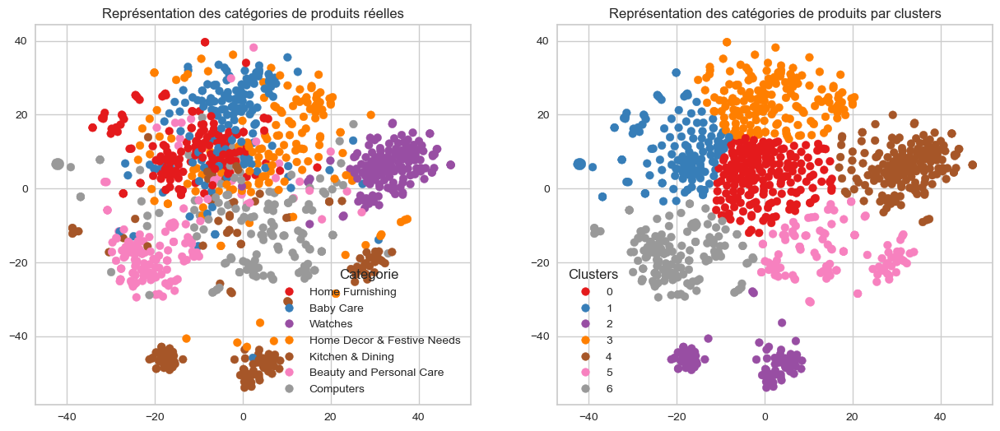

ARI :  0.3724


In [290]:
TSNE_visu_fct(X_tsne, data_vgg['product_category_encode'], labels, ARI)

[[  0   0   0   0   0   0   0   0]
 [ 39  87   0  23   1   0   0   0]
 [ 29  16   1  94   3   1   6   0]
 [  4   0   0   0 143   3   0   0]
 [ 49  15   5  54  16   7   4   0]
 [ 19   1  81   0   1  36  12   0]
 [ 14  10   0   3   3   1 119   0]
 [ 38  17   0   1   9  68  17   0]]

[4 1 5 2 3 7 6 0]
              precision    recall  f1-score   support

           1       0.60      0.58      0.59       150
           2       0.54      0.63      0.58       150
           3       0.81      0.95      0.88       150
           4       0.26      0.33      0.29       150
           5       0.93      0.54      0.68       150
           6       0.75      0.79      0.77       150
           7       0.59      0.45      0.51       150

    accuracy                           0.61      1050
   macro avg       0.64      0.61      0.61      1050
weighted avg       0.64      0.61      0.61      1050



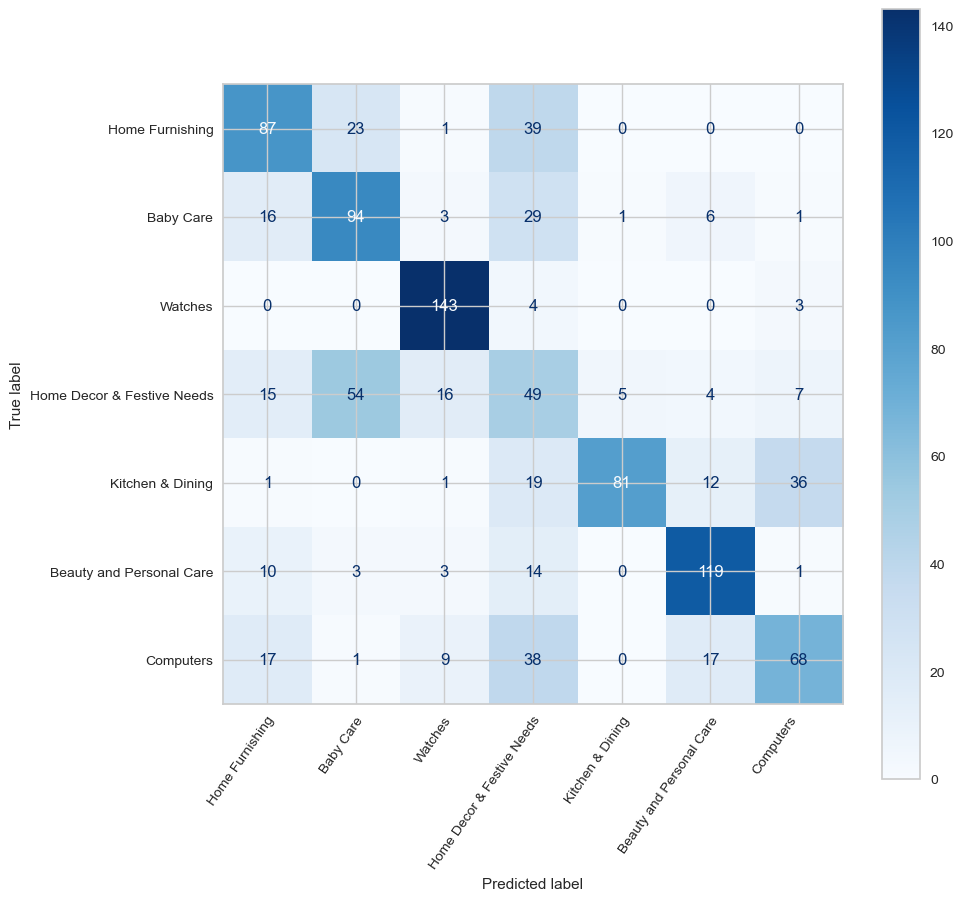

In [291]:
data_vgg['y_efficientnet_transform'] = clusters_matching(data_vgg['product_category_encode'], labels)
print(classification_report(data_vgg['product_category_encode'], data_vgg['y_efficientnet_transform']))
confusion_matrix_plot(data_vgg['product_category_encode'],
                      data_vgg['y_efficientnet_transform'],
                      list(data_text['product_category'].unique()))

## Features extraction with Transformers

Echec de cette partie : permet pas d'extraire de features simples -> demande trop de mémoire

source : https://github.com/NielsRogge/Transformers-Tutorials/blob/master/DETR/DETR_minimal_example_(with_DetrFeatureExtractor).ipynb
https://github.com/NielsRogge/Transformers-Tutorials/blob/master/DETR/DETR_panoptic_segmentation_minimal_example_(with_DetrFeatureExtractor).ipynb

In [53]:
data_transformers = data_vgg.copy()

In [55]:
from transformers import DetrForSegmentation
import torch


try_hard_transformers = False
if try_hard_transformers :
    feature_extractor = DetrFeatureExtractor.from_pretrained("facebook/detr-resnet-50-panoptic")

    model = DetrForSegmentation.from_pretrained("facebook/detr-resnet-50-panoptic")


    features = []
    for img in tqdm(data_transformers['img']):
        encoding = feature_extractor(img, return_tensors="pt")
        outputs = model(**encoding)
        #dec_attn_weights = outputs.cross_attentions[-1]
        #dec_attn_weights = torch.mean(dec_attn_weights, dim=1).detach()
        features.append(outputs.pred_masks.detach().numpy())
    data_transformers['DETR'] = features
    processed_sizes = torch.as_tensor(data_transformers['img'][0].shape[-2:]).unsqueeze(0)
    result = feature_extractor.post_process_panoptic(tf.convert_to_tensor(data_transformers['DETR'][0]), processed_sizes)[0]

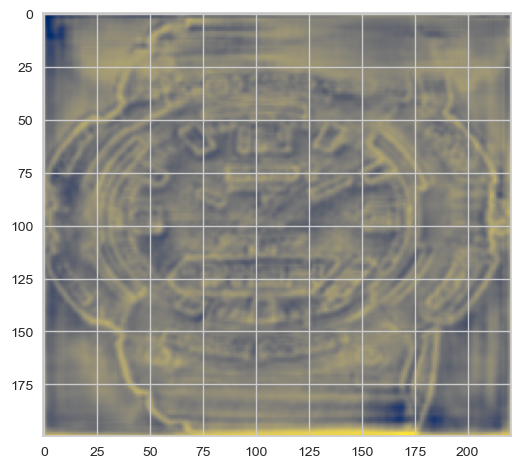

In [114]:
plt.imshow(data_transformers['DETR'][1000][0][2], cmap="cividis")

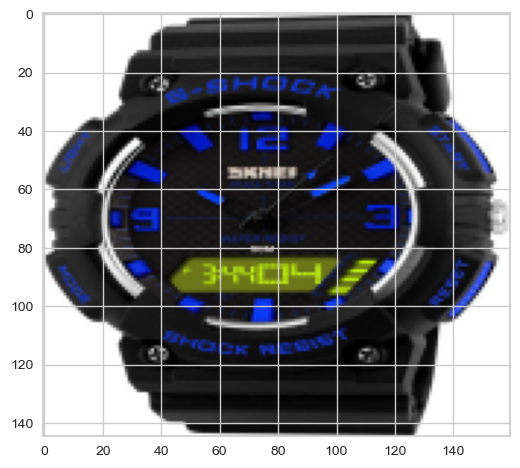

In [124]:
plt.imshow(data_transformers['img'][1000])

## Effcient net V2

In [541]:


m = tf.keras.Sequential([
    hub.KerasLayer("https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b0/feature_vector/2",
                   trainable=False),  # Can be True, see below.
    #tf.keras.layers.Dense(num_classes, activation='softmax')
])

In [523]:
i = tf.image.convert_image_dtype(
    i, tf.float32, saturate=False, name=None
)

In [524]:
i.shape

TensorShape([1, 224, 224, 3])

In [507]:
data_vgg.sample(1)

,unique_id,img,product_category,product_category_encode,y_kmeans_transform,y_resnet_transform,y_efficientnet_transform,features_efficientnet_pca
387,fc59187b2e011cf098ce420a0ee02e10,"[[[10, 10, 26], [9, 10, 26], [8, 11, 26], [10,...",Home Furnishing,1,6,1,1,"[-11.755028, -12.746447, -12.215624, -11.85841..."


In [529]:
data_efficient= pd.DataFrame({'unique_id' : [], 'img' : []})
a = []
b = []
for file_name in os.listdir(path_img):
    a.append(file_name.split('.')[0])
    image = cv2.imread(path_img + file_name, )
    resized = cv2.resize(image, (224,224), interpolation = cv2.INTER_AREA) # resized
    resized=resized.reshape(1, 224, 224, 3)
    resized = tf.image.convert_image_dtype(
        resized, tf.float32, saturate=False, name=None)
    b.append(resized)
data_efficient['unique_id'] = a
data_efficient['img'] = b
data_efficient = data_efficient.merge(data_img[['product_category','product_category_encode', 'unique_id']], on ='unique_id')

In [536]:

data_efficient['efficient_v2_features'] = data_efficient['img'].progress_apply(lambda x : m.predict(x))


  0%|                                                  | 0/1050 [00:00<?, ?it/s]

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
1/1 [==============================] - 1s 512ms/step


  0%|                                          | 2/1050 [00:00<06:48,  2.57it/s]

1/1 [==============================] - 0s 72ms/step


  0%|▏                                         | 4/1050 [00:00<03:42,  4.69it/s]

1/1 [==============================] - 0s 39ms/step


  1%|▏                                         | 6/1050 [00:01<02:30,  6.95it/s]

1/1 [==============================] - 0s 36ms/step


  1%|▎                                         | 8/1050 [00:01<01:55,  9.05it/s]

1/1 [==============================] - 0s 32ms/step


  1%|▍                                        | 11/1050 [00:01<01:22, 12.59it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▌                                        | 14/1050 [00:01<01:06, 15.65it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▋                                        | 17/1050 [00:01<00:56, 18.12it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▊                                        | 20/1050 [00:01<00:51, 19.94it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▉                                        | 23/1050 [00:01<00:47, 21.74it/s]

1/1 [==============================] - 0s 26ms/step


  2%|█                                        | 26/1050 [00:01<00:44, 22.92it/s]

1/1 [==============================] - 0s 25ms/step


  3%|█▏                                       | 29/1050 [00:02<00:43, 23.29it/s]

1/1 [==============================] - 0s 25ms/step


  3%|█▏                                       | 32/1050 [00:02<00:42, 24.21it/s]

1/1 [==============================] - 0s 31ms/step


  3%|█▎                                       | 35/1050 [00:02<00:47, 21.16it/s]

1/1 [==============================] - 0s 26ms/step


  4%|█▍                                       | 38/1050 [00:02<00:45, 22.42it/s]

1/1 [==============================] - 0s 26ms/step


  4%|█▌                                       | 41/1050 [00:02<00:43, 23.45it/s]

1/1 [==============================] - 0s 25ms/step


  4%|█▋                                       | 44/1050 [00:02<00:41, 24.04it/s]

1/1 [==============================] - 0s 27ms/step


  4%|█▊                                       | 47/1050 [00:02<00:40, 24.60it/s]

1/1 [==============================] - 0s 25ms/step


  5%|█▉                                       | 50/1050 [00:02<00:39, 25.05it/s]

1/1 [==============================] - 0s 26ms/step


  5%|██                                       | 53/1050 [00:03<00:39, 25.27it/s]

1/1 [==============================] - 0s 27ms/step


  5%|██▏                                      | 56/1050 [00:03<00:38, 25.69it/s]

1/1 [==============================] - 0s 24ms/step


  6%|██▎                                      | 59/1050 [00:03<00:38, 25.98it/s]

1/1 [==============================] - 0s 25ms/step


  6%|██▍                                      | 62/1050 [00:03<00:37, 26.36it/s]

1/1 [==============================] - 0s 25ms/step


  6%|██▌                                      | 65/1050 [00:03<00:37, 26.53it/s]

1/1 [==============================] - 0s 27ms/step


  6%|██▋                                      | 68/1050 [00:03<00:37, 26.12it/s]

1/1 [==============================] - 0s 26ms/step


  7%|██▊                                      | 71/1050 [00:03<00:37, 26.35it/s]

1/1 [==============================] - 0s 26ms/step


  7%|██▉                                      | 74/1050 [00:03<00:36, 26.73it/s]

1/1 [==============================] - 0s 24ms/step


  7%|███                                      | 77/1050 [00:03<00:36, 27.03it/s]

1/1 [==============================] - 0s 24ms/step


  8%|███                                      | 80/1050 [00:04<00:35, 27.03it/s]

1/1 [==============================] - 0s 24ms/step


  8%|███▏                                     | 83/1050 [00:04<00:35, 27.17it/s]

1/1 [==============================] - 0s 32ms/step


  8%|███▎                                     | 86/1050 [00:04<00:35, 27.06it/s]

1/1 [==============================] - 0s 25ms/step


  8%|███▍                                     | 89/1050 [00:04<00:36, 26.53it/s]

1/1 [==============================] - 0s 25ms/step


  9%|███▌                                     | 92/1050 [00:04<00:35, 26.99it/s]

1/1 [==============================] - 0s 25ms/step


  9%|███▋                                     | 95/1050 [00:04<00:36, 26.36it/s]

1/1 [==============================] - 0s 25ms/step


  9%|███▊                                     | 98/1050 [00:04<00:35, 26.47it/s]

1/1 [==============================] - 0s 25ms/step


 10%|███▊                                    | 101/1050 [00:04<00:35, 26.60it/s]

1/1 [==============================] - 0s 25ms/step


 10%|███▉                                    | 104/1050 [00:04<00:34, 27.12it/s]

1/1 [==============================] - 0s 27ms/step


 10%|████                                    | 107/1050 [00:05<00:35, 26.73it/s]

1/1 [==============================] - 0s 24ms/step


 10%|████▏                                   | 110/1050 [00:05<00:34, 26.90it/s]

1/1 [==============================] - 0s 25ms/step


 11%|████▎                                   | 113/1050 [00:05<00:34, 26.95it/s]

1/1 [==============================] - 0s 25ms/step


 11%|████▍                                   | 116/1050 [00:05<00:34, 27.09it/s]

1/1 [==============================] - 0s 24ms/step


 11%|████▌                                   | 119/1050 [00:05<00:34, 27.10it/s]

1/1 [==============================] - 0s 24ms/step


 12%|████▋                                   | 122/1050 [00:05<00:33, 27.39it/s]

1/1 [==============================] - 0s 24ms/step


 12%|████▊                                   | 125/1050 [00:05<00:33, 27.63it/s]

1/1 [==============================] - 0s 25ms/step


 12%|████▉                                   | 128/1050 [00:05<00:33, 27.54it/s]

1/1 [==============================] - 0s 25ms/step


 12%|████▉                                   | 131/1050 [00:05<00:33, 27.47it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█████                                   | 134/1050 [00:06<00:33, 27.05it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█████▏                                  | 137/1050 [00:06<00:33, 27.43it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█████▎                                  | 140/1050 [00:06<00:32, 27.62it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█████▍                                  | 143/1050 [00:06<00:32, 27.64it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█████▌                                  | 146/1050 [00:06<00:32, 27.46it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█████▋                                  | 149/1050 [00:06<00:33, 27.04it/s]

1/1 [==============================] - 0s 39ms/step


 14%|█████▊                                  | 152/1050 [00:06<00:47, 19.03it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█████▉                                  | 155/1050 [00:07<00:47, 19.01it/s]

1/1 [==============================] - 0s 25ms/step


 15%|██████                                  | 158/1050 [00:07<00:42, 20.90it/s]

1/1 [==============================] - 0s 28ms/step


 15%|██████▏                                 | 161/1050 [00:07<00:40, 22.11it/s]

1/1 [==============================] - 0s 25ms/step


 16%|██████▏                                 | 164/1050 [00:07<00:37, 23.42it/s]

1/1 [==============================] - 0s 24ms/step


 16%|██████▎                                 | 167/1050 [00:07<00:36, 24.51it/s]

1/1 [==============================] - 0s 23ms/step


 16%|██████▍                                 | 170/1050 [00:07<00:35, 24.95it/s]

1/1 [==============================] - 0s 28ms/step


 16%|██████▌                                 | 173/1050 [00:07<00:34, 25.50it/s]

1/1 [==============================] - 0s 25ms/step


 17%|██████▋                                 | 176/1050 [00:07<00:33, 26.25it/s]

1/1 [==============================] - 0s 25ms/step


 17%|██████▊                                 | 179/1050 [00:07<00:32, 26.66it/s]

1/1 [==============================] - 0s 27ms/step


 17%|██████▉                                 | 182/1050 [00:08<00:32, 26.64it/s]

1/1 [==============================] - 0s 24ms/step


 18%|███████                                 | 185/1050 [00:08<00:32, 26.46it/s]

1/1 [==============================] - 0s 25ms/step


 18%|███████▏                                | 188/1050 [00:08<00:32, 26.53it/s]

1/1 [==============================] - 0s 25ms/step


 18%|███████▎                                | 191/1050 [00:08<00:32, 26.30it/s]

1/1 [==============================] - 0s 25ms/step


 18%|███████▍                                | 194/1050 [00:08<00:32, 26.65it/s]

1/1 [==============================] - 0s 26ms/step


 19%|███████▌                                | 197/1050 [00:08<00:31, 26.72it/s]

1/1 [==============================] - 0s 24ms/step


 19%|███████▌                                | 200/1050 [00:08<00:31, 26.76it/s]

1/1 [==============================] - 0s 25ms/step


 19%|███████▋                                | 203/1050 [00:08<00:31, 26.99it/s]

1/1 [==============================] - 0s 26ms/step


 20%|███████▊                                | 206/1050 [00:08<00:31, 26.59it/s]

1/1 [==============================] - 0s 25ms/step


 20%|███████▉                                | 209/1050 [00:09<00:31, 26.82it/s]

1/1 [==============================] - 0s 24ms/step


 20%|████████                                | 212/1050 [00:09<00:31, 26.75it/s]

1/1 [==============================] - 0s 25ms/step


 20%|████████▏                               | 215/1050 [00:09<00:30, 26.96it/s]

1/1 [==============================] - 0s 26ms/step


 21%|████████▎                               | 218/1050 [00:09<00:31, 26.83it/s]

1/1 [==============================] - 0s 25ms/step


 21%|████████▍                               | 221/1050 [00:09<00:31, 26.53it/s]

1/1 [==============================] - 0s 27ms/step


 21%|████████▌                               | 224/1050 [00:09<00:31, 26.50it/s]

1/1 [==============================] - 0s 26ms/step


 22%|████████▋                               | 227/1050 [00:09<00:31, 25.97it/s]

1/1 [==============================] - 0s 26ms/step


 22%|████████▊                               | 230/1050 [00:09<00:31, 26.42it/s]

1/1 [==============================] - 0s 25ms/step


 22%|████████▉                               | 233/1050 [00:09<00:30, 26.62it/s]

1/1 [==============================] - 0s 27ms/step


 22%|████████▉                               | 236/1050 [00:10<00:30, 26.88it/s]

1/1 [==============================] - 0s 25ms/step


 23%|█████████                               | 239/1050 [00:10<00:29, 27.07it/s]

1/1 [==============================] - 0s 28ms/step


 23%|█████████▏                              | 242/1050 [00:10<00:30, 26.62it/s]

1/1 [==============================] - 0s 25ms/step


 23%|█████████▎                              | 245/1050 [00:10<00:31, 25.80it/s]

1/1 [==============================] - 0s 25ms/step


 24%|█████████▍                              | 248/1050 [00:10<00:30, 26.28it/s]

1/1 [==============================] - 0s 26ms/step


 24%|█████████▌                              | 251/1050 [00:10<00:30, 26.33it/s]

1/1 [==============================] - 0s 25ms/step


 24%|█████████▋                              | 254/1050 [00:10<00:29, 26.57it/s]

1/1 [==============================] - 0s 26ms/step


 24%|█████████▊                              | 257/1050 [00:10<00:29, 26.61it/s]

1/1 [==============================] - 0s 26ms/step


 25%|█████████▉                              | 260/1050 [00:10<00:29, 26.93it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██████████                              | 263/1050 [00:11<00:28, 27.31it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██████████▏                             | 266/1050 [00:11<00:28, 27.50it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██████████▏                             | 269/1050 [00:11<00:28, 27.47it/s]

1/1 [==============================] - 0s 171ms/step


 26%|██████████▎                             | 272/1050 [00:13<03:41,  3.51it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██████████▍                             | 274/1050 [00:13<03:00,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██████████▌                             | 277/1050 [00:14<02:12,  5.84it/s]

1/1 [==============================] - 0s 89ms/step


 27%|██████████▋                             | 280/1050 [00:14<01:44,  7.38it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██████████▋                             | 282/1050 [00:14<01:29,  8.59it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██████████▊                             | 285/1050 [00:14<01:08, 11.11it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██████████▉                             | 288/1050 [00:14<00:55, 13.65it/s]

1/1 [==============================] - 0s 25ms/step


 28%|███████████                             | 291/1050 [00:14<00:46, 16.21it/s]

1/1 [==============================] - 0s 24ms/step


 28%|███████████▏                            | 294/1050 [00:14<00:40, 18.70it/s]

1/1 [==============================] - 0s 26ms/step


 28%|███████████▎                            | 297/1050 [00:14<00:36, 20.65it/s]

1/1 [==============================] - 0s 24ms/step


 29%|███████████▍                            | 300/1050 [00:15<00:33, 22.60it/s]

1/1 [==============================] - 0s 26ms/step


 29%|███████████▌                            | 303/1050 [00:15<00:31, 23.35it/s]

1/1 [==============================] - 0s 26ms/step


 29%|███████████▋                            | 306/1050 [00:15<00:31, 23.92it/s]

1/1 [==============================] - 0s 28ms/step


 29%|███████████▊                            | 309/1050 [00:15<00:33, 22.27it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███████████▉                            | 312/1050 [00:15<00:44, 16.53it/s]

1/1 [==============================] - 0s 26ms/step


 30%|████████████                            | 315/1050 [00:15<00:39, 18.80it/s]

1/1 [==============================] - 0s 26ms/step


 30%|████████████                            | 318/1050 [00:15<00:35, 20.47it/s]

1/1 [==============================] - 0s 25ms/step


 31%|████████████▏                           | 321/1050 [00:16<00:33, 22.06it/s]

1/1 [==============================] - 0s 28ms/step


 31%|████████████▎                           | 324/1050 [00:16<00:31, 23.20it/s]

1/1 [==============================] - 0s 25ms/step


 31%|████████████▍                           | 327/1050 [00:16<00:30, 24.06it/s]

1/1 [==============================] - 0s 25ms/step


 31%|████████████▌                           | 330/1050 [00:16<00:28, 25.32it/s]

1/1 [==============================] - 0s 25ms/step


 32%|████████████▋                           | 333/1050 [00:16<00:27, 25.75it/s]

1/1 [==============================] - 0s 25ms/step


 32%|████████████▊                           | 336/1050 [00:16<00:26, 26.58it/s]

1/1 [==============================] - 0s 25ms/step


 32%|████████████▉                           | 339/1050 [00:16<00:26, 26.50it/s]

1/1 [==============================] - 0s 25ms/step


 33%|█████████████                           | 342/1050 [00:16<00:26, 26.78it/s]

1/1 [==============================] - 0s 26ms/step


 33%|█████████████▏                          | 345/1050 [00:16<00:26, 26.64it/s]

1/1 [==============================] - 0s 26ms/step


 33%|█████████████▎                          | 348/1050 [00:17<00:27, 26.00it/s]

1/1 [==============================] - 0s 25ms/step


 33%|█████████████▎                          | 351/1050 [00:17<00:27, 25.56it/s]

1/1 [==============================] - 0s 26ms/step


 34%|█████████████▍                          | 354/1050 [00:17<00:27, 24.94it/s]

1/1 [==============================] - 0s 26ms/step


 34%|█████████████▌                          | 357/1050 [00:17<00:26, 25.86it/s]

1/1 [==============================] - 0s 24ms/step


 34%|█████████████▋                          | 360/1050 [00:17<00:26, 26.22it/s]

1/1 [==============================] - 0s 25ms/step


 35%|█████████████▊                          | 363/1050 [00:17<00:25, 26.71it/s]

1/1 [==============================] - 0s 24ms/step


 35%|█████████████▉                          | 366/1050 [00:17<00:25, 27.11it/s]

1/1 [==============================] - 0s 27ms/step


 35%|██████████████                          | 369/1050 [00:17<00:25, 26.94it/s]

1/1 [==============================] - 0s 27ms/step


 35%|██████████████▏                         | 372/1050 [00:17<00:25, 26.81it/s]

1/1 [==============================] - 0s 25ms/step


 36%|██████████████▎                         | 375/1050 [00:18<00:24, 27.30it/s]

1/1 [==============================] - 0s 25ms/step


 36%|██████████████▍                         | 378/1050 [00:18<00:24, 27.08it/s]

1/1 [==============================] - 0s 25ms/step


 36%|██████████████▌                         | 381/1050 [00:18<00:24, 26.90it/s]

1/1 [==============================] - 0s 25ms/step


 37%|██████████████▋                         | 384/1050 [00:18<00:24, 27.13it/s]

1/1 [==============================] - 0s 25ms/step


 37%|██████████████▋                         | 387/1050 [00:18<00:24, 26.83it/s]

1/1 [==============================] - 0s 36ms/step


 37%|██████████████▊                         | 390/1050 [00:18<00:26, 25.16it/s]

1/1 [==============================] - 0s 25ms/step


 37%|██████████████▉                         | 393/1050 [00:18<00:26, 25.06it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███████████████                         | 396/1050 [00:18<00:25, 25.35it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███████████████▏                        | 399/1050 [00:18<00:24, 26.17it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███████████████▎                        | 402/1050 [00:19<00:24, 26.26it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███████████████▍                        | 405/1050 [00:19<00:25, 25.40it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███████████████▌                        | 408/1050 [00:19<00:24, 25.83it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███████████████▋                        | 411/1050 [00:19<00:24, 25.92it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███████████████▊                        | 414/1050 [00:19<00:24, 26.36it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███████████████▉                        | 417/1050 [00:19<00:23, 27.07it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████████████████                        | 420/1050 [00:19<00:24, 26.12it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████████████████                        | 423/1050 [00:19<00:24, 26.12it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████████████████▏                       | 426/1050 [00:20<00:23, 26.39it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████████████████▎                       | 429/1050 [00:20<00:24, 25.40it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████████████████▍                       | 432/1050 [00:20<00:24, 25.50it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████████████████▌                       | 435/1050 [00:20<00:23, 26.28it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████████████████▋                       | 438/1050 [00:20<00:22, 26.78it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████████████████▊                       | 441/1050 [00:20<00:22, 27.13it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████████████████▉                       | 444/1050 [00:20<00:23, 26.22it/s]

1/1 [==============================] - 0s 24ms/step


 43%|█████████████████                       | 447/1050 [00:20<00:22, 26.72it/s]

1/1 [==============================] - 0s 24ms/step


 43%|█████████████████▏                      | 450/1050 [00:20<00:21, 27.48it/s]

1/1 [==============================] - 0s 25ms/step


 43%|█████████████████▎                      | 453/1050 [00:21<00:21, 27.64it/s]

1/1 [==============================] - 0s 26ms/step


 43%|█████████████████▎                      | 456/1050 [00:21<00:21, 27.48it/s]

1/1 [==============================] - 0s 25ms/step


 44%|█████████████████▍                      | 459/1050 [00:21<00:21, 27.64it/s]

1/1 [==============================] - 0s 26ms/step


 44%|█████████████████▌                      | 462/1050 [00:21<00:21, 27.48it/s]

1/1 [==============================] - 0s 25ms/step


 44%|█████████████████▋                      | 465/1050 [00:21<00:21, 27.69it/s]

1/1 [==============================] - 0s 31ms/step


 45%|█████████████████▊                      | 468/1050 [00:21<00:22, 26.45it/s]

1/1 [==============================] - 0s 26ms/step


 45%|█████████████████▉                      | 471/1050 [00:21<00:22, 25.85it/s]

1/1 [==============================] - 0s 24ms/step


 45%|██████████████████                      | 474/1050 [00:21<00:21, 26.31it/s]

1/1 [==============================] - 0s 25ms/step


 45%|██████████████████▏                     | 477/1050 [00:21<00:21, 26.78it/s]

1/1 [==============================] - 0s 25ms/step


 46%|██████████████████▎                     | 480/1050 [00:22<00:20, 27.35it/s]

1/1 [==============================] - 0s 28ms/step


 46%|██████████████████▍                     | 483/1050 [00:22<00:21, 26.25it/s]

1/1 [==============================] - 0s 25ms/step


 46%|██████████████████▌                     | 486/1050 [00:22<00:21, 25.94it/s]

1/1 [==============================] - 0s 25ms/step


 47%|██████████████████▋                     | 489/1050 [00:22<00:21, 26.64it/s]

1/1 [==============================] - 0s 24ms/step


 47%|██████████████████▋                     | 492/1050 [00:22<00:20, 26.77it/s]

1/1 [==============================] - 0s 27ms/step


 47%|██████████████████▊                     | 495/1050 [00:22<00:20, 26.52it/s]

1/1 [==============================] - 0s 26ms/step


 47%|██████████████████▉                     | 498/1050 [00:22<00:20, 26.57it/s]

1/1 [==============================] - 0s 27ms/step


 48%|███████████████████                     | 501/1050 [00:22<00:20, 27.01it/s]

1/1 [==============================] - 0s 26ms/step


 48%|███████████████████▏                    | 504/1050 [00:22<00:20, 26.96it/s]

1/1 [==============================] - 0s 27ms/step


 48%|███████████████████▎                    | 507/1050 [00:23<00:20, 26.47it/s]

1/1 [==============================] - 0s 24ms/step


 49%|███████████████████▍                    | 510/1050 [00:23<00:20, 26.34it/s]

1/1 [==============================] - 0s 29ms/step


 49%|███████████████████▌                    | 513/1050 [00:23<00:20, 26.62it/s]

1/1 [==============================] - 0s 24ms/step


 49%|███████████████████▋                    | 516/1050 [00:23<00:20, 26.42it/s]

1/1 [==============================] - 0s 29ms/step


 49%|███████████████████▊                    | 519/1050 [00:23<00:20, 26.53it/s]

1/1 [==============================] - 0s 24ms/step


 50%|███████████████████▉                    | 522/1050 [00:23<00:19, 27.10it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████████████████████                    | 525/1050 [00:23<00:19, 27.04it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████████████████████                    | 528/1050 [00:23<00:19, 26.56it/s]

1/1 [==============================] - 0s 29ms/step


 51%|████████████████████▏                   | 531/1050 [00:23<00:19, 26.12it/s]

1/1 [==============================] - 0s 25ms/step


 51%|████████████████████▎                   | 534/1050 [00:24<00:19, 26.30it/s]

1/1 [==============================] - 0s 26ms/step


 51%|████████████████████▍                   | 537/1050 [00:24<00:19, 26.93it/s]

1/1 [==============================] - 0s 25ms/step


 51%|████████████████████▌                   | 540/1050 [00:24<00:18, 26.97it/s]

1/1 [==============================] - 0s 26ms/step


 52%|████████████████████▋                   | 543/1050 [00:24<00:19, 25.88it/s]

1/1 [==============================] - 0s 25ms/step


 52%|████████████████████▊                   | 546/1050 [00:24<00:18, 26.64it/s]

1/1 [==============================] - 0s 25ms/step


 52%|████████████████████▉                   | 549/1050 [00:24<00:18, 27.20it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████████████████████                   | 552/1050 [00:24<00:18, 27.28it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████████████████████▏                  | 555/1050 [00:24<00:17, 27.54it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████████████████████▎                  | 558/1050 [00:24<00:17, 27.80it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████████████████████▎                  | 561/1050 [00:25<00:20, 24.29it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████████████████████▍                  | 564/1050 [00:25<00:20, 23.86it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████████████████████▌                  | 567/1050 [00:25<00:19, 24.75it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████████████████████▋                  | 570/1050 [00:25<00:18, 25.35it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████████████████████▊                  | 573/1050 [00:25<00:18, 25.85it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████████████████████▉                  | 576/1050 [00:25<00:18, 25.85it/s]

1/1 [==============================] - 0s 26ms/step


 55%|██████████████████████                  | 579/1050 [00:25<00:19, 23.78it/s]

1/1 [==============================] - 0s 32ms/step


 55%|██████████████████████▏                 | 582/1050 [00:25<00:19, 23.67it/s]

1/1 [==============================] - 0s 46ms/step


 56%|██████████████████████▎                 | 585/1050 [00:26<00:21, 21.23it/s]

1/1 [==============================] - 0s 30ms/step


 56%|██████████████████████▍                 | 588/1050 [00:26<00:20, 22.18it/s]

1/1 [==============================] - 0s 35ms/step


 56%|██████████████████████▌                 | 591/1050 [00:26<00:20, 22.38it/s]

1/1 [==============================] - 0s 27ms/step


 57%|██████████████████████▋                 | 594/1050 [00:26<00:19, 22.93it/s]

1/1 [==============================] - 0s 23ms/step


 57%|██████████████████████▋                 | 597/1050 [00:26<00:18, 23.88it/s]

1/1 [==============================] - 0s 24ms/step


 57%|██████████████████████▊                 | 600/1050 [00:26<00:17, 25.04it/s]

1/1 [==============================] - 0s 25ms/step


 57%|██████████████████████▉                 | 603/1050 [00:26<00:17, 25.84it/s]

1/1 [==============================] - 0s 27ms/step


 58%|███████████████████████                 | 606/1050 [00:26<00:17, 25.22it/s]

1/1 [==============================] - 0s 29ms/step


 58%|███████████████████████▏                | 609/1050 [00:27<00:18, 24.27it/s]

1/1 [==============================] - 0s 30ms/step


 58%|███████████████████████▎                | 612/1050 [00:27<00:17, 24.54it/s]

1/1 [==============================] - 0s 26ms/step


 59%|███████████████████████▍                | 615/1050 [00:27<00:17, 24.18it/s]

1/1 [==============================] - 0s 25ms/step


 59%|███████████████████████▌                | 618/1050 [00:27<00:17, 24.62it/s]

1/1 [==============================] - 0s 26ms/step


 59%|███████████████████████▋                | 621/1050 [00:27<00:16, 25.47it/s]

1/1 [==============================] - 0s 26ms/step


 59%|███████████████████████▊                | 624/1050 [00:27<00:16, 25.65it/s]

1/1 [==============================] - 0s 25ms/step


 60%|███████████████████████▉                | 627/1050 [00:27<00:16, 26.27it/s]

1/1 [==============================] - 0s 31ms/step


 60%|████████████████████████                | 630/1050 [00:27<00:16, 25.28it/s]

1/1 [==============================] - 0s 32ms/step


 60%|████████████████████████                | 633/1050 [00:28<00:16, 24.69it/s]

1/1 [==============================] - 0s 25ms/step


 61%|████████████████████████▏               | 636/1050 [00:28<00:16, 25.19it/s]

1/1 [==============================] - 0s 25ms/step


 61%|████████████████████████▎               | 639/1050 [00:28<00:15, 26.23it/s]

1/1 [==============================] - 0s 31ms/step


 61%|████████████████████████▍               | 642/1050 [00:28<00:15, 26.42it/s]

1/1 [==============================] - 0s 26ms/step


 61%|████████████████████████▌               | 645/1050 [00:28<00:15, 26.29it/s]

1/1 [==============================] - 0s 26ms/step


 62%|████████████████████████▋               | 648/1050 [00:28<00:15, 26.46it/s]

1/1 [==============================] - 0s 25ms/step


 62%|████████████████████████▊               | 651/1050 [00:28<00:15, 26.54it/s]

1/1 [==============================] - 0s 27ms/step


 62%|████████████████████████▉               | 654/1050 [00:28<00:15, 25.93it/s]

1/1 [==============================] - 0s 25ms/step


 63%|█████████████████████████               | 657/1050 [00:28<00:15, 25.46it/s]

1/1 [==============================] - 0s 25ms/step


 63%|█████████████████████████▏              | 660/1050 [00:29<00:14, 26.27it/s]

1/1 [==============================] - 0s 25ms/step


 63%|█████████████████████████▎              | 663/1050 [00:29<00:14, 26.48it/s]

1/1 [==============================] - 0s 24ms/step


 63%|█████████████████████████▎              | 666/1050 [00:29<00:14, 25.95it/s]

1/1 [==============================] - 0s 26ms/step


 64%|█████████████████████████▍              | 669/1050 [00:29<00:14, 26.56it/s]

1/1 [==============================] - 0s 25ms/step


 64%|█████████████████████████▌              | 672/1050 [00:29<00:14, 26.78it/s]

1/1 [==============================] - 0s 27ms/step


 64%|█████████████████████████▋              | 675/1050 [00:29<00:14, 26.76it/s]

1/1 [==============================] - 0s 24ms/step


 65%|█████████████████████████▊              | 678/1050 [00:29<00:14, 26.45it/s]

1/1 [==============================] - 0s 25ms/step


 65%|█████████████████████████▉              | 681/1050 [00:29<00:14, 24.90it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████████████████████████              | 684/1050 [00:29<00:14, 25.80it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████████████████████████▏             | 687/1050 [00:30<00:13, 26.12it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████████████████████████▎             | 690/1050 [00:30<00:13, 26.90it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████████████████████████▍             | 693/1050 [00:30<00:13, 26.79it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████████████████████████▌             | 696/1050 [00:30<00:13, 26.72it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████████████████████████▋             | 699/1050 [00:30<00:13, 26.96it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████████████████████████▋             | 702/1050 [00:30<00:12, 27.03it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████████████████████████▊             | 705/1050 [00:30<00:12, 27.22it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████████████████████████▉             | 708/1050 [00:30<00:12, 27.23it/s]

1/1 [==============================] - 0s 30ms/step


 68%|███████████████████████████             | 711/1050 [00:30<00:12, 26.60it/s]

1/1 [==============================] - 0s 28ms/step


 68%|███████████████████████████▏            | 714/1050 [00:31<00:13, 25.75it/s]

1/1 [==============================] - 0s 24ms/step


 68%|███████████████████████████▎            | 717/1050 [00:31<00:12, 25.87it/s]

1/1 [==============================] - 0s 25ms/step


 69%|███████████████████████████▍            | 720/1050 [00:31<00:12, 26.58it/s]

1/1 [==============================] - 0s 25ms/step


 69%|███████████████████████████▌            | 723/1050 [00:31<00:12, 27.00it/s]

1/1 [==============================] - 0s 25ms/step


 69%|███████████████████████████▋            | 726/1050 [00:31<00:12, 26.94it/s]

1/1 [==============================] - 0s 25ms/step


 69%|███████████████████████████▊            | 729/1050 [00:31<00:11, 27.16it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████████████████████████▉            | 732/1050 [00:31<00:11, 26.60it/s]

1/1 [==============================] - 0s 28ms/step


 70%|████████████████████████████            | 735/1050 [00:31<00:12, 24.96it/s]

1/1 [==============================] - 0s 24ms/step


 70%|████████████████████████████            | 738/1050 [00:32<00:12, 25.20it/s]

1/1 [==============================] - 0s 25ms/step


 71%|████████████████████████████▏           | 741/1050 [00:32<00:12, 25.41it/s]

1/1 [==============================] - 0s 25ms/step


 71%|████████████████████████████▎           | 744/1050 [00:32<00:11, 26.26it/s]

1/1 [==============================] - 0s 24ms/step


 71%|████████████████████████████▍           | 747/1050 [00:32<00:11, 26.76it/s]

1/1 [==============================] - 0s 27ms/step


 71%|████████████████████████████▌           | 750/1050 [00:32<00:11, 26.81it/s]

1/1 [==============================] - 0s 25ms/step


 72%|████████████████████████████▋           | 753/1050 [00:32<00:10, 27.19it/s]

1/1 [==============================] - 0s 24ms/step


 72%|████████████████████████████▊           | 756/1050 [00:32<00:11, 26.49it/s]

1/1 [==============================] - 0s 26ms/step


 72%|████████████████████████████▉           | 759/1050 [00:32<00:11, 26.24it/s]

1/1 [==============================] - 0s 25ms/step


 73%|█████████████████████████████           | 762/1050 [00:32<00:10, 26.28it/s]

1/1 [==============================] - 0s 31ms/step


 73%|█████████████████████████████▏          | 765/1050 [00:33<00:11, 25.42it/s]

1/1 [==============================] - 0s 26ms/step


 73%|█████████████████████████████▎          | 768/1050 [00:33<00:11, 25.48it/s]

1/1 [==============================] - 0s 27ms/step


 73%|█████████████████████████████▎          | 771/1050 [00:33<00:10, 25.67it/s]

1/1 [==============================] - 0s 28ms/step


 74%|█████████████████████████████▍          | 774/1050 [00:33<00:10, 25.89it/s]

1/1 [==============================] - 0s 25ms/step


 74%|█████████████████████████████▌          | 777/1050 [00:33<00:10, 26.32it/s]

1/1 [==============================] - 0s 25ms/step


 74%|█████████████████████████████▋          | 780/1050 [00:33<00:10, 26.86it/s]

1/1 [==============================] - 0s 29ms/step


 75%|█████████████████████████████▊          | 783/1050 [00:33<00:10, 25.99it/s]

1/1 [==============================] - 0s 24ms/step


 75%|█████████████████████████████▉          | 786/1050 [00:33<00:10, 26.38it/s]

1/1 [==============================] - 0s 25ms/step


 75%|██████████████████████████████          | 789/1050 [00:33<00:09, 26.89it/s]

1/1 [==============================] - 0s 26ms/step


 75%|██████████████████████████████▏         | 792/1050 [00:34<00:09, 26.91it/s]

1/1 [==============================] - 0s 29ms/step


 76%|██████████████████████████████▎         | 795/1050 [00:34<00:09, 26.71it/s]

1/1 [==============================] - 0s 25ms/step


 76%|██████████████████████████████▍         | 798/1050 [00:34<00:09, 27.19it/s]

1/1 [==============================] - 0s 26ms/step


 76%|██████████████████████████████▌         | 801/1050 [00:34<00:09, 26.98it/s]

1/1 [==============================] - 0s 24ms/step


 77%|██████████████████████████████▋         | 804/1050 [00:34<00:09, 27.11it/s]

1/1 [==============================] - 0s 24ms/step


 77%|██████████████████████████████▋         | 807/1050 [00:34<00:08, 27.70it/s]

1/1 [==============================] - 0s 25ms/step


 77%|██████████████████████████████▊         | 810/1050 [00:34<00:08, 27.88it/s]

1/1 [==============================] - 0s 25ms/step


 77%|██████████████████████████████▉         | 813/1050 [00:34<00:08, 28.03it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████████████████████████████         | 816/1050 [00:34<00:08, 26.56it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████████████████████████████▏        | 819/1050 [00:35<00:08, 25.76it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████████████████████████████▎        | 822/1050 [00:35<00:08, 26.22it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████████████████████████████▍        | 825/1050 [00:35<00:08, 26.58it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████████████████████████████▌        | 828/1050 [00:35<00:08, 27.28it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████████████████████████████▋        | 831/1050 [00:35<00:08, 27.17it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████████████████████████████▊        | 834/1050 [00:35<00:07, 27.49it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████████████████████████████▉        | 837/1050 [00:35<00:08, 26.13it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████████████████████████████        | 840/1050 [00:35<00:07, 26.43it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████████████████████████████        | 843/1050 [00:35<00:07, 26.96it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████████████████████████████▏       | 846/1050 [00:36<00:07, 27.10it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████████████████████████████▎       | 849/1050 [00:36<00:07, 27.26it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████████████████████████████▍       | 852/1050 [00:36<00:07, 27.42it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████████████████████████████▌       | 855/1050 [00:36<00:07, 27.57it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████████████████████████████▋       | 858/1050 [00:36<00:07, 26.91it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████████████████████████████▊       | 861/1050 [00:36<00:07, 26.96it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████████████████████████████▉       | 864/1050 [00:36<00:07, 26.48it/s]

1/1 [==============================] - 0s 26ms/step


 83%|█████████████████████████████████       | 867/1050 [00:36<00:07, 25.77it/s]

1/1 [==============================] - 0s 25ms/step


 83%|█████████████████████████████████▏      | 870/1050 [00:36<00:06, 25.92it/s]

1/1 [==============================] - 0s 24ms/step


 83%|█████████████████████████████████▎      | 873/1050 [00:37<00:06, 26.79it/s]

1/1 [==============================] - 0s 26ms/step


 83%|█████████████████████████████████▎      | 876/1050 [00:37<00:06, 27.33it/s]

1/1 [==============================] - 0s 24ms/step


 84%|█████████████████████████████████▍      | 879/1050 [00:37<00:06, 27.48it/s]

1/1 [==============================] - 0s 24ms/step


 84%|█████████████████████████████████▌      | 882/1050 [00:37<00:06, 27.17it/s]

1/1 [==============================] - 0s 26ms/step


 84%|█████████████████████████████████▋      | 885/1050 [00:37<00:06, 27.33it/s]

1/1 [==============================] - 0s 27ms/step


 85%|█████████████████████████████████▊      | 888/1050 [00:37<00:05, 27.50it/s]

1/1 [==============================] - 0s 31ms/step


 85%|█████████████████████████████████▉      | 891/1050 [00:37<00:05, 26.92it/s]

1/1 [==============================] - 0s 26ms/step


 85%|██████████████████████████████████      | 894/1050 [00:37<00:05, 26.04it/s]

1/1 [==============================] - 0s 24ms/step


 85%|██████████████████████████████████▏     | 897/1050 [00:37<00:05, 26.52it/s]

1/1 [==============================] - 0s 24ms/step


 86%|██████████████████████████████████▎     | 900/1050 [00:38<00:05, 26.76it/s]

1/1 [==============================] - 0s 26ms/step


 86%|██████████████████████████████████▍     | 903/1050 [00:38<00:05, 27.35it/s]

1/1 [==============================] - 0s 27ms/step


 86%|██████████████████████████████████▌     | 906/1050 [00:38<00:05, 27.19it/s]

1/1 [==============================] - 0s 25ms/step


 87%|██████████████████████████████████▋     | 909/1050 [00:38<00:05, 27.41it/s]

1/1 [==============================] - 0s 27ms/step


 87%|██████████████████████████████████▋     | 912/1050 [00:38<00:05, 26.84it/s]

1/1 [==============================] - 0s 25ms/step


 87%|██████████████████████████████████▊     | 915/1050 [00:38<00:05, 26.96it/s]

1/1 [==============================] - 0s 24ms/step


 87%|██████████████████████████████████▉     | 918/1050 [00:38<00:04, 26.99it/s]

1/1 [==============================] - 0s 24ms/step


 88%|███████████████████████████████████     | 921/1050 [00:38<00:04, 27.15it/s]

1/1 [==============================] - 0s 28ms/step


 88%|███████████████████████████████████▏    | 924/1050 [00:38<00:04, 26.77it/s]

1/1 [==============================] - 0s 28ms/step


 88%|███████████████████████████████████▎    | 927/1050 [00:39<00:04, 26.84it/s]

1/1 [==============================] - 0s 27ms/step


 89%|███████████████████████████████████▍    | 930/1050 [00:39<00:04, 25.86it/s]

1/1 [==============================] - 0s 32ms/step


 89%|███████████████████████████████████▌    | 933/1050 [00:39<00:04, 25.55it/s]

1/1 [==============================] - 0s 25ms/step


 89%|███████████████████████████████████▋    | 936/1050 [00:39<00:04, 26.03it/s]

1/1 [==============================] - 0s 25ms/step


 89%|███████████████████████████████████▊    | 939/1050 [00:39<00:04, 26.36it/s]

1/1 [==============================] - 0s 29ms/step


 90%|███████████████████████████████████▉    | 942/1050 [00:39<00:04, 26.06it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████████████████████████████████    | 945/1050 [00:39<00:04, 25.58it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████████████████████████████████    | 948/1050 [00:39<00:03, 26.03it/s]

1/1 [==============================] - 0s 27ms/step


 91%|████████████████████████████████████▏   | 951/1050 [00:40<00:03, 25.29it/s]

1/1 [==============================] - 0s 25ms/step


 91%|████████████████████████████████████▎   | 954/1050 [00:40<00:03, 25.63it/s]

1/1 [==============================] - 0s 25ms/step


 91%|████████████████████████████████████▍   | 957/1050 [00:40<00:03, 25.94it/s]

1/1 [==============================] - 0s 25ms/step


 91%|████████████████████████████████████▌   | 960/1050 [00:40<00:03, 26.21it/s]

1/1 [==============================] - 0s 24ms/step


 92%|████████████████████████████████████▋   | 963/1050 [00:40<00:03, 26.12it/s]

1/1 [==============================] - 0s 26ms/step


 92%|████████████████████████████████████▊   | 966/1050 [00:40<00:03, 26.55it/s]

1/1 [==============================] - 0s 24ms/step


 92%|████████████████████████████████████▉   | 969/1050 [00:40<00:02, 27.04it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████████████████████████████████   | 972/1050 [00:40<00:02, 27.13it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████████████████████████████████▏  | 975/1050 [00:40<00:02, 27.37it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████████████████████████████████▎  | 978/1050 [00:41<00:02, 27.35it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████████████████████████████████▎  | 981/1050 [00:41<00:02, 25.87it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████████████████████████████████▍  | 984/1050 [00:41<00:02, 25.44it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████████████████████████████████▌  | 987/1050 [00:41<00:02, 25.12it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████████████████████████████████▋  | 990/1050 [00:41<00:02, 24.83it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████████████████████████████████▊  | 993/1050 [00:41<00:02, 24.82it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████████████████████████████████▉  | 996/1050 [00:41<00:02, 24.57it/s]

1/1 [==============================] - 0s 31ms/step


 95%|██████████████████████████████████████  | 999/1050 [00:41<00:02, 24.90it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████████████████████████████████▏ | 1002/1050 [00:42<00:01, 24.57it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████████████████████████████████▎ | 1005/1050 [00:42<00:01, 24.94it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████████████████████████████████▍ | 1008/1050 [00:42<00:01, 25.38it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████████████████████████████████▌ | 1011/1050 [00:42<00:01, 24.43it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████████████████████████████████▋ | 1014/1050 [00:42<00:01, 23.34it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████████████████████████████████▊ | 1017/1050 [00:42<00:01, 24.27it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████████████████████████████████▉ | 1020/1050 [00:42<00:01, 25.22it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████████████████████████████████▉ | 1023/1050 [00:42<00:01, 25.65it/s]

1/1 [==============================] - 0s 24ms/step


 98%|██████████████████████████████████████ | 1026/1050 [00:42<00:00, 26.58it/s]

1/1 [==============================] - 0s 25ms/step


 98%|██████████████████████████████████████▏| 1029/1050 [00:43<00:00, 27.22it/s]

1/1 [==============================] - 0s 24ms/step


 98%|██████████████████████████████████████▎| 1032/1050 [00:43<00:00, 26.55it/s]

1/1 [==============================] - 0s 27ms/step


 99%|██████████████████████████████████████▍| 1035/1050 [00:43<00:00, 26.40it/s]

1/1 [==============================] - 0s 25ms/step


 99%|██████████████████████████████████████▌| 1038/1050 [00:43<00:00, 26.42it/s]

1/1 [==============================] - 0s 27ms/step


 99%|██████████████████████████████████████▋| 1041/1050 [00:43<00:00, 25.75it/s]

1/1 [==============================] - 0s 24ms/step


 99%|██████████████████████████████████████▊| 1044/1050 [00:43<00:00, 26.31it/s]

1/1 [==============================] - 0s 25ms/step


100%|██████████████████████████████████████▉| 1047/1050 [00:43<00:00, 26.62it/s]

1/1 [==============================] - 0s 26ms/step


100%|███████████████████████████████████████| 1050/1050 [00:43<00:00, 26.50it/s]

1/1 [==============================] - 0s 28ms/step


100%|███████████████████████████████████████| 1050/1050 [00:43<00:00, 23.91it/s]


In [540]:
data_efficient['efficient_v2_features'][0].flatten().shape

(1280,)

In [543]:
features_efficientnet_v2 = [feature_eff.flatten() for feature_eff in data_efficient['efficient_v2_features']]
features_efficientnet_v2 = np.array(features_efficientnet_v2)

In [544]:
features_efficientnet_v2.shape

(1050, 1280)

In [554]:
ARI, X_tsne, labels = ARI_fct(features_efficientnet_v2, 7,
                              data_efficient['product_category_encode'], perplexity=20)

ARI :  0.5191 time :  5.0


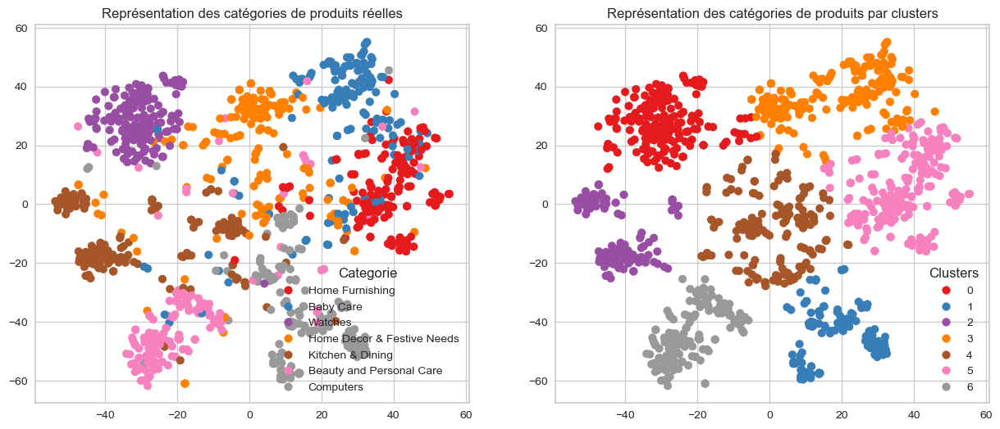

ARI :  0.5191


In [555]:
TSNE_visu_fct(X_tsne, data_efficient['product_category_encode'], labels, ARI)

              precision    recall  f1-score   support

           1       0.69      0.93      0.79       150
           2       0.57      0.65      0.60       150
           3       0.85      0.99      0.91       150
           4       0.21      0.21      0.21       150
           5       0.88      0.61      0.72       150
           6       0.88      0.80      0.84       150
           7       0.93      0.67      0.78       150

    accuracy                           0.69      1050
   macro avg       0.71      0.69      0.69      1050
weighted avg       0.71      0.69      0.69      1050



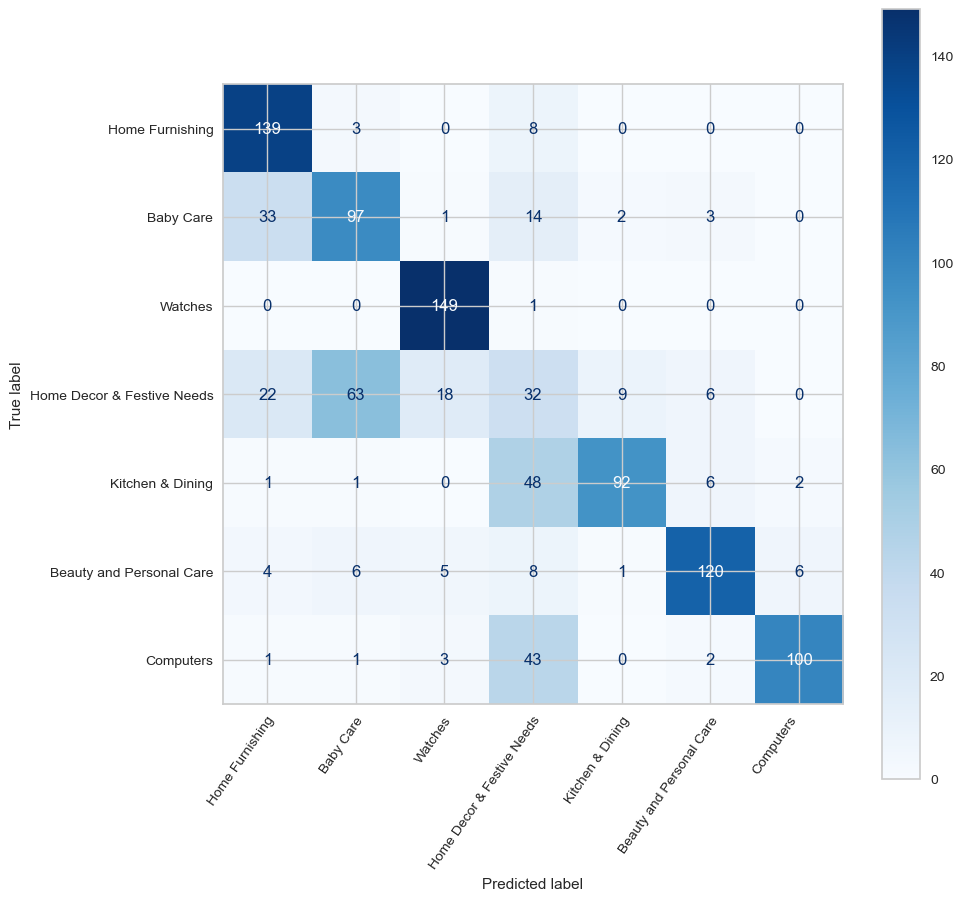

In [588]:
#data_efficient['y_efficientnet_transform'] = clusters_matching(data_efficient['product_category_encode'],
#                                                               labels)

#marche pas car une classe ne marche pas bien :
mapping_eficient_net = {
    0:3,
    1:7,
    2:5,
    3:2,
    4:4,
    5:1,
    6:6
}
data_efficient['y_efficientnet_transform'] = [mapping_eficient_net[i] for i in labels]

print(classification_report(data_efficient['product_category_encode'],
                            data_efficient['y_efficientnet_transform']))

confusion_matrix_plot(data_efficient['product_category_encode'],
                      data_efficient['y_efficientnet_transform'],
                      list(data_text['product_category'].unique()))

# Modele mix

## Sans PCA

In [590]:
data_efficient['features_efficientnet'] = list(features_efficientnet_v2)
data_text['ctf_transform'] = list(ctf_transform)
print(features_efficientnet_v2.shape)

(1050, 1280)


In [591]:
data_mixed = data_efficient[[
    'unique_id', 'features_efficientnet', 'product_category_encode']].join(
    data_text[['ctf_transform', 'uniq_id']])
data_mixed.shape

(1050, 5)

In [592]:
data_mixed['mix'] = data_mixed.apply(
    lambda x : np.hstack((x['features_efficientnet'], x['ctf_transform'])), axis=1)
print(data_mixed['mix'][0].shape)

mix = []
for i,j in data_mixed['mix'].iteritems():
    mix.append(j)

(3878,)


In [593]:
test_ari = [10, 15, 20, 25, 30, 35, 40, 45, 50]
for i in test_ari:
    ARI, X_tsne, labels = ARI_fct(np.array(mix), N_CLUSTERS, data_mixed['product_category_encode'], i)
    print(f'ARI : {ARI} pour peplixity {i}')

ARI :  0.4599 time :  5.0
ARI : 0.4599 pour peplixity 10
ARI :  0.4936 time :  5.0
ARI : 0.4936 pour peplixity 15
ARI :  0.4992 time :  5.0
ARI : 0.4992 pour peplixity 20
ARI :  0.496 time :  5.0
ARI : 0.496 pour peplixity 25
ARI :  0.5083 time :  5.0
ARI : 0.5083 pour peplixity 30
ARI :  0.4712 time :  5.0
ARI : 0.4712 pour peplixity 35
ARI :  0.5334 time :  6.0
ARI : 0.5334 pour peplixity 40
ARI :  0.5308 time :  6.0
ARI : 0.5308 pour peplixity 45
ARI :  0.5085 time :  6.0
ARI : 0.5085 pour peplixity 50


ARI :  0.5334 time :  6.0


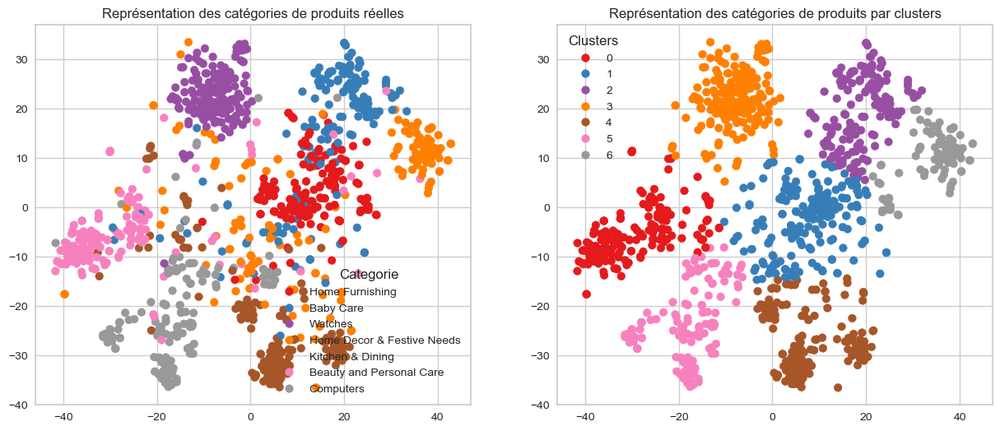

ARI :  0.5334


In [594]:
ARI, X_tsne, labels = ARI_fct(np.array(mix), N_CLUSTERS, data_mixed['product_category_encode'], 40)
TSNE_visu_fct(X_tsne, data_vgg['product_category_encode'], labels, ARI)

In [595]:
data_mixed['y_kmeans_transform'] = clusters_matching(data_mixed['product_category_encode'], labels)

[[  0   0   0   0   0   0   0   0]
 [  0  96  38   0   1   0  15   0]
 [  6  30 107   2   2   1   2   0]
 [  0   0   0 149   0   1   0   0]
 [  7  45   1  12  20   2  63   0]
 [ 22   4   0   4 116   4   0   0]
 [125   8   2   6   1   5   3   0]
 [  5  12   1   3   5 124   0   0]]

[6 1 2 3 5 7 4 0]


In [596]:
print(classification_report(data_mixed['product_category_encode'], data_mixed['y_kmeans_transform']))

              precision    recall  f1-score   support

           1       0.49      0.64      0.56       150
           2       0.72      0.71      0.72       150
           3       0.85      0.99      0.91       150
           4       0.76      0.42      0.54       150
           5       0.80      0.77      0.79       150
           6       0.76      0.83      0.79       150
           7       0.91      0.83      0.86       150

    accuracy                           0.74      1050
   macro avg       0.75      0.74      0.74      1050
weighted avg       0.75      0.74      0.74      1050



## Avec PCA:

In [600]:
data_efficient['features_efficientnet'] = list(features_efficientnet_v2)
data_text['ctf_transform_pca'] = list(X_pca)
print(features_efficientnet_v2.shape)
print(X_pca.shape)

(1050, 1280)
(1050, 700)


In [603]:
data_mixed = data_efficient[[
    'unique_id', 'features_efficientnet', 'product_category_encode']].join(
    data_text[['ctf_transform_pca', 'uniq_id']])
#data_mixed.shape

In [605]:
data_mixed['mix_pca'] = data_mixed.apply(
    lambda x : np.hstack((x['features_efficientnet'], x['ctf_transform_pca'])), axis=1)
print(data_mixed['mix_pca'][0].shape)

mix_pca = []
for i,j in data_mixed['mix_pca'].iteritems():
    mix_pca.append(j)

(1980,)


In [606]:
test_ari = [10, 15, 20, 25, 30, 35, 40, 45, 50]
for i in test_ari:
    ARI, X_tsne, labels = ARI_fct(np.array(mix_pca), N_CLUSTERS, data_mixed['product_category_encode'], i)
    print(f'ARI : {ARI} pour peplixity {i}')

ARI :  0.4357 time :  5.0
ARI : 0.4357 pour peplixity 10
ARI :  0.5291 time :  5.0
ARI : 0.5291 pour peplixity 15
ARI :  0.493 time :  5.0
ARI : 0.493 pour peplixity 20
ARI :  0.4889 time :  5.0
ARI : 0.4889 pour peplixity 25
ARI :  0.5101 time :  5.0
ARI : 0.5101 pour peplixity 30
ARI :  0.5048 time :  5.0
ARI : 0.5048 pour peplixity 35
ARI :  0.4888 time :  6.0
ARI : 0.4888 pour peplixity 40
ARI :  0.4932 time :  6.0
ARI : 0.4932 pour peplixity 45
ARI :  0.5029 time :  6.0
ARI : 0.5029 pour peplixity 50


ARI :  0.5291 time :  5.0


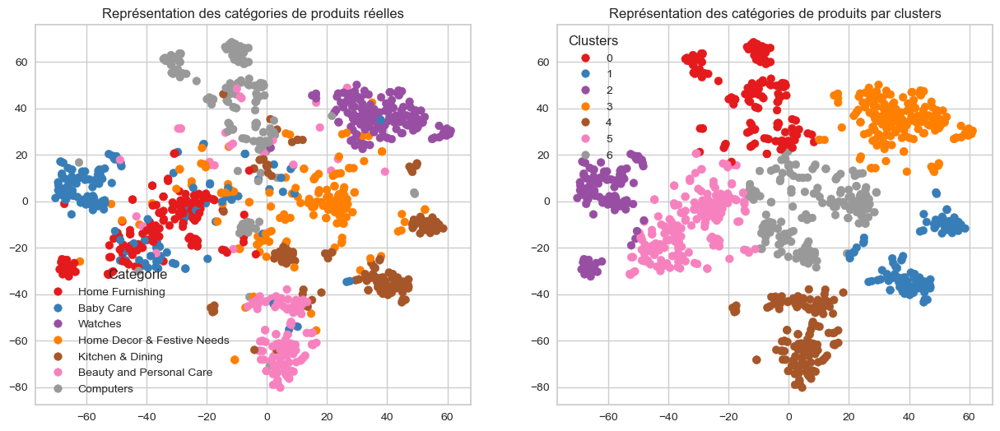

ARI :  0.5291


In [610]:
ARI, X_tsne, labels = ARI_fct(np.array(mix_pca), N_CLUSTERS, data_mixed['product_category_encode'], 15)
TSNE_visu_fct(X_tsne, data_mixed['product_category_encode'], labels, ARI)

In [611]:
data_mixed['y_kmeans_transform'] = clusters_matching(data_mixed['product_category_encode'], labels)
print(classification_report(data_mixed['product_category_encode'], data_mixed['y_kmeans_transform']))

[[  0   0   0   0   0   0   0   0]
 [  0   0  22   0   0 123   5   0]
 [  5   2  82   1   3  42  15   0]
 [  1   0   0 149   0   0   0   0]
 [  4  13   3  12   6  14  98   0]
 [  4  89   0  10  13   1  33   0]
 [ 11   0   1   5 121   8   4   0]
 [123   2   1   1   2   1  20   0]]

[7 5 2 3 6 1 4 0]
              precision    recall  f1-score   support

           1       0.65      0.82      0.73       150
           2       0.75      0.55      0.63       150
           3       0.84      0.99      0.91       150
           4       0.56      0.65      0.60       150
           5       0.84      0.59      0.70       150
           6       0.83      0.81      0.82       150
           7       0.83      0.82      0.83       150

    accuracy                           0.75      1050
   macro avg       0.76      0.75      0.74      1050
weighted avg       0.76      0.75      0.74      1050

